In [1]:
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.decomposition import PCA
from numpy.random import standard_normal
from scipy.linalg import cholesky
from scipy import interpolate
import matplotlib.pyplot as plt
import matplotlib.tri as mtri
from matplotlib import pyplot
from tensorflow import keras
import tensorflow as tf
import numpy as np

In [2]:
def covariance_structure(sigDel, matElem, phidel):
    return sigDel*np.exp(-1*matElem/phidel)

In [3]:
size = 200

In [7]:
np.random.seed(234)
x             = np.random.uniform(size=size, low=0, high=25)
np.random.seed(235)
y             = np.random.uniform(size=size, low=0, high=25)
sample_points = np.concatenate([x.reshape(-1,1), y.reshape(-1,1)], axis=1)
mat           = euclidean_distances(sample_points)
matCov        = covariance_structure(1.5, mat, 10)
means         = np.zeros(mat.shape[0])

In [8]:
np.random.seed(23)
sim_data      = np.random.multivariate_normal(np.zeros(mat.shape[0]), matCov, 1000)
emp_cov       = np.corrcoef(sim_data.T)

In [50]:
sim_data.shape

(1000, 200)

In [10]:
# https://fanwangecon.github.io/M4Econ/panel/timeseries/fs_autoregressive.html

def ar1(it_T = 1000, fl_constant = 0.02, fl_normal_sd = 0.02, 
        fl_persistence = 0.95, fl_shk_bnds = 3, bl_init = True):
    
    fl_init = fl_constant/(1-fl_persistence)
    
    # Generate a normal shock vector
    it_draws = it_T
    np.random.seed(789)
    ar_fl_shocks = np.random.normal(loc=0, scale=fl_normal_sd, size=it_draws)
    
    # out of bounds indicators
    fl_shk_bds_lower = 0 - fl_normal_sd*fl_shk_bnds
    fl_shk_bds_upper = 0 + fl_normal_sd*fl_shk_bnds
    ar_bl_outofbounds = (ar_fl_shocks <= fl_shk_bds_lower) | (ar_fl_shocks >= fl_shk_bds_upper)
    
    ar_fl_shocks[ar_fl_shocks <= fl_shk_bds_lower] = fl_shk_bds_lower
    ar_fl_shocks[ar_fl_shocks >= fl_shk_bds_upper] = fl_shk_bds_upper
    
    # Initialize output array
    ar_fl_time_series = np.zeros(len(ar_fl_shocks))
    
    for i in range(len(ar_fl_shocks)):
        if i ==0:
            # initialize using the ean of the process
            ar_fl_time_series[i] = fl_constant/(1-fl_persistence)
            if bl_init: ar_fl_time_series[i] = fl_init
        else:
            fl_ts_t = fl_constant + ar_fl_time_series[i-1]*fl_persistence + ar_fl_shocks[i]
            ar_fl_time_series[i] = fl_ts_t
            
    return ar_fl_time_series

In [12]:
ar_fl_time_series = ar1(it_T=100)
ar_fl_time_series

array([0.4       , 0.38548563, 0.39666743, 0.4215229 , 0.42238467,
       0.401507  , 0.4027763 , 0.39078565, 0.37261095, 0.39508765,
       0.41143672, 0.43757858, 0.42719709, 0.41946652, 0.40120579,
       0.36608018, 0.37305351, 0.35344226, 0.3811044 , 0.34784785,
       0.36047911, 0.37075465, 0.3899636 , 0.39048604, 0.41466159,
       0.4134761 , 0.40247544, 0.41398075, 0.40663194, 0.40072125,
       0.41302431, 0.42616554, 0.43840237, 0.42152492, 0.43284769,
       0.43942757, 0.47890643, 0.46227741, 0.47757399, 0.43948277,
       0.44999069, 0.41262477, 0.42625493, 0.41175697, 0.36877706,
       0.39310976, 0.39192809, 0.42856195, 0.4569953 , 0.4607293 ,
       0.46064294, 0.4874114 , 0.49614393, 0.47061208, 0.47123975,
       0.48458405, 0.47896779, 0.46916674, 0.48617394, 0.48297668,
       0.47803597, 0.44721763, 0.44552876, 0.4528136 , 0.46600457,
       0.45173961, 0.44530637, 0.42479007, 0.3890341 , 0.41253058,
       0.4136956 , 0.41469031, 0.4176274 , 0.43019288, 0.37041

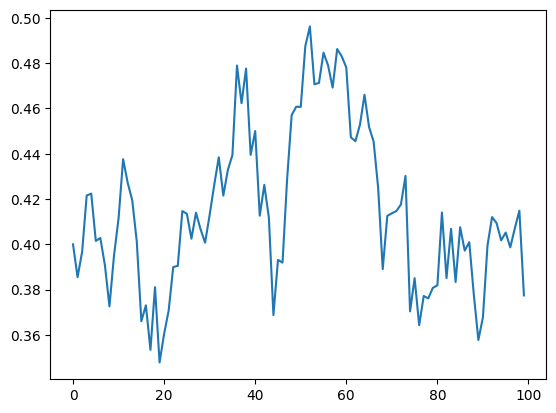

In [13]:
plt.plot(ar_fl_time_series)
plt.show()

In [14]:
sim_data_ex = np.expand_dims(sim_data, 1)

In [18]:
sim_data_ex

array([[[ 0.4867627 ,  1.04937   , -0.79381962, ..., -0.79408905,
         -1.2780682 ,  0.5627125 ]],

       [[-0.20261715, -1.05683451,  1.75380411, ..., -0.67566186,
          0.10072223,  0.24938441]],

       [[-0.1887164 ,  0.11666843, -2.75026148, ...,  0.35700074,
          0.7372076 ,  1.05060403]],

       ...,

       [[ 0.12944065, -0.99519007,  0.07175055, ..., -0.53128275,
         -0.65446221, -2.5934821 ]],

       [[ 0.88372637, -1.15980318, -3.74582306, ..., -0.3956326 ,
         -0.56975143, -0.28791236]],

       [[ 0.50728209, -0.86674655, -0.79356299, ..., -1.31957746,
         -1.65632327, -0.76550053]]])

In [19]:
st_data_true  = []
st_data_noise = []

for s in ar_fl_time_series:
    st_data_true.append(sim_data_ex*s)
    st_data_noise.append(sim_data_ex*s + np.random.normal(size=sim_data_ex.shape, loc=0, scale=np.std(sim_data)/50))
    
st_data_true  = np.squeeze(np.stack(st_data_true, 2))
st_data_noise = np.squeeze(np.stack(st_data_noise, 2))

In [20]:
st_data_true.shape

(1000, 100, 200)

In [21]:
sim_real = st_data_noise[0]
sim_real.shape

(100, 200)

In [22]:
# 1. Spatially Centered

sim_centered = sim_real - sim_real.mean(1).reshape(-1, 1)
sim_centered.shape

(100, 200)

In [26]:
# 2. EOF

comp = 50
pca = PCA(comp)
pca.fit(sim_centered)
principalComponents = pca.transform(sim_centered)

In [27]:
print(principalComponents.shape) # time (rows) x comp (cols)
print(pca.components_.shape)     # comp (rows) x location (cols)

(100, 50)
(50, 200)


In [33]:
principalComponents[:,0:5].dot(pca.components_[:5,:])+\
pca.mean_.reshape(-1, pca.components_.shape[1])

array([[ 0.35116923,  0.59145101, -0.14061659, ..., -0.14859678,
        -0.34107026,  0.39188573],
       [ 0.34094294,  0.57911421, -0.13485827, ..., -0.14213234,
        -0.32730481,  0.3837781 ],
       [ 0.35555322,  0.5693958 , -0.14888575, ..., -0.1592488 ,
        -0.33781332,  0.38932119],
       ...,
       [ 0.36055165,  0.58761785, -0.14759954, ..., -0.15062882,
        -0.34427491,  0.39799613],
       [ 0.37578271,  0.60708561, -0.15477916, ..., -0.15613785,
        -0.35885583,  0.41034391],
       [ 0.3532627 ,  0.54732118, -0.14881081, ..., -0.14908619,
        -0.31666599,  0.38073327]])

In [34]:
sim_centered

array([[ 0.36196818,  0.59982007, -0.11514244, ..., -0.14767362,
        -0.33595195,  0.41793617],
       [ 0.34535963,  0.56521099, -0.12970516, ..., -0.13453762,
        -0.33295103,  0.36186058],
       [ 0.39087614,  0.5426847 , -0.18954283, ..., -0.19799105,
        -0.30087858,  0.3699191 ],
       ...,
       [ 0.42093598,  0.55210459, -0.13952792, ..., -0.11884715,
        -0.33807173,  0.39104283],
       [ 0.37442202,  0.60063361, -0.17639071, ..., -0.14720117,
        -0.38620211,  0.3836596 ],
       [ 0.34236346,  0.55225753, -0.15480313, ..., -0.15225849,
        -0.29946402,  0.37882912]])

In [35]:
len(sample_points)

200

In [36]:
# TODO: Need to learn on the full reconstruction

In [37]:
inputs   = keras.layers.Input(2)
layers   = keras.layers.Dense(100, activation='elu')(inputs)
layers   = keras.layers.BatchNormalization()(layers)
layers   = keras.layers.Dense(100, activation='elu')(layers)
layers   = keras.layers.BatchNormalization()(layers)
layers   = keras.layers.Dense(100, activation='elu')(layers)
layers   = keras.layers.BatchNormalization()(layers)
layers   = keras.layers.Dense(100, activation='elu')(layers)
layers   = keras.layers.BatchNormalization()(layers)
layers   = keras.layers.Dense(100, activation='elu')(layers)
layers   = keras.layers.BatchNormalization()(layers)
layers   = keras.layers.Dense(100, activation='elu')(layers)
outputs  = keras.layers.Dense(comp)(layers)

In [38]:
model = keras.models.Model(inputs=inputs, outputs=outputs)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 2)]               0         
                                                                 
 dense (Dense)               (None, 100)               300       
                                                                 
 batch_normalization (Batch  (None, 100)               400       
 Normalization)                                                  
                                                                 
 dense_1 (Dense)             (None, 100)               10100     
                                                                 
 batch_normalization_1 (Bat  (None, 100)               400       
 chNormalization)                                                
                                                                 
 dense_2 (Dense)             (None, 100)               10100 

In [39]:
train_dataset = tf.data.Dataset.from_tensor_slices((sample_points, pca.components_.T.astype(np.float32),
                                                   # principalComponents.astype(np.float32),
                                                   pca.mean_.astype(np.float32).reshape(-1,1)))

train_dataset = train_dataset.shuffle(30).batch(50)
principalComponentsTensor = tf.convert_to_tensor(principalComponents.astype(np.float32))

In [40]:
opt = tf.keras.optimizers.legacy.Adam(1e-3)

In [41]:
for epoch in range(200):
    for step, x in enumerate(train_dataset):
        with tf.GradientTape(persistent=True) as tape:
            output = model(x[0])
            
            true_field = tf.tensordot(principalComponentsTensor, tf.transpose(x[1]), 1) +\
                         tf.reshape(x[2], [-1, tf.shape(x[2])[0]])
            
            recon_field = tf.tensordot(principalComponentsTensor, tf.transpose(output), 1) +\
                         tf.reshape(x[2], [-1, tf.shape(x[2])[0]]) 
            
            loss = tf.reduce_sum(tf.square(true_field-recon_field))
            
        grads = tape.gradient(loss, model.trainable_weights)
        trainables = model.trainable_weights
        
        opt.apply_gradients(zip(grads, trainables))
        
        print('loss: ', loss.numpy(), 'epoch: ', epoch)

loss:  1984.0083 epoch:  0
loss:  348.30286 epoch:  0
loss:  880.96545 epoch:  0
loss:  467.9206 epoch:  0
loss:  159.35265 epoch:  1
loss:  171.5748 epoch:  1
loss:  242.7396 epoch:  1
loss:  185.70828 epoch:  1
loss:  117.39959 epoch:  2
loss:  71.34381 epoch:  2
loss:  102.52962 epoch:  2
loss:  113.33157 epoch:  2
loss:  110.00826 epoch:  3
loss:  78.959694 epoch:  3
loss:  43.653893 epoch:  3
loss:  42.74858 epoch:  3
loss:  50.649464 epoch:  4
loss:  61.725956 epoch:  4
loss:  61.20215 epoch:  4
loss:  44.194088 epoch:  4
loss:  26.15577 epoch:  5
loss:  25.812706 epoch:  5
loss:  28.963373 epoch:  5
loss:  30.231457 epoch:  5
loss:  35.515068 epoch:  6
loss:  29.919434 epoch:  6
loss:  21.143188 epoch:  6
loss:  16.347857 epoch:  6
loss:  19.660015 epoch:  7
loss:  17.428215 epoch:  7
loss:  22.280506 epoch:  7
loss:  23.95034 epoch:  7
loss:  16.833199 epoch:  8
loss:  14.670552 epoch:  8
loss:  11.40827 epoch:  8
loss:  13.160138 epoch:  8
loss:  16.064495 epoch:  9
loss:  17.

loss:  4.416132 epoch:  81
loss:  3.9930205 epoch:  81
loss:  4.415412 epoch:  82
loss:  4.8985233 epoch:  82
loss:  3.8620791 epoch:  82
loss:  4.128127 epoch:  82
loss:  4.7483206 epoch:  83
loss:  3.8644047 epoch:  83
loss:  4.494987 epoch:  83
loss:  4.0512934 epoch:  83
loss:  4.436412 epoch:  84
loss:  3.9081597 epoch:  84
loss:  4.9012494 epoch:  84
loss:  3.8818684 epoch:  84
loss:  4.115075 epoch:  85
loss:  4.527176 epoch:  85
loss:  4.315882 epoch:  85
loss:  4.260577 epoch:  85
loss:  4.426123 epoch:  86
loss:  4.2551236 epoch:  86
loss:  4.137346 epoch:  86
loss:  4.586819 epoch:  86
loss:  4.624791 epoch:  87
loss:  4.278326 epoch:  87
loss:  4.395339 epoch:  87
loss:  4.271212 epoch:  87
loss:  4.5964518 epoch:  88
loss:  4.308563 epoch:  88
loss:  4.3993244 epoch:  88
loss:  3.8481436 epoch:  88
loss:  4.292848 epoch:  89
loss:  4.7213507 epoch:  89
loss:  3.6959958 epoch:  89
loss:  4.2615743 epoch:  89
loss:  4.26613 epoch:  90
loss:  4.2906427 epoch:  90
loss:  4.677

loss:  4.123479 epoch:  158
loss:  3.7964163 epoch:  158
loss:  3.7968118 epoch:  159
loss:  4.278145 epoch:  159
loss:  3.6596603 epoch:  159
loss:  3.8118074 epoch:  159
loss:  4.244112 epoch:  160
loss:  3.7665687 epoch:  160
loss:  4.265219 epoch:  160
loss:  3.885409 epoch:  160
loss:  4.3234234 epoch:  161
loss:  3.8202841 epoch:  161
loss:  4.3670907 epoch:  161
loss:  3.494563 epoch:  161
loss:  4.1133437 epoch:  162
loss:  3.7304595 epoch:  162
loss:  3.941728 epoch:  162
loss:  3.653973 epoch:  162
loss:  3.8739562 epoch:  163
loss:  3.6238804 epoch:  163
loss:  4.621861 epoch:  163
loss:  3.967087 epoch:  163
loss:  4.259007 epoch:  164
loss:  4.0423207 epoch:  164
loss:  4.1428666 epoch:  164
loss:  3.7368753 epoch:  164
loss:  4.1248674 epoch:  165
loss:  4.29611 epoch:  165
loss:  3.5267575 epoch:  165
loss:  3.784042 epoch:  165
loss:  4.1035376 epoch:  166
loss:  3.974101 epoch:  166
loss:  3.6646688 epoch:  166
loss:  3.855983 epoch:  166
loss:  3.786784 epoch:  167
lo

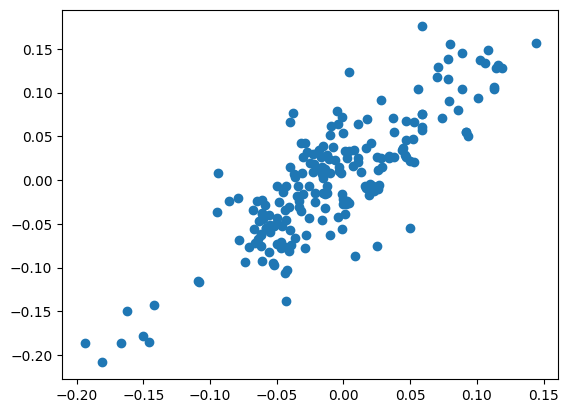

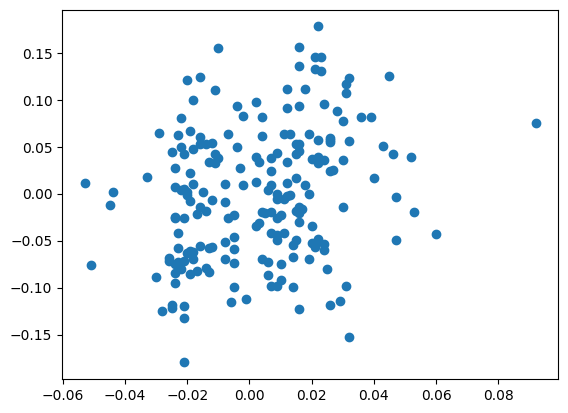

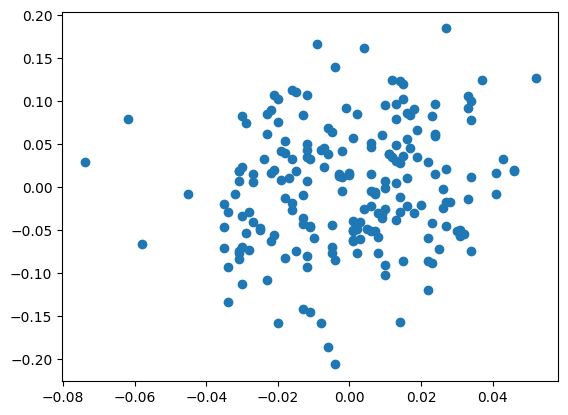

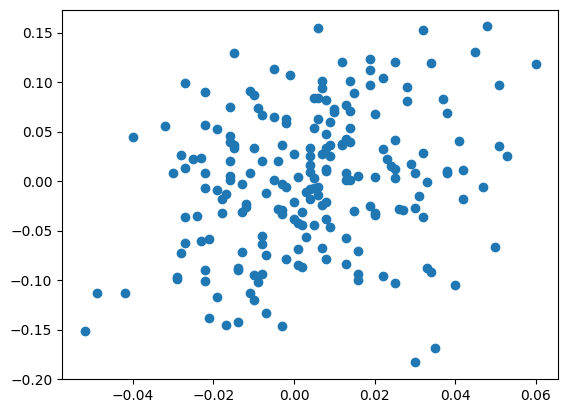

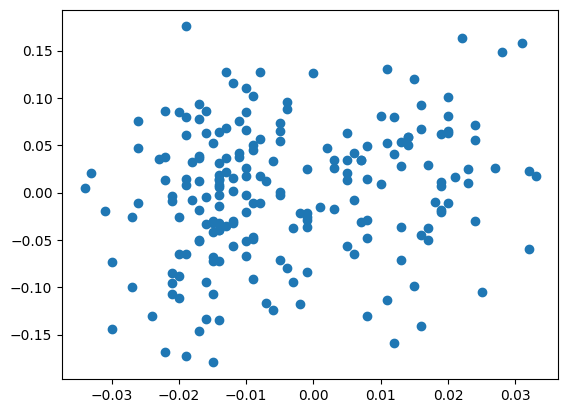

...

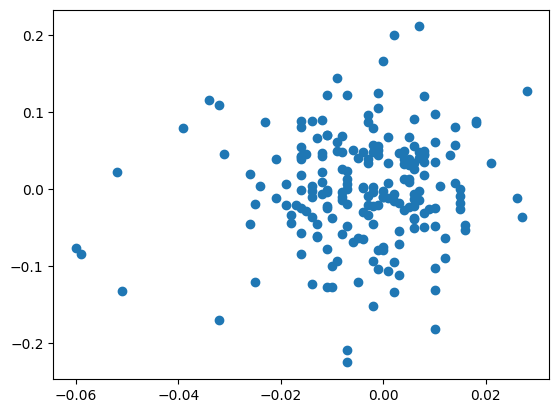

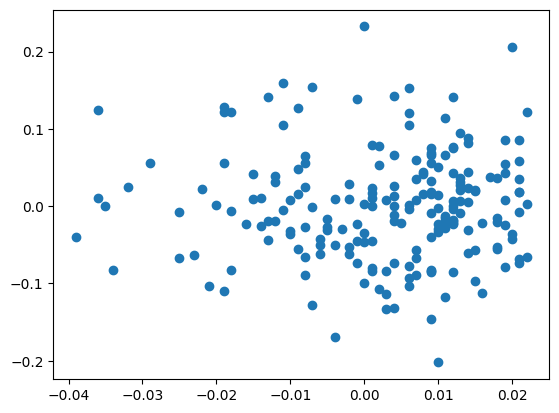

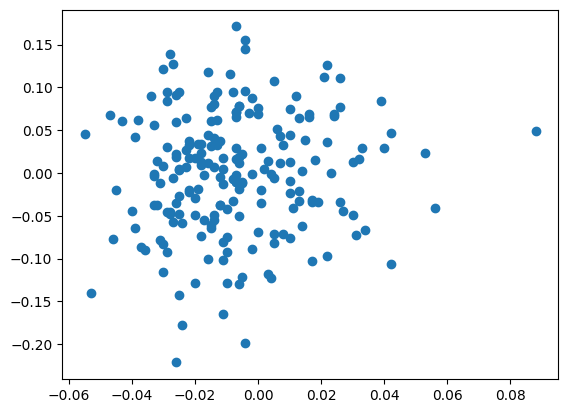

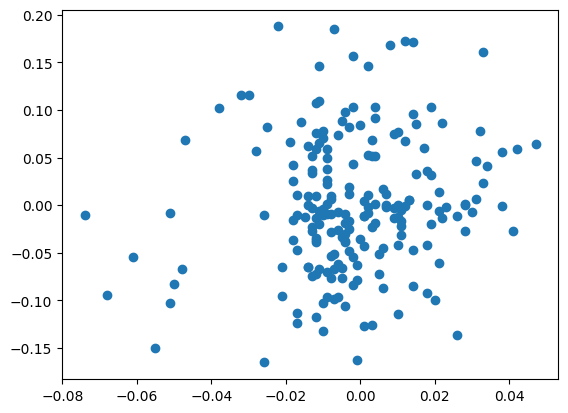

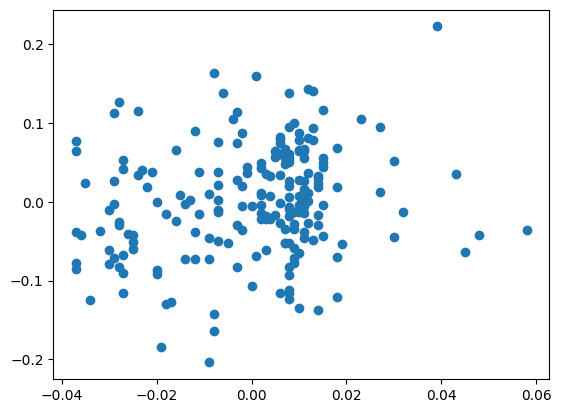

In [42]:
for i in range(comp):
    plt.scatter(np.round(model(sample_points).numpy(),3)[:,i], pca.components_.T[:,i])
    plt.show()

In [43]:
true = principalComponents.dot(pca.components_)+\
pca.mean_.reshape(-1,pca.components_.shape[1])

In [44]:
recon = principalComponents.dot(model(sample_points).numpy().T)+\
pca.mean_.reshape(-1,pca.components_.shape[1])

In [45]:
((true-recon)**2).mean()

0.0007563753387428129

i 0 [ 0.77418359 23.26470258]


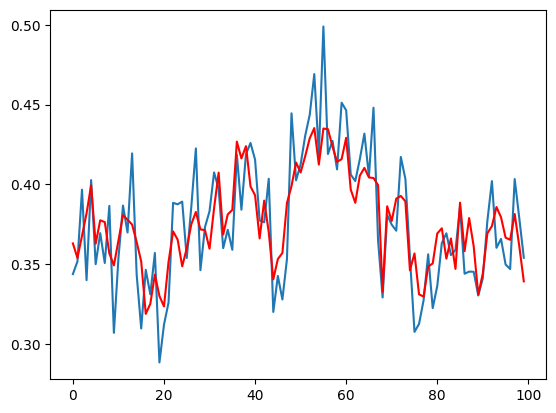

i 1 [ 6.35705183 13.06767616]


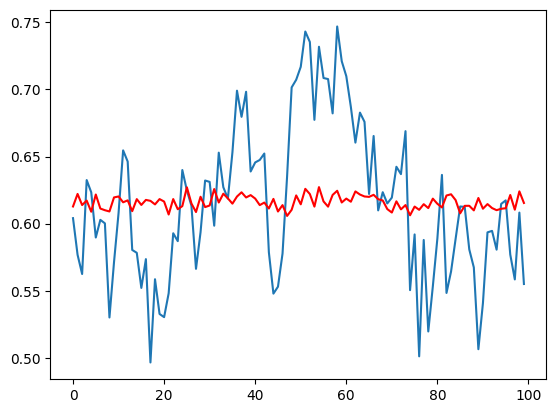

i 2 [22.81001109  1.94215935]


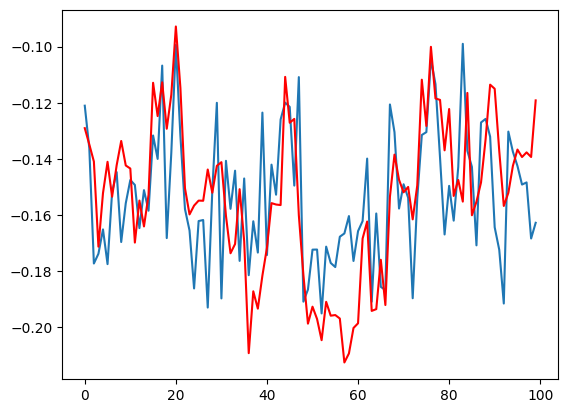

i 3 [24.25435495 23.1926843 ]


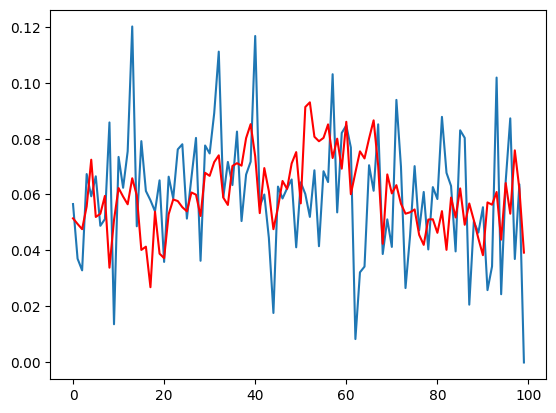

i 4 [6.1654944  9.35271592]


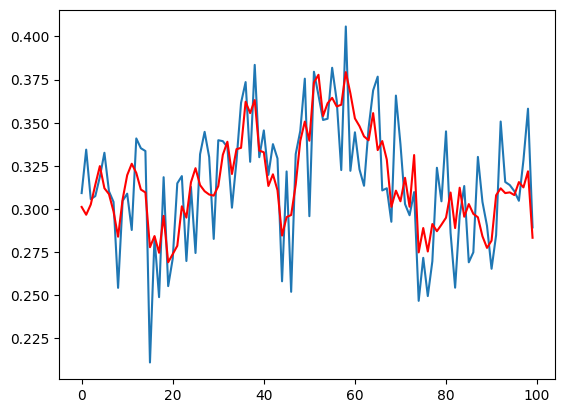

i 5 [17.47018536 15.63448514]


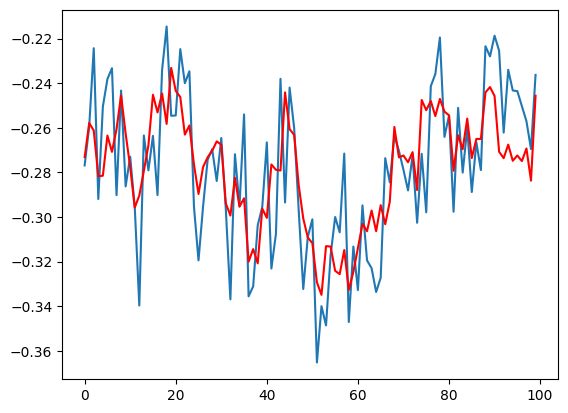

i 6 [21.66073298 20.95652328]


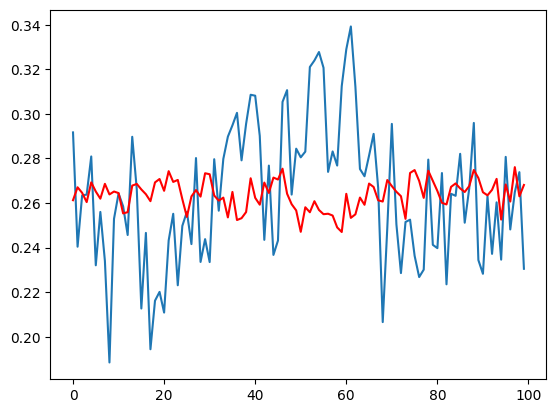

i 7 [15.98804618  2.19810769]


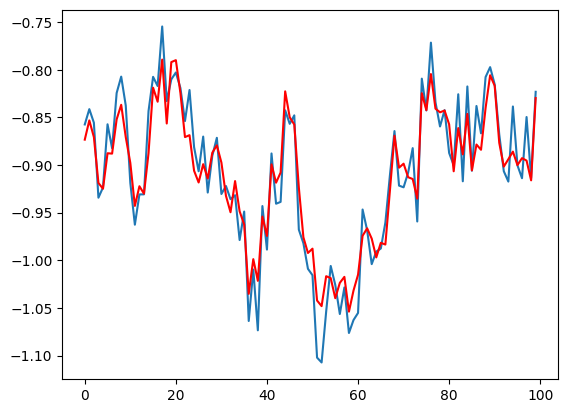

i 8 [11.42109121  2.27337945]


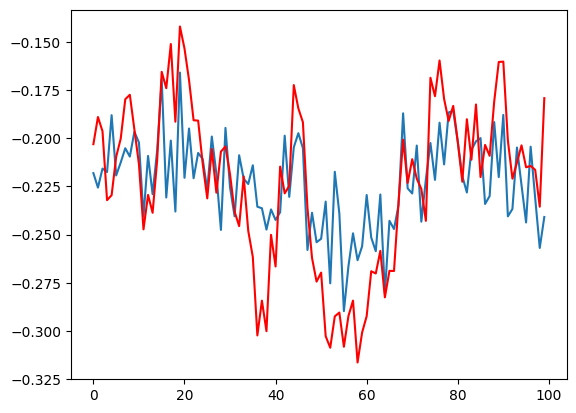

i 9 [12.4698688  23.83651113]


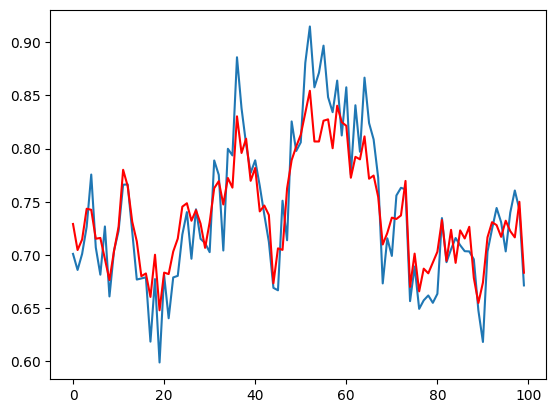

i 10 [18.01187517  1.4612357 ]


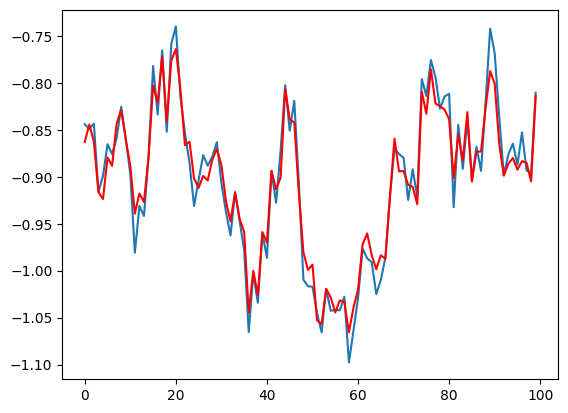

i 11 [6.78132974 8.02490678]


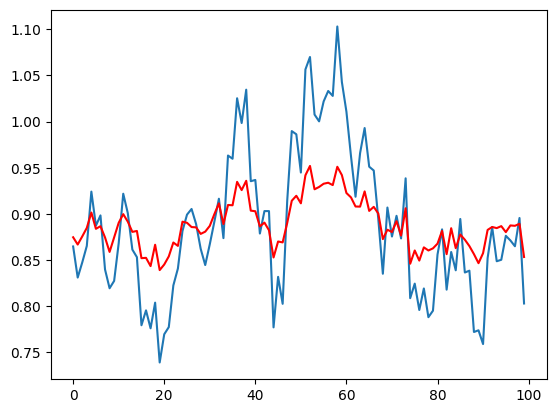

i 12 [20.01547579 12.40613966]


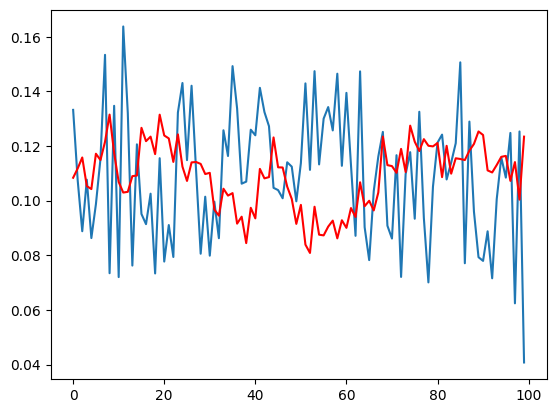

i 13 [12.73131688  7.5989085 ]


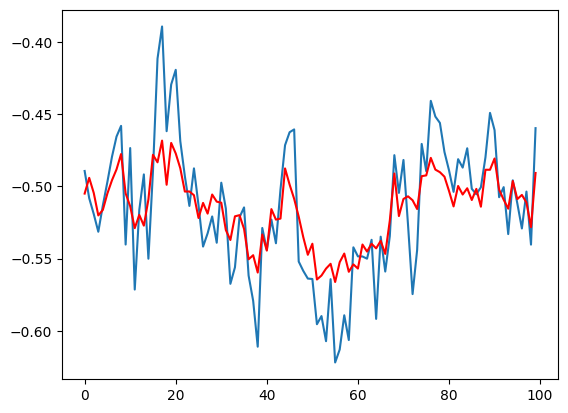

i 14 [20.49802552 23.30106468]


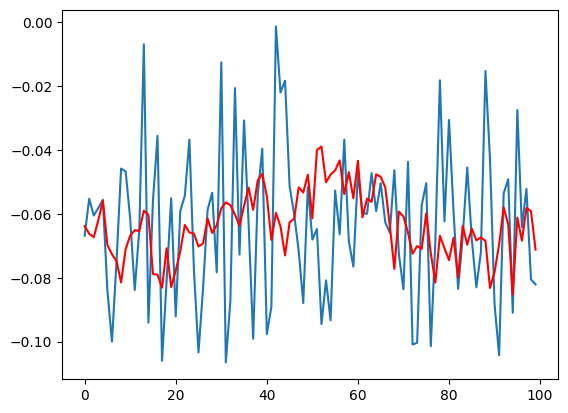

i 15 [ 7.69283093 17.6860407 ]


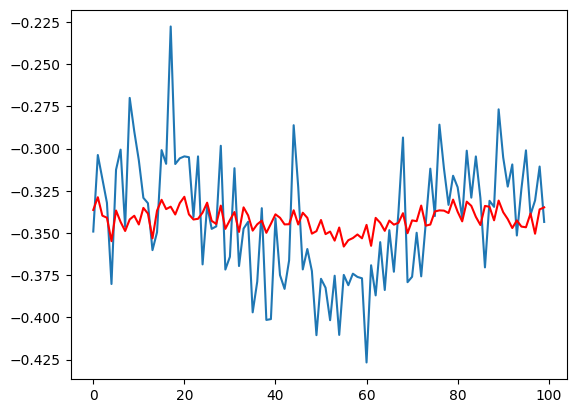

i 16 [16.48195553  2.45941881]


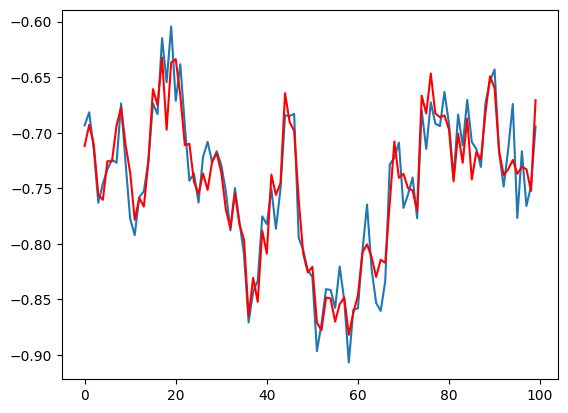

i 17 [ 7.83772227 16.16649541]


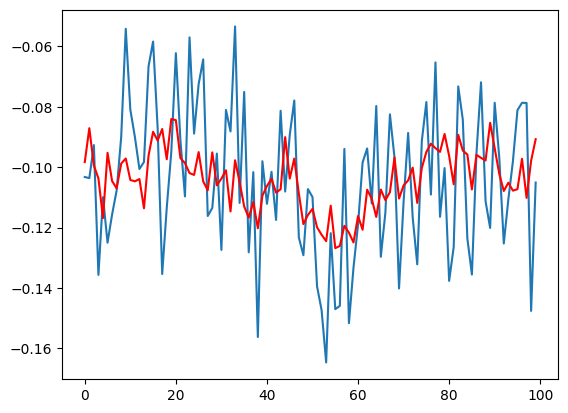

i 18 [13.61629774  8.39159072]


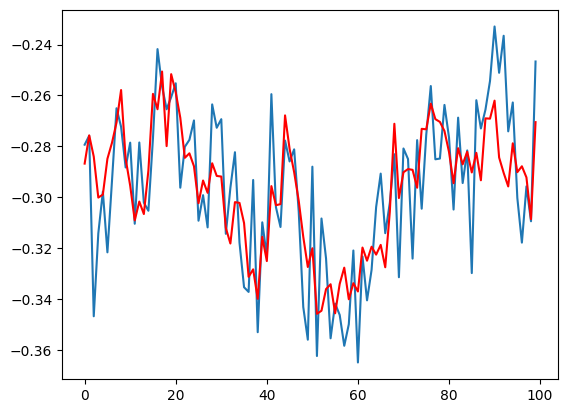

i 19 [7.99603655 9.8559775 ]


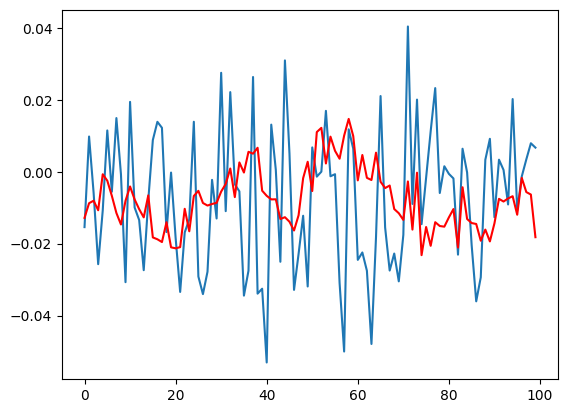

i 20 [11.47881968  9.75654287]


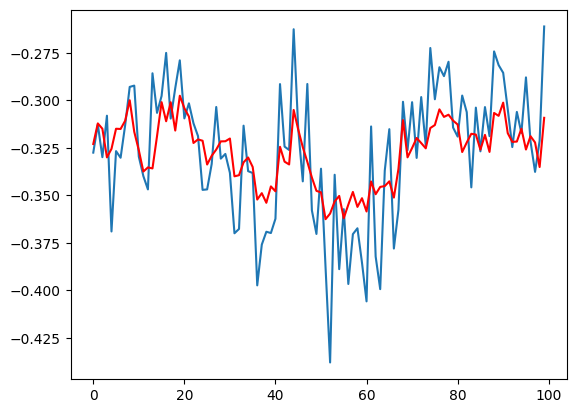

i 21 [20.32729038  5.13481522]


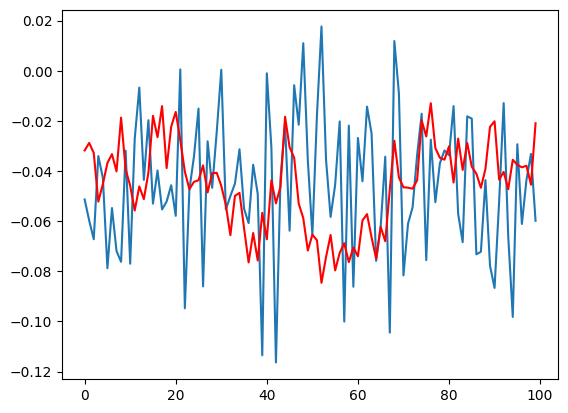

i 22 [23.93879154 16.20036948]


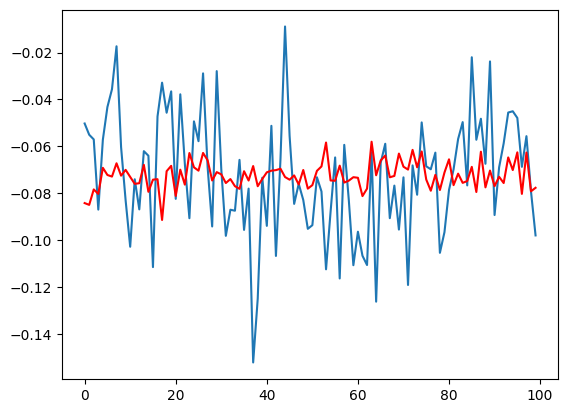

i 23 [0.09983758 8.07678346]


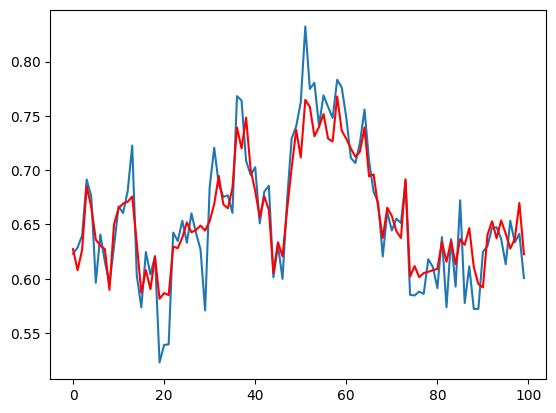

i 24 [24.59846599 10.0508496 ]


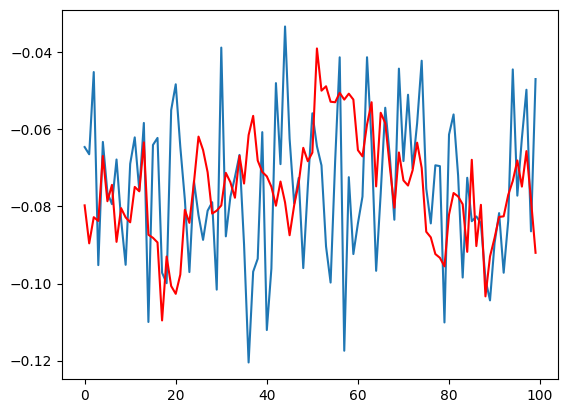

i 25 [24.7404927  10.66222732]


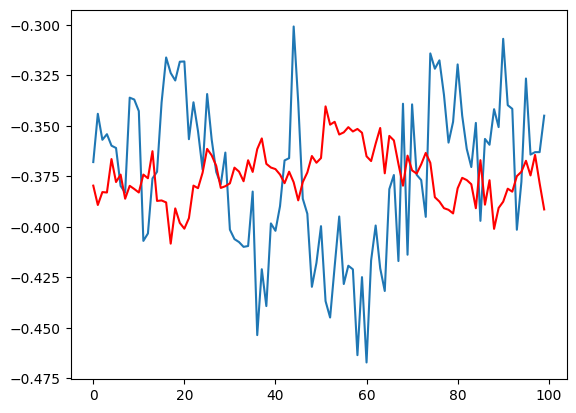

i 26 [2.30021463 2.66128013]


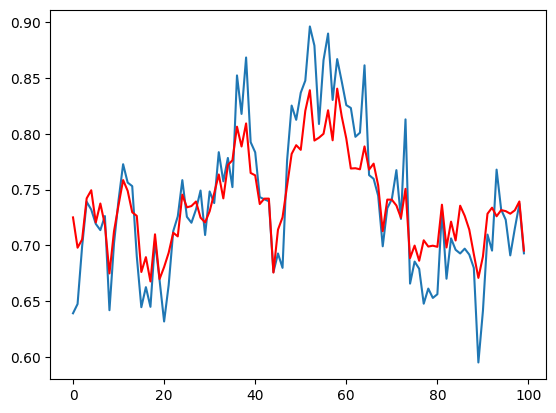

i 27 [11.5505235  12.39750248]


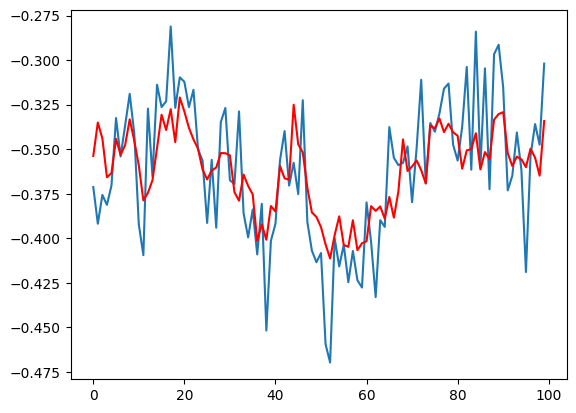

i 28 [21.93865947 15.33007203]


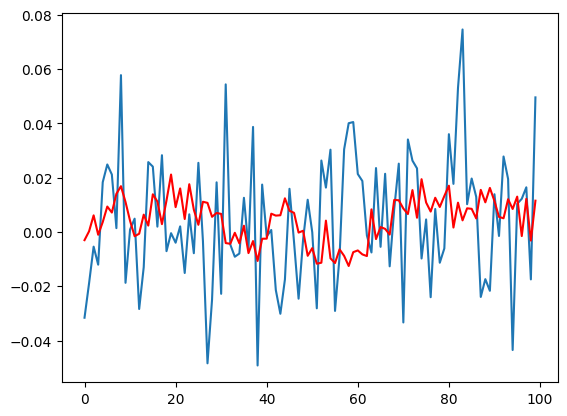

i 29 [ 9.37482376 10.89256415]


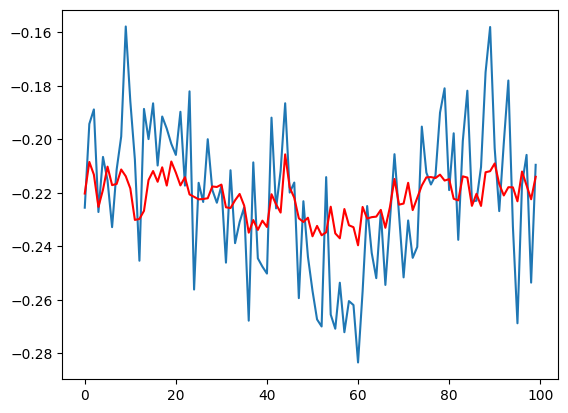

i 30 [5.96720096 0.02356662]


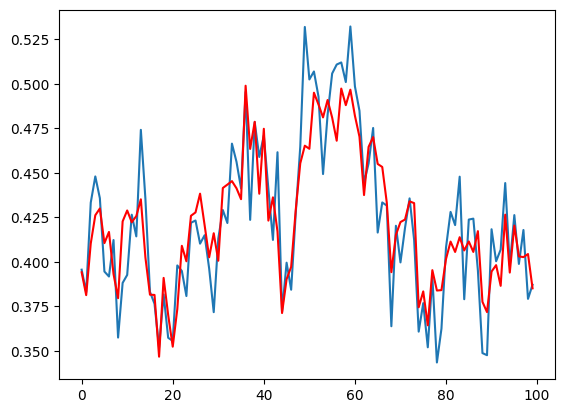

i 31 [9.31363335 6.25396767]


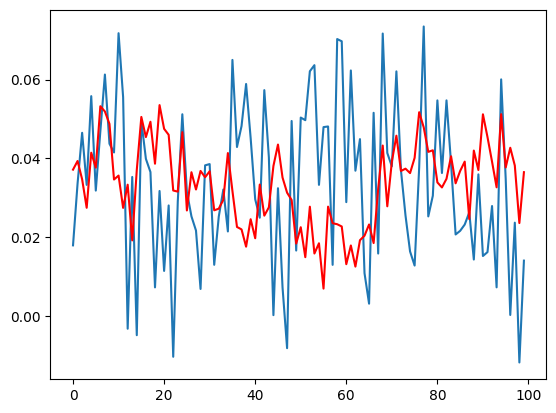

i 32 [13.56130108 14.92240168]


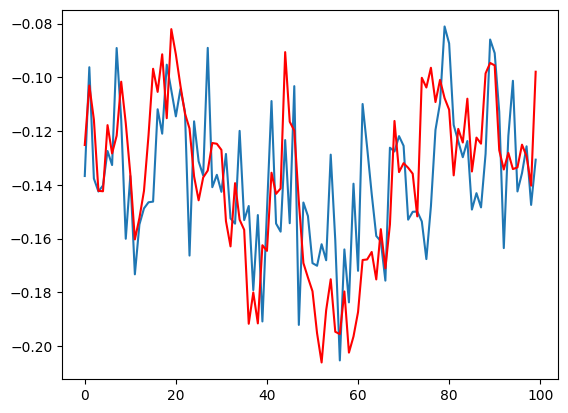

i 33 [18.45240104 13.59248782]


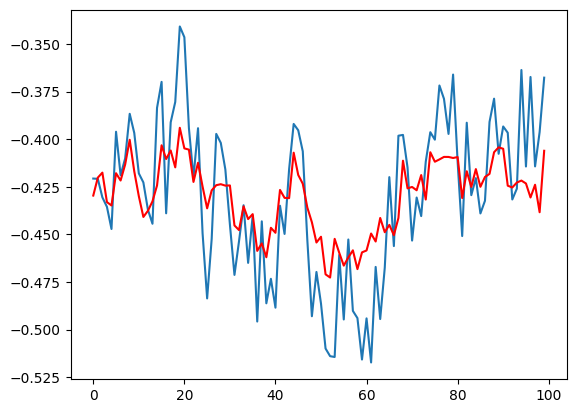

i 34 [21.9379583   7.51108299]


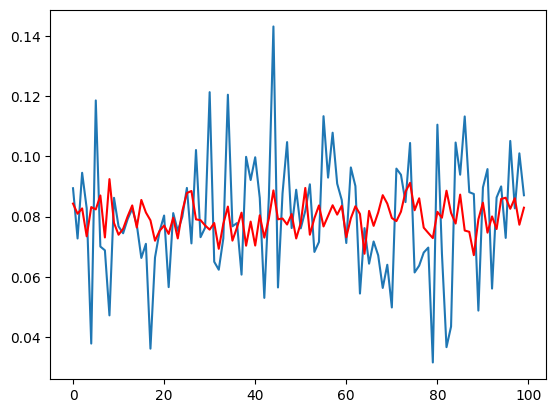

i 35 [13.48956644 24.33675397]


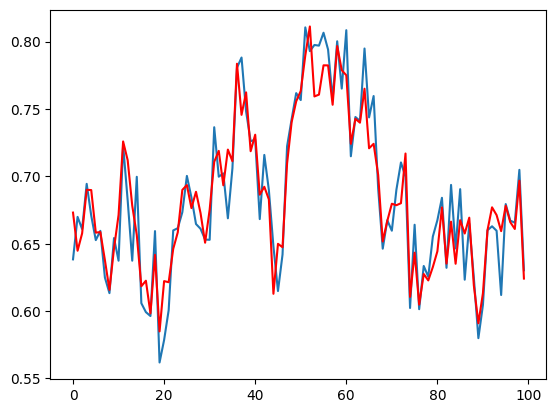

i 36 [1.97658927 2.20532805]


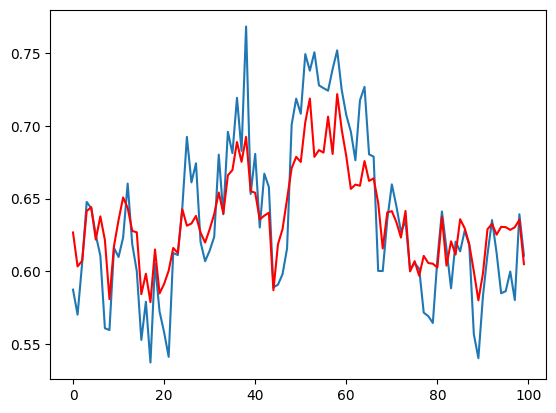

i 37 [18.73863121 19.81001015]


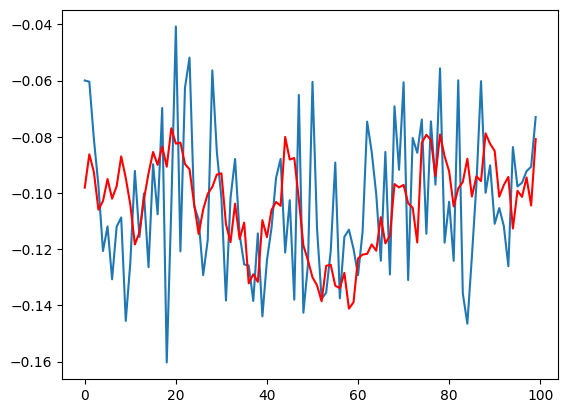

i 38 [17.52429735  5.96359118]


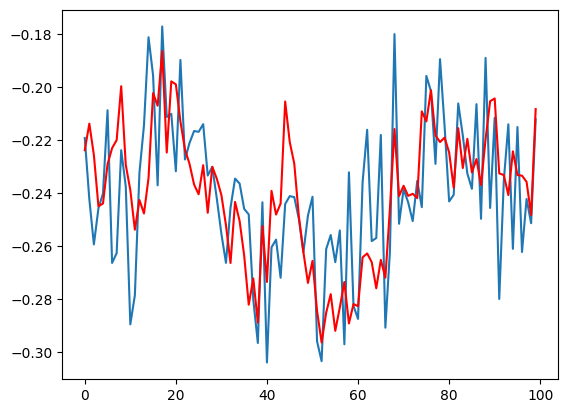

i 39 [20.91436611  1.82844209]


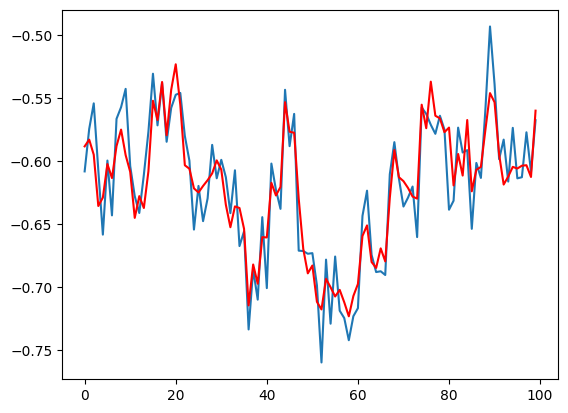

i 40 [16.56597004  6.25843932]


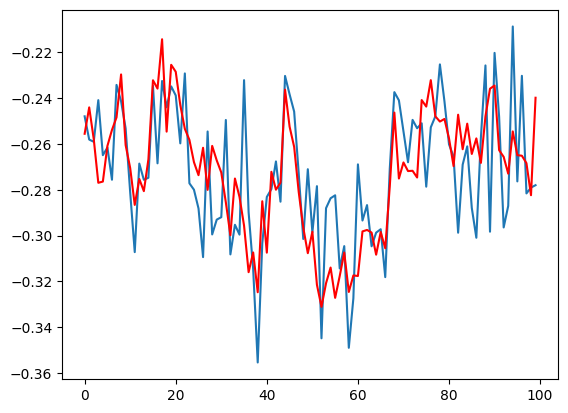

i 41 [23.75512816 23.06191274]


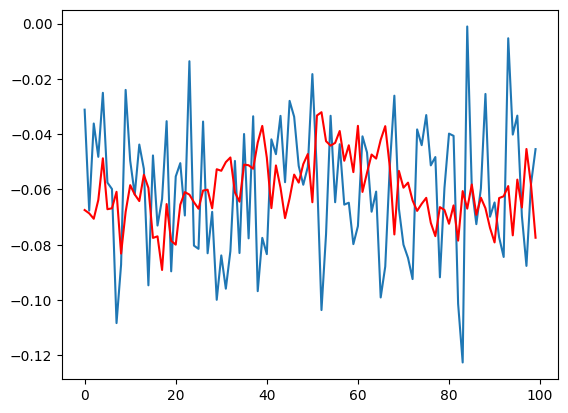

i 42 [18.09215319 21.47912987]


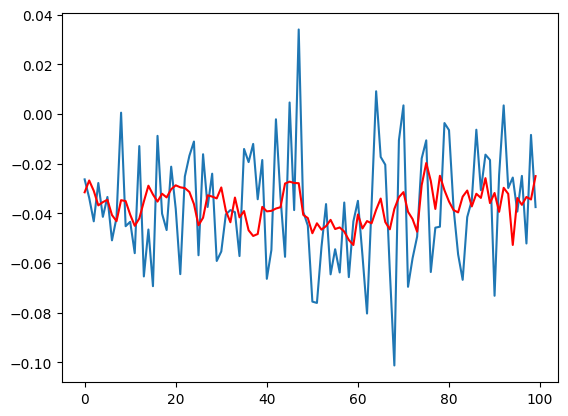

i 43 [0.2884634  3.57989968]


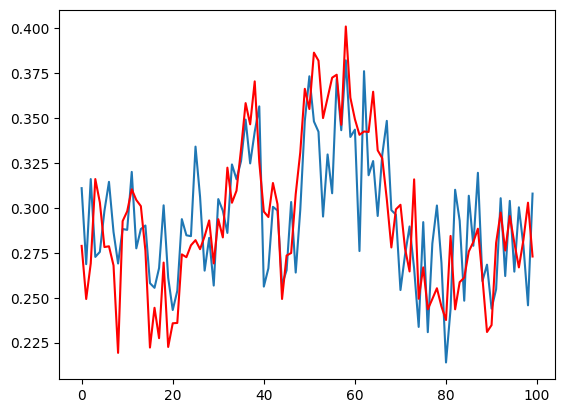

i 44 [16.47478664  5.13913525]


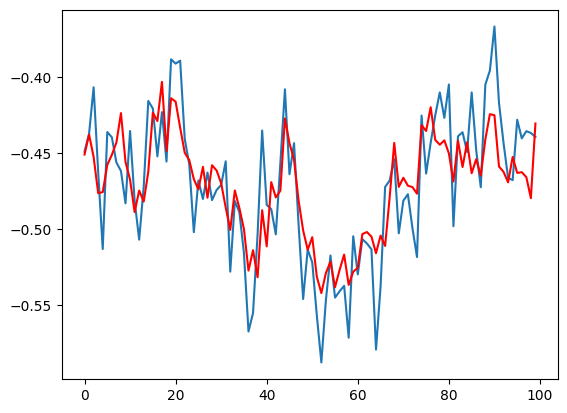

i 45 [ 5.39767261 17.53157606]


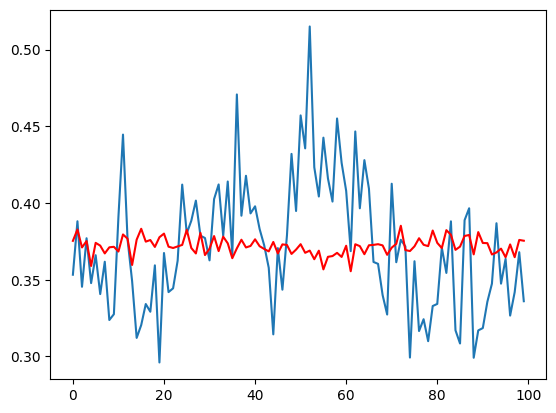

i 46 [ 5.79915678 17.81917004]


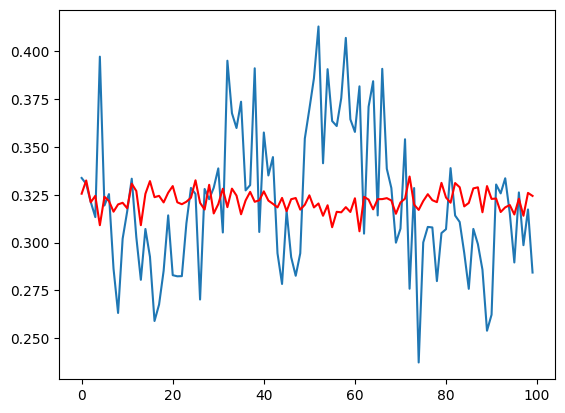

i 47 [ 3.96263657 16.23521352]


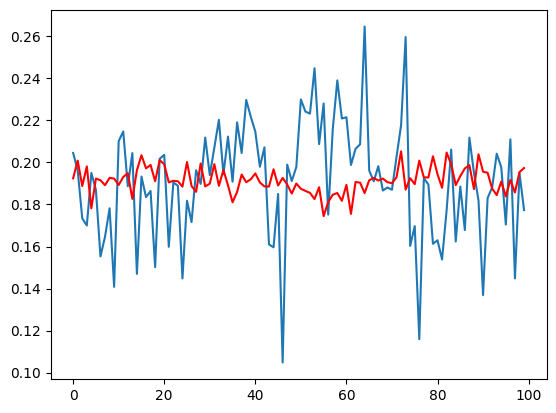

i 48 [23.27070882 10.5686733 ]


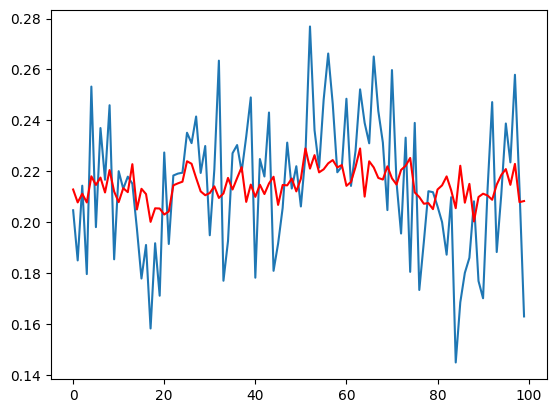

i 49 [ 3.30377738 24.94181091]


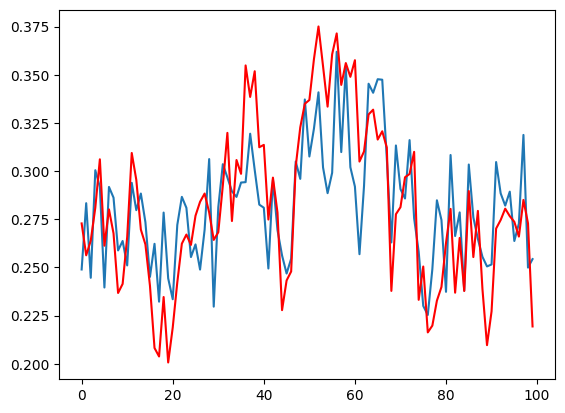

i 50 [18.42669233  9.99773269]


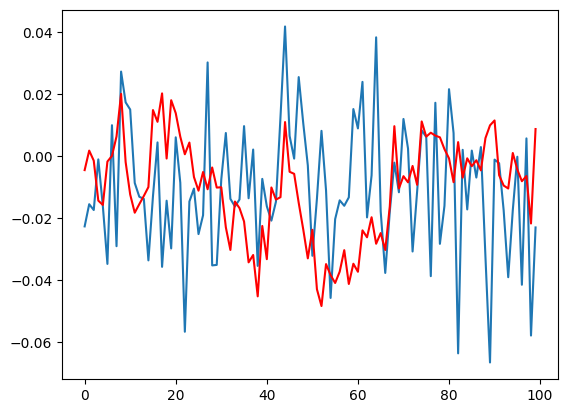

i 51 [8.89243238 0.58110083]


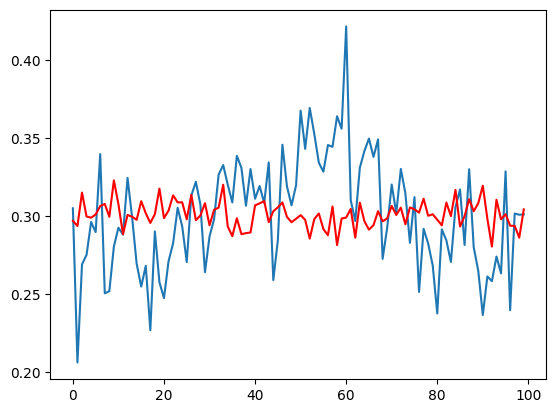

i 52 [12.12028848  6.38570102]


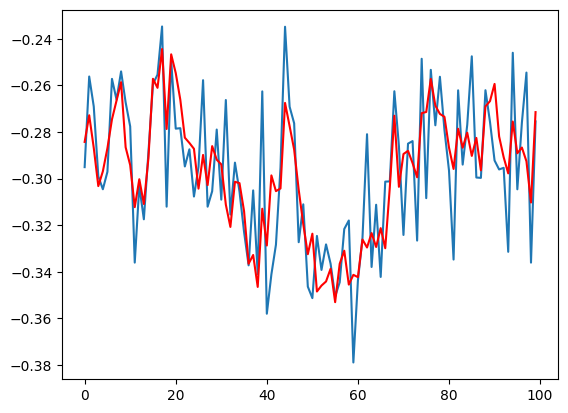

i 53 [21.33865519 13.90821853]


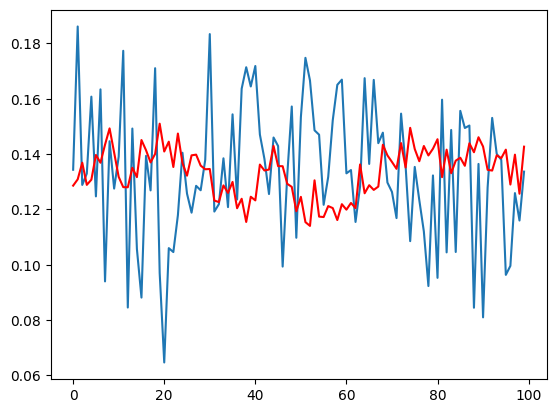

i 54 [6.08356566 0.43379779]


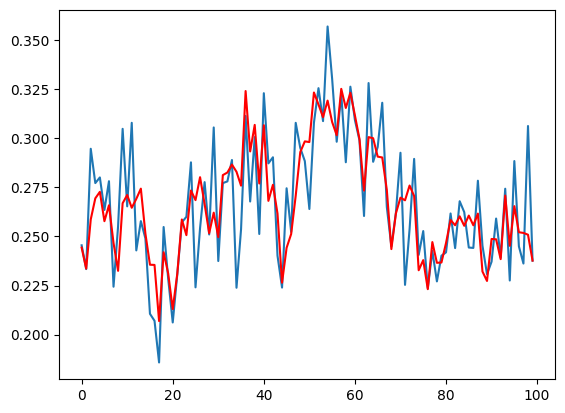

i 55 [20.23536996 24.26769264]


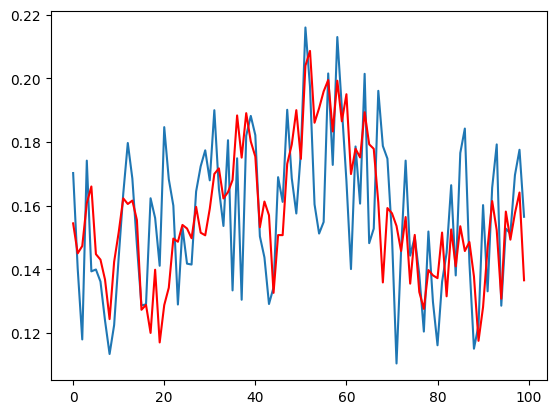

i 56 [22.54893241  9.266479  ]


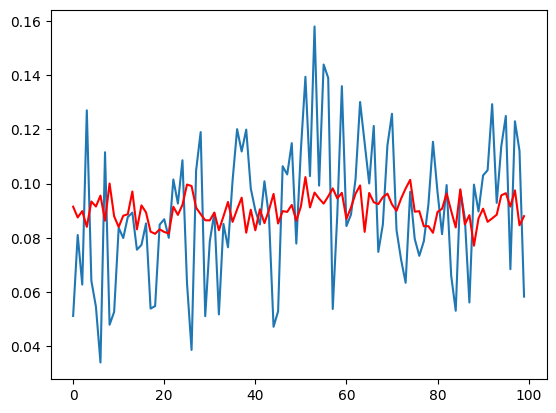

i 57 [15.82564271  1.02156987]


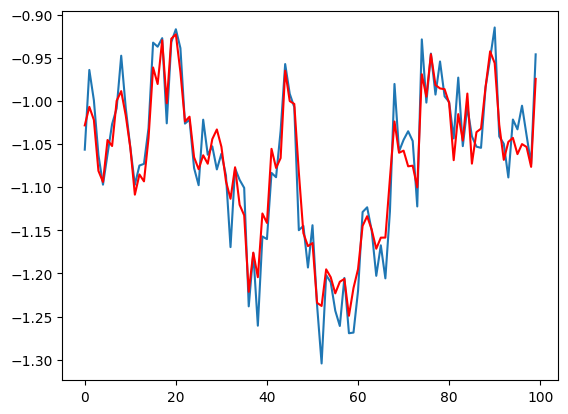

i 58 [18.28614785 13.53927445]


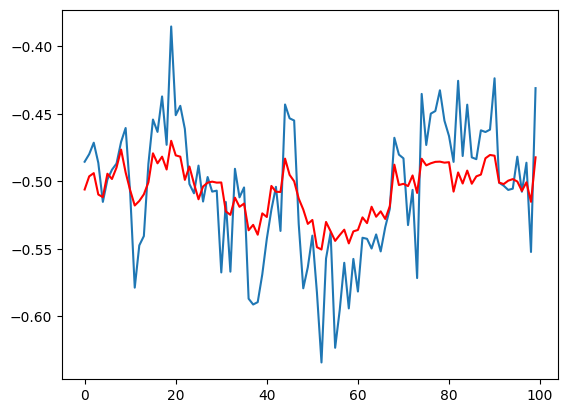

i 59 [ 3.46670463 20.61185556]


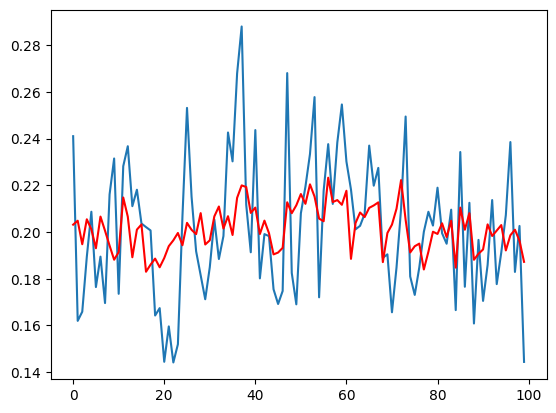

i 60 [16.10656783  3.59000308]


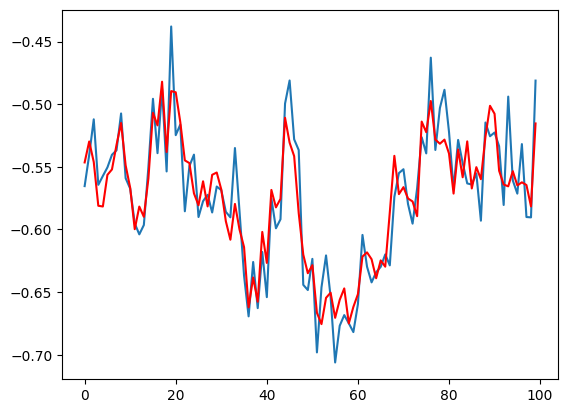

i 61 [11.71289516 20.21317689]


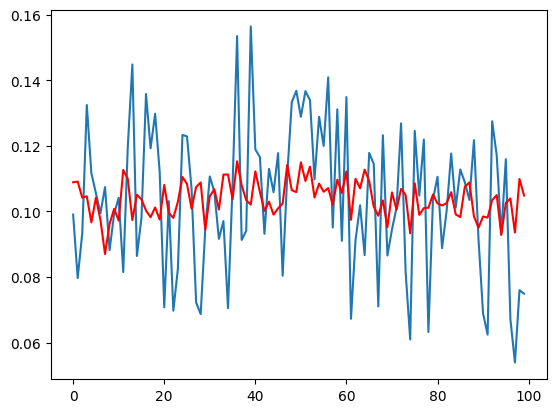

i 62 [ 3.58142712 13.05996444]


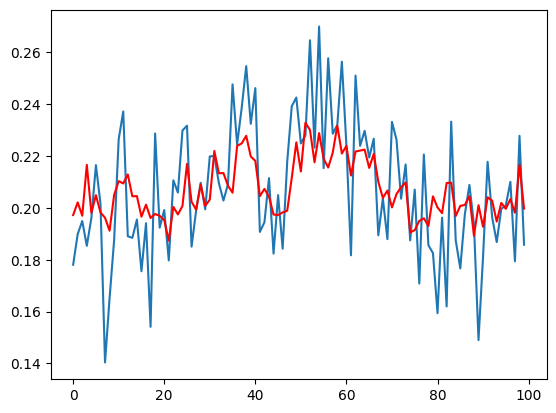

i 63 [12.41067892  9.27297285]


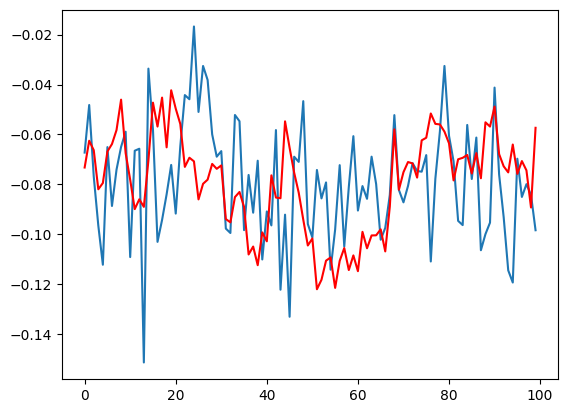

i 64 [13.49540066 23.13804723]


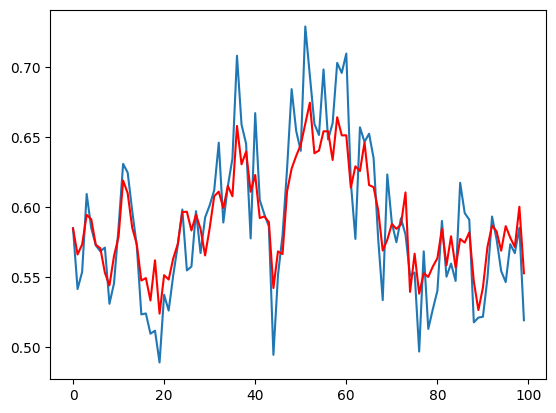

i 65 [21.0102972  24.83239786]


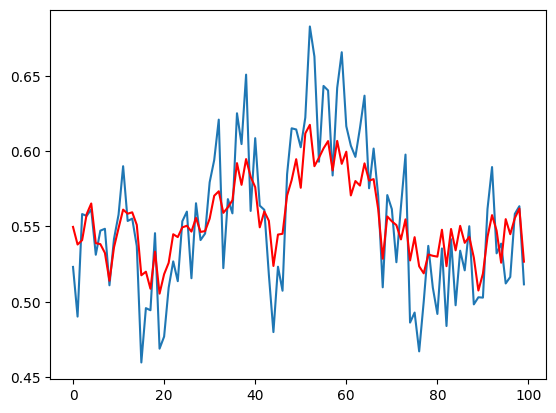

i 66 [22.52818356 17.25416332]


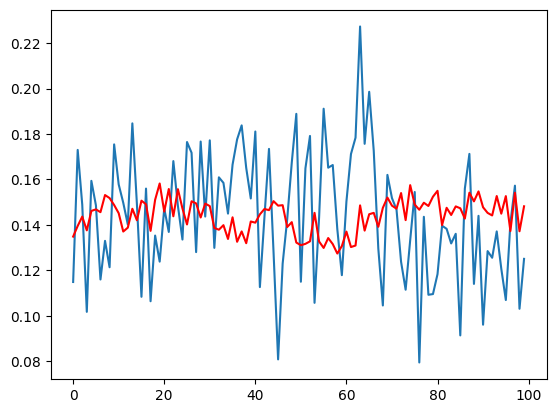

i 67 [18.9262501  11.05410231]


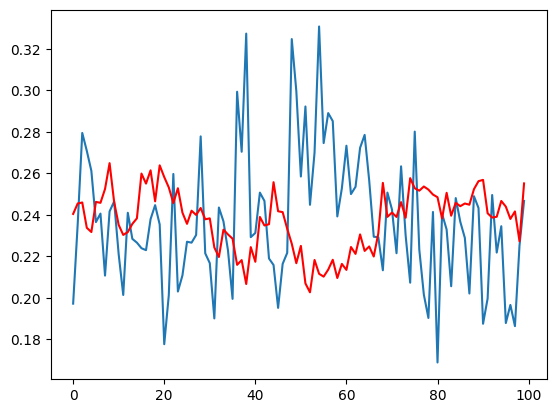

i 68 [13.75553654 21.5607665 ]


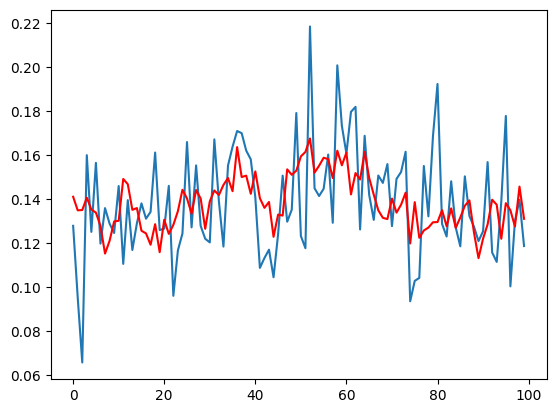

i 69 [16.09083315  6.16935643]


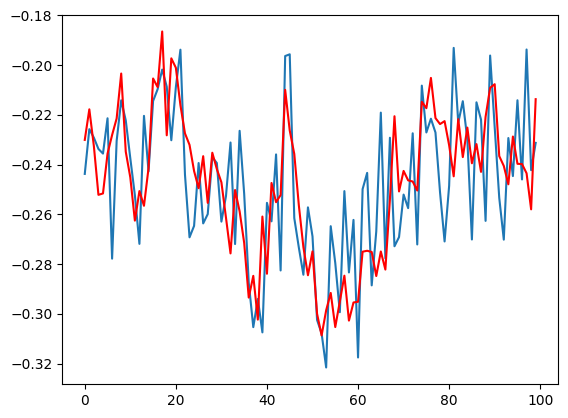

i 70 [ 8.76682997 11.71692224]


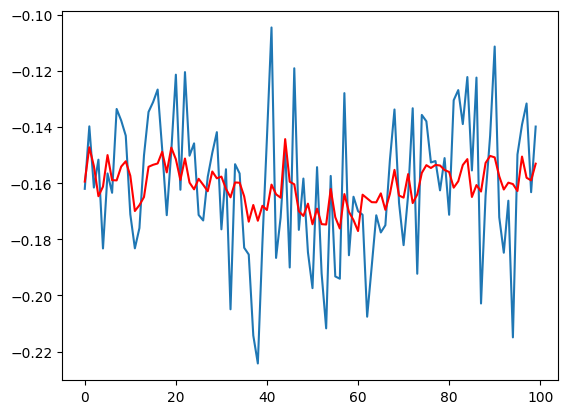

i 71 [3.16613462 2.05739895]


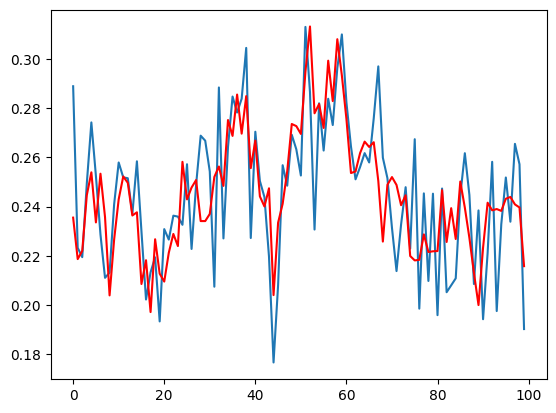

i 72 [19.05201314 24.18015633]


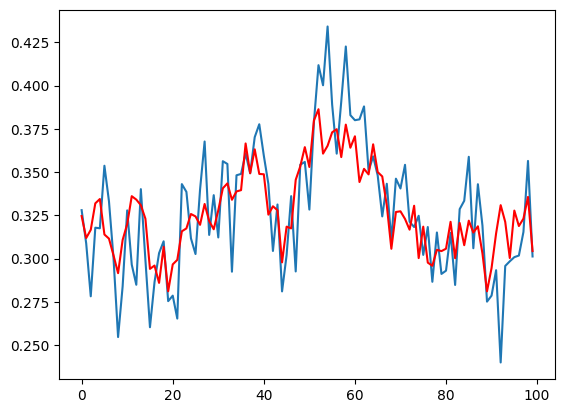

i 73 [ 9.37863755 15.26647845]


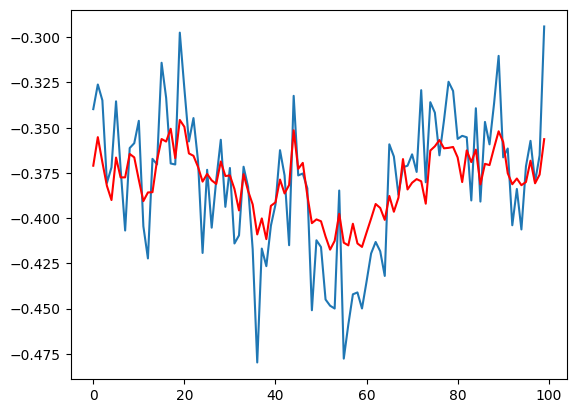

i 74 [19.20447926 20.17629475]


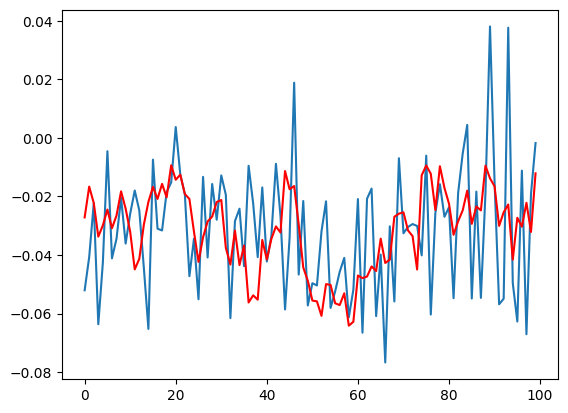

i 75 [6.80290083 5.47527058]


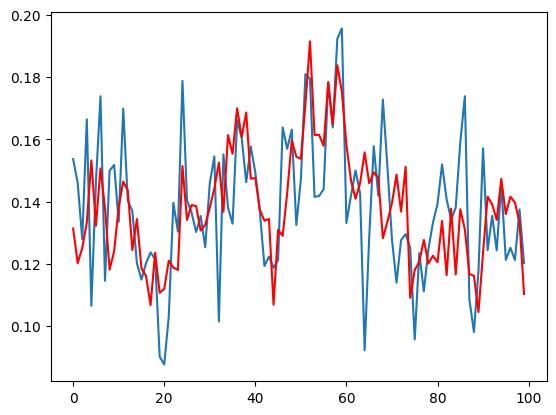

i 76 [10.7891477  19.66911322]


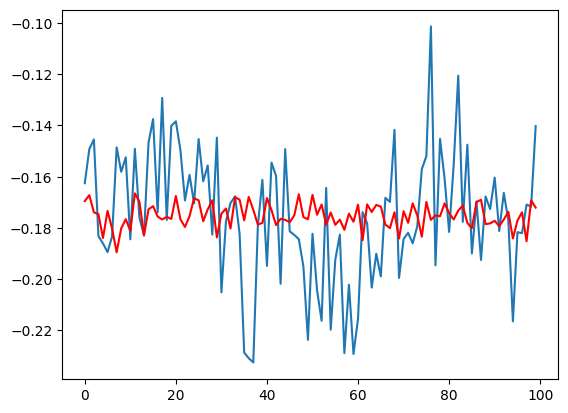

i 77 [14.86419225 24.56944416]


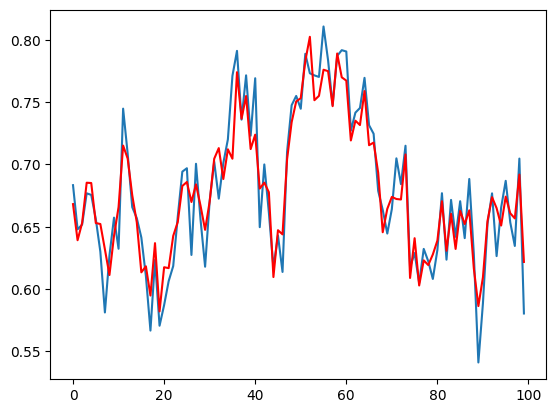

i 78 [17.08050657 23.07622654]


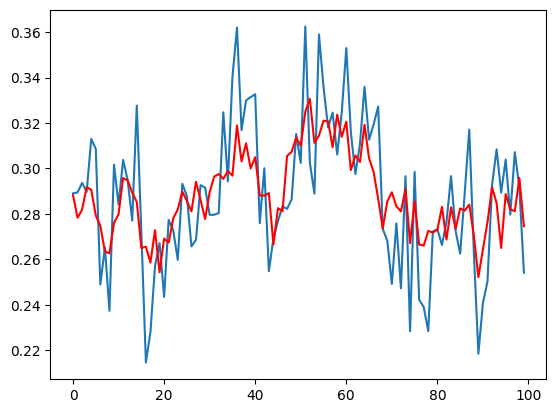

i 79 [1.42804472 9.13073571]


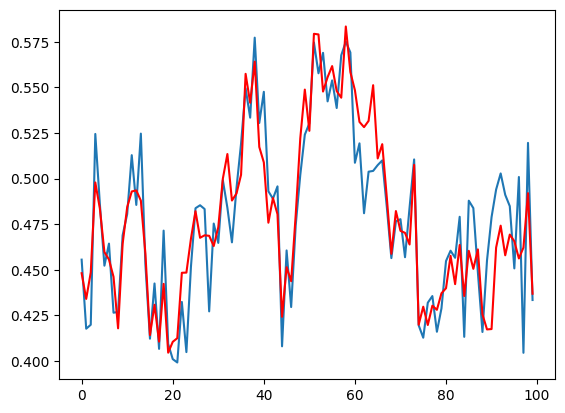

i 80 [20.5859451  5.3735479]


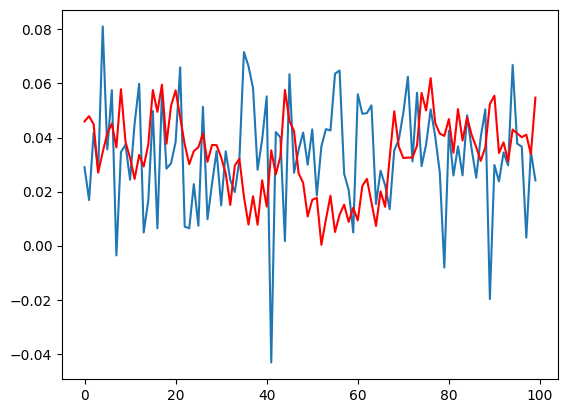

i 81 [19.28736412 21.13446614]


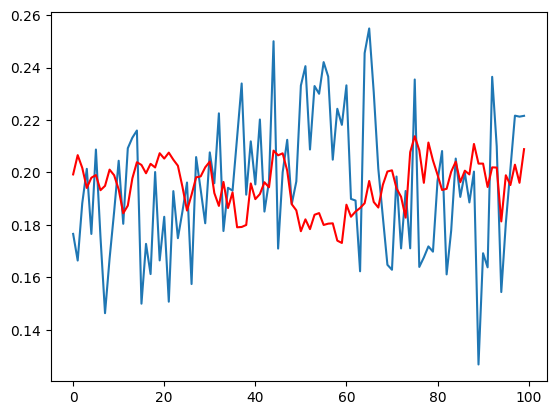

i 82 [15.24655532 24.59984239]


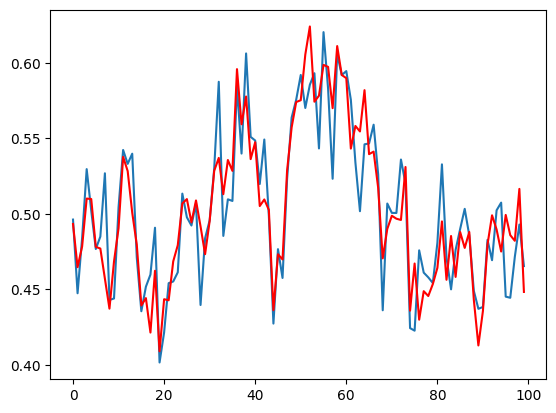

i 83 [5.98270083 8.75292771]


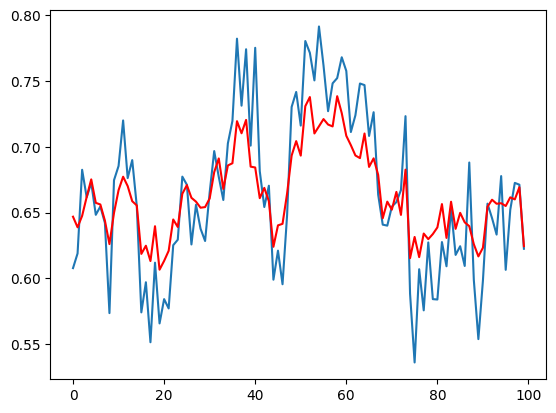

i 84 [22.44272687 15.91172044]


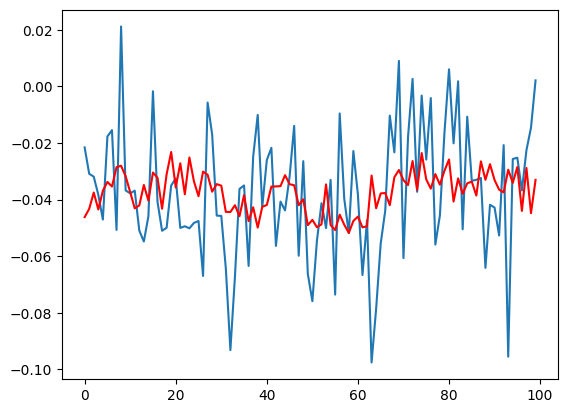

i 85 [23.44216205  3.02218834]


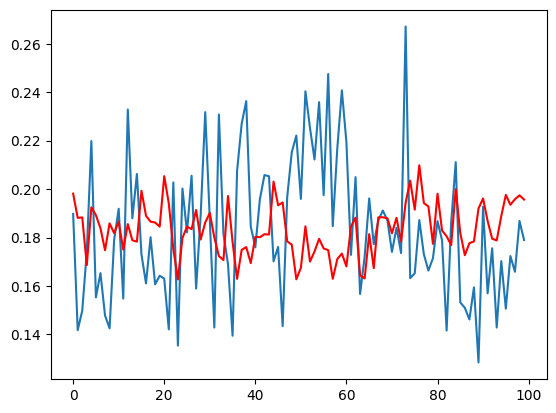

i 86 [15.8225887  19.07118493]


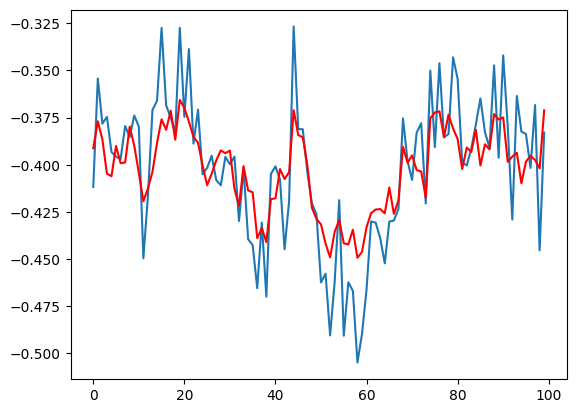

i 87 [17.27580865 11.87819   ]


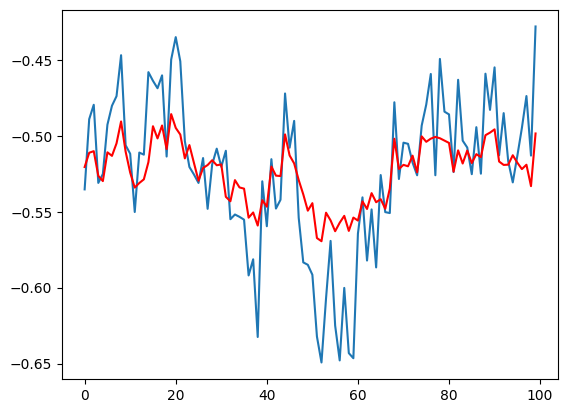

i 88 [19.59032366 18.14172768]


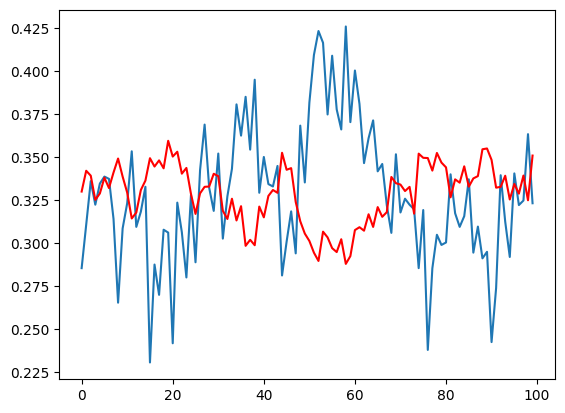

i 89 [16.70733406  9.69034493]


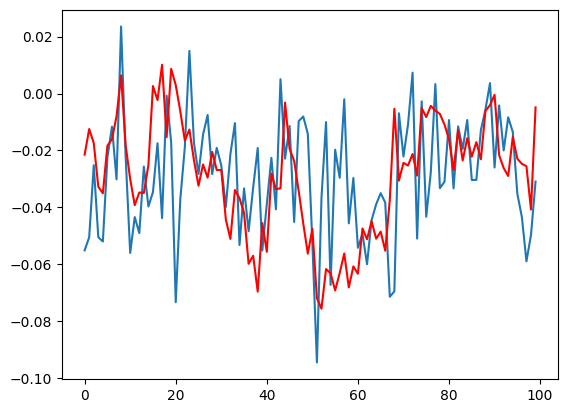

i 90 [12.36208787 20.58692999]


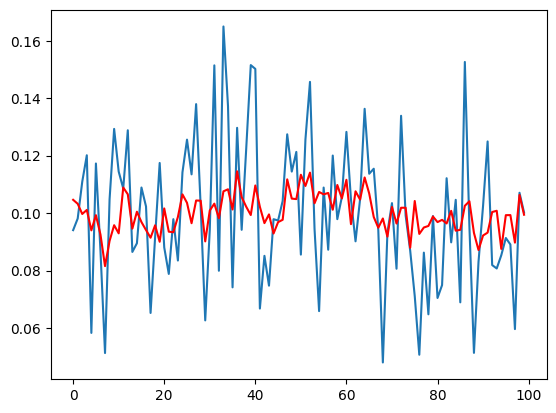

i 91 [15.17391413 17.34253923]


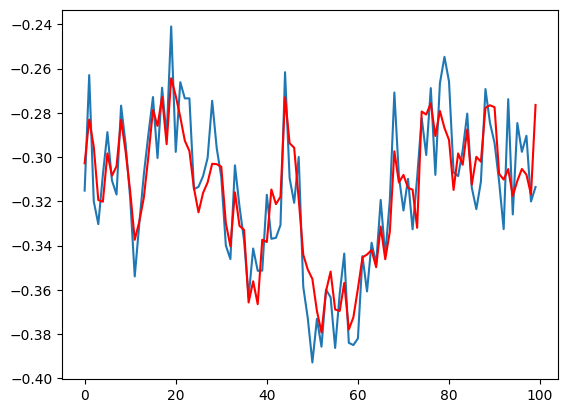

i 92 [22.60111814  3.34030225]


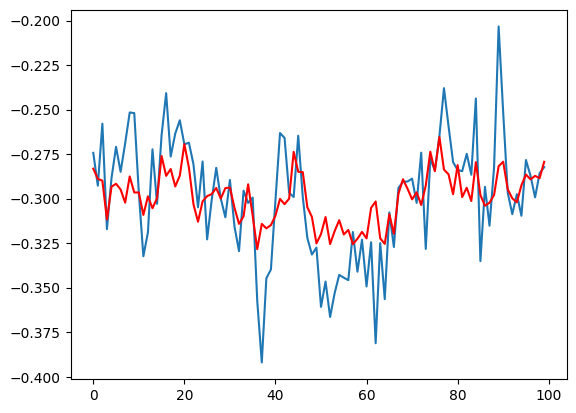

i 93 [11.5574337  10.80624485]


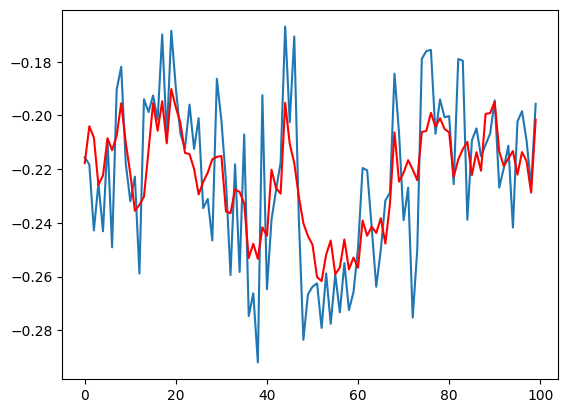

i 94 [ 9.42813261 16.37479601]


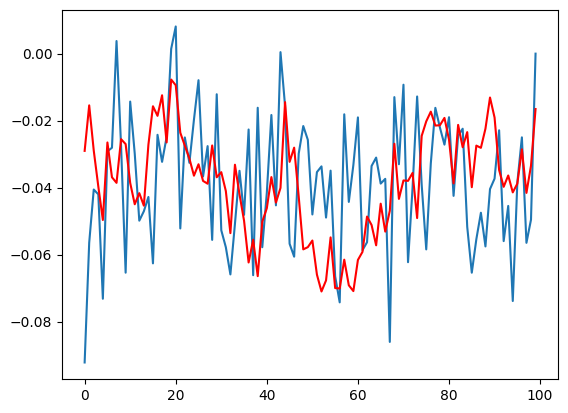

i 95 [4.78931233 0.33333506]


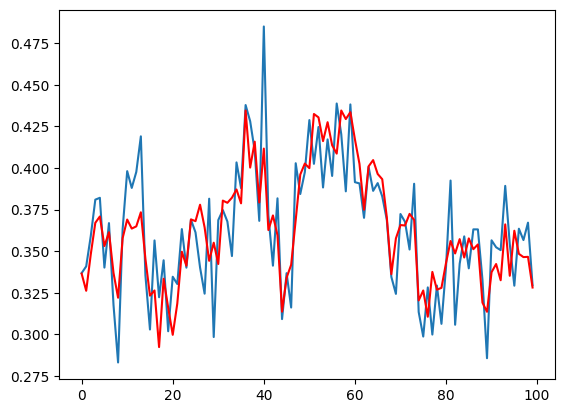

i 96 [12.56624911 12.46155397]


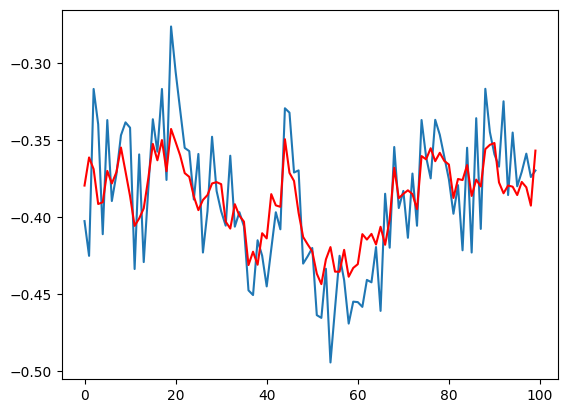

i 97 [21.52000546 13.81186302]


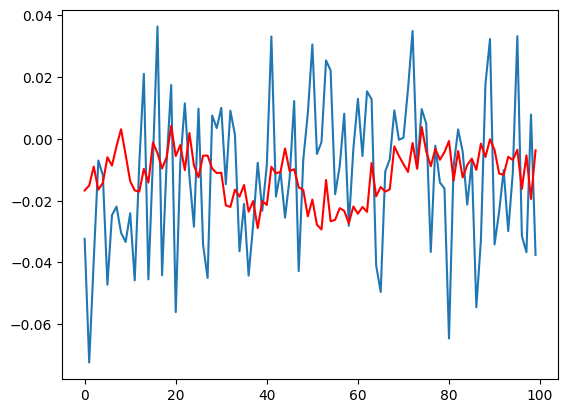

i 98 [7.98565213 8.02059119]


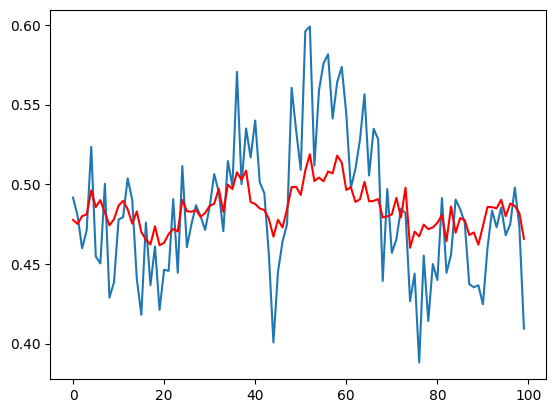

i 99 [17.26912791 13.71895811]


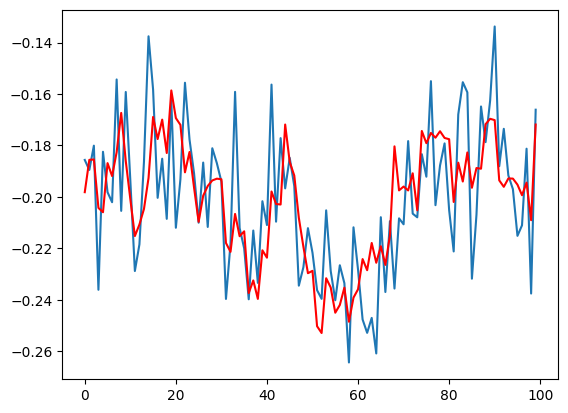

i 100 [8.83241599 0.08420127]


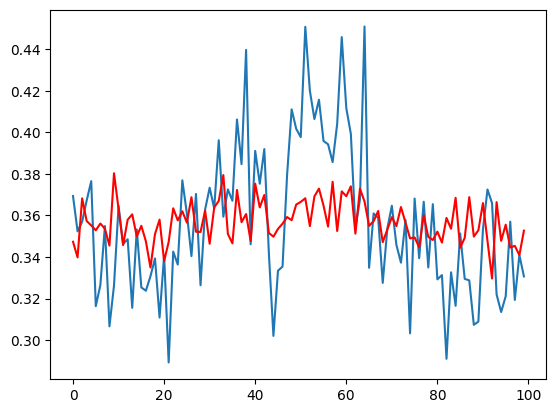

i 101 [ 9.80076846 14.15535789]


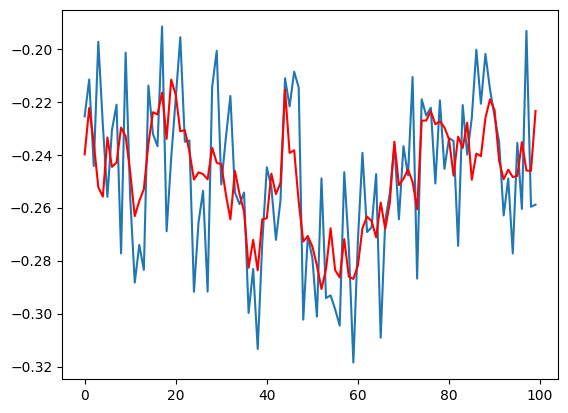

i 102 [ 8.74806113 13.64950169]


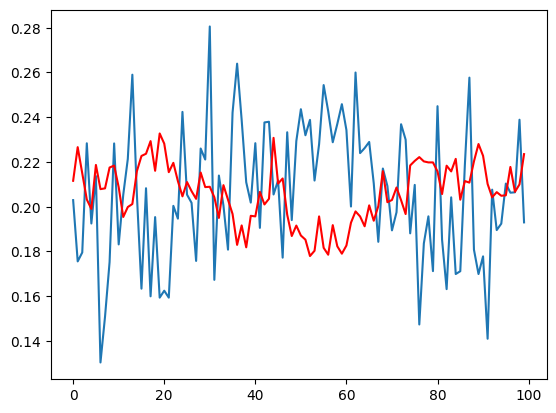

i 103 [12.96140352  4.92138197]


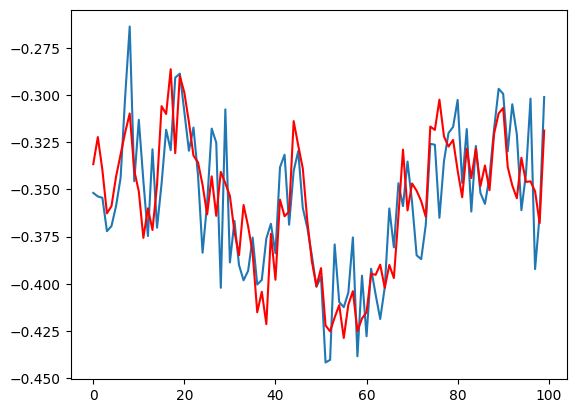

i 104 [13.03507637 18.3832153 ]


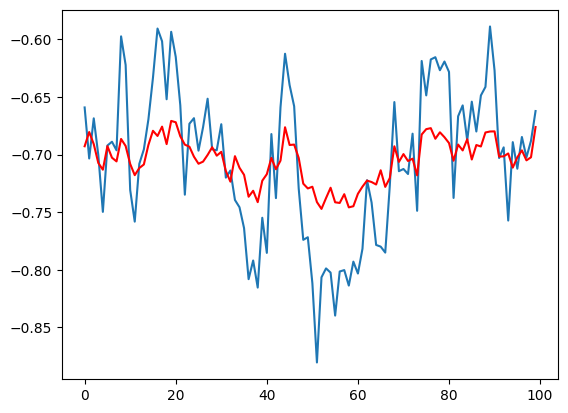

i 105 [2.86038844 1.64103277]


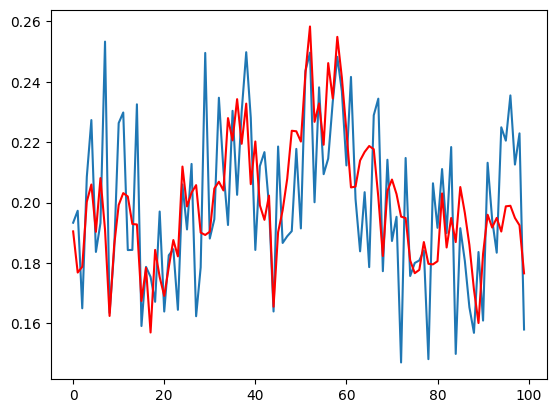

i 106 [21.93999947 24.64823268]


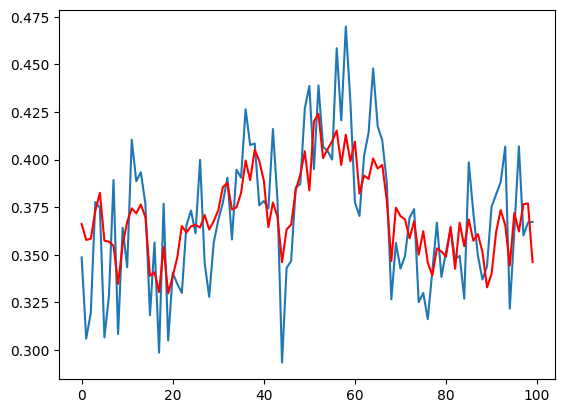

i 107 [19.78101142 14.87775441]


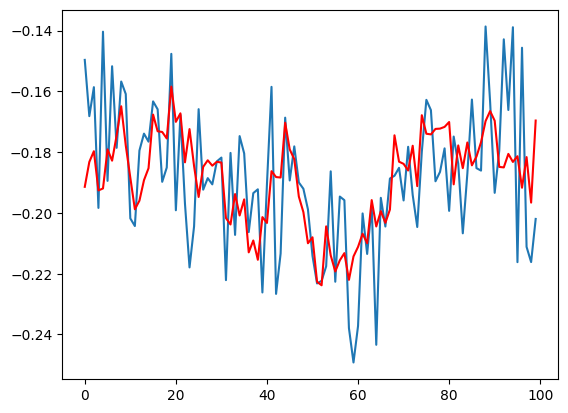

i 108 [22.21216321  6.44227901]


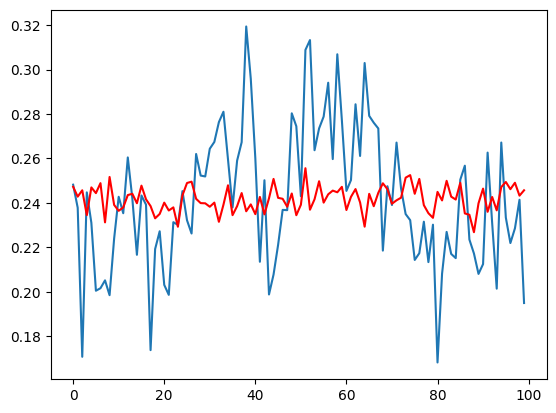

i 109 [ 4.29321961 18.71157915]


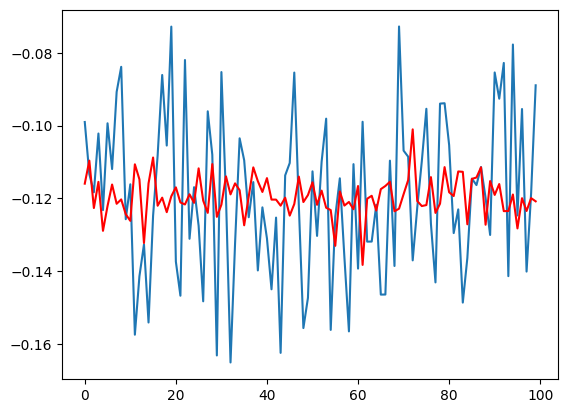

i 110 [17.78820829 21.89047165]


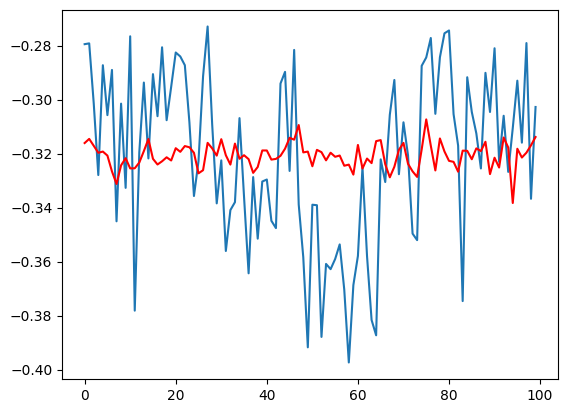

i 111 [11.8727027   6.70891124]


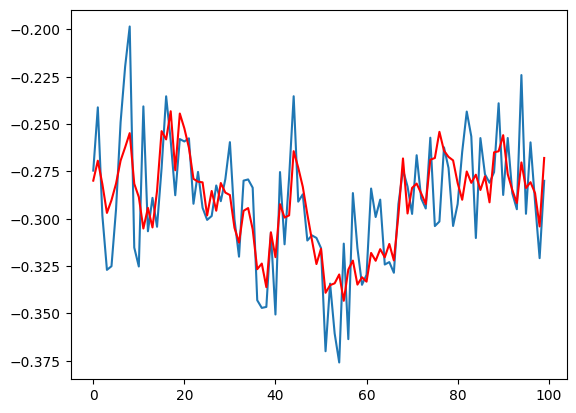

i 112 [14.01591077 23.31891681]


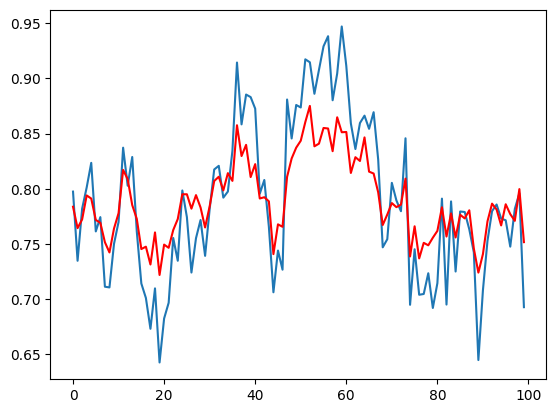

i 113 [20.13799299  2.93386025]


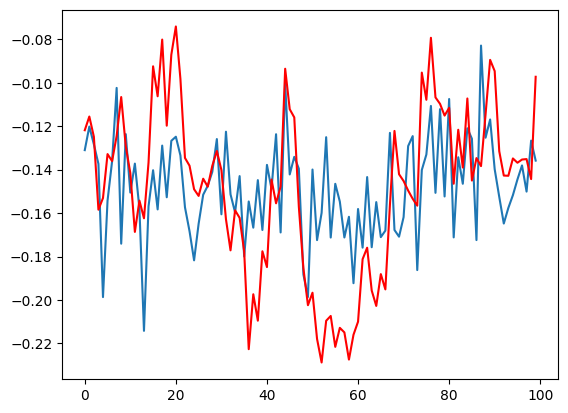

i 114 [12.43176622  8.79302535]


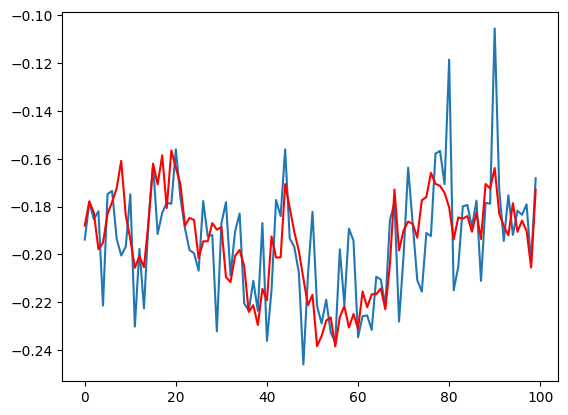

i 115 [18.16294667 18.2861438 ]


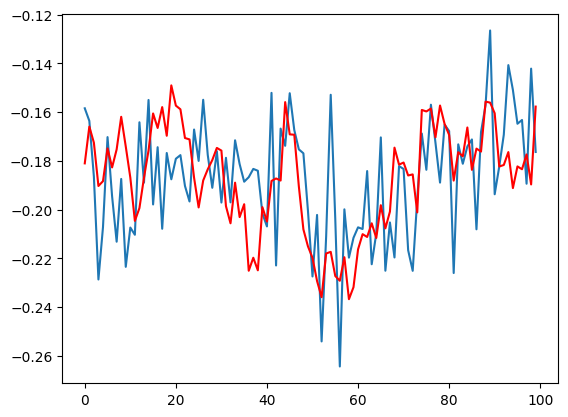

i 116 [19.20290985  0.02594429]


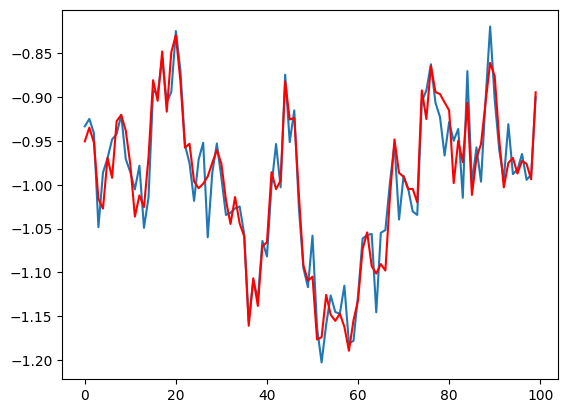

i 117 [7.62045396 4.87291562]


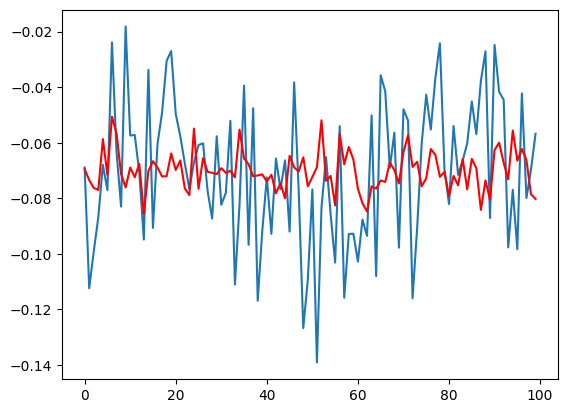

i 118 [20.69648185 13.96018954]


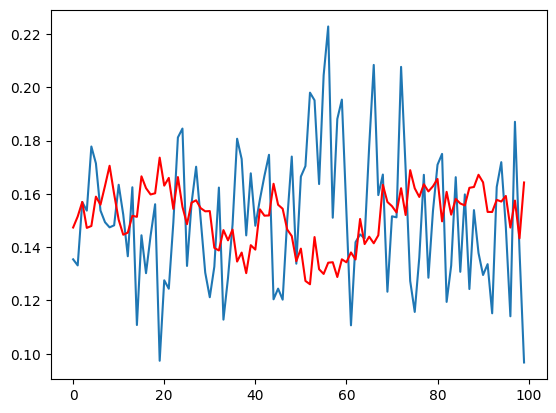

i 119 [20.5645806  17.54744229]


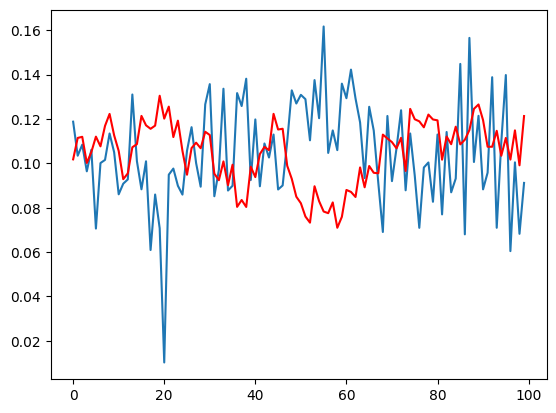

i 120 [15.06785901 13.49131283]


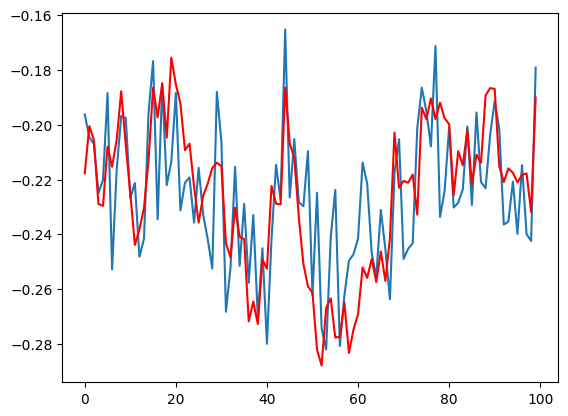

i 121 [10.96932006 17.86391889]


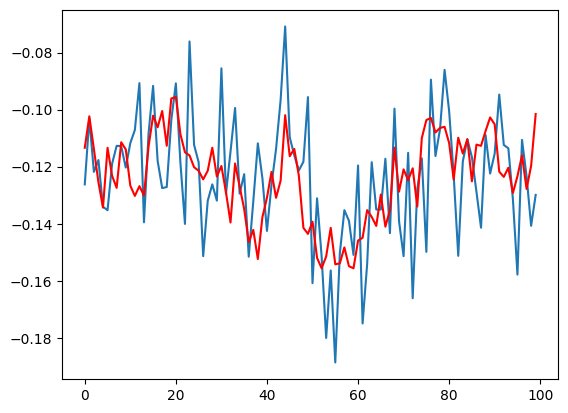

i 122 [22.49265682  6.45116708]


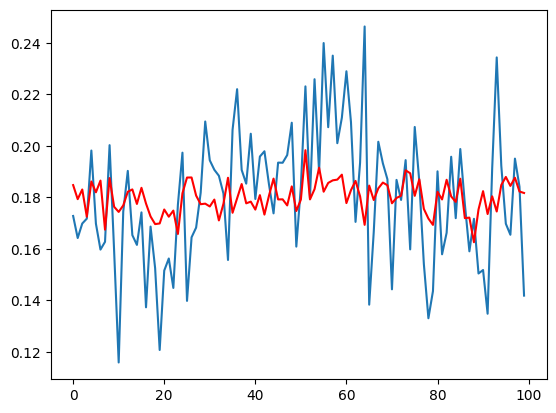

i 123 [2.79760001 2.78737967]


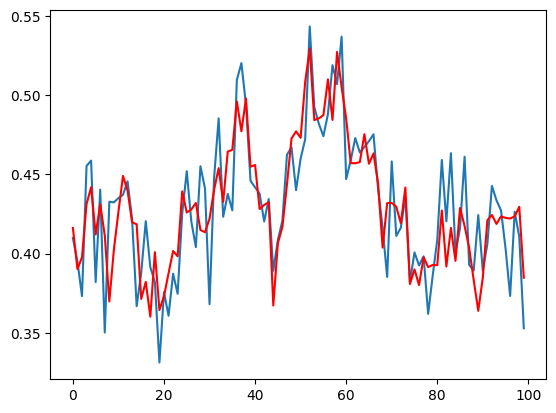

i 124 [21.87847117 21.57985979]


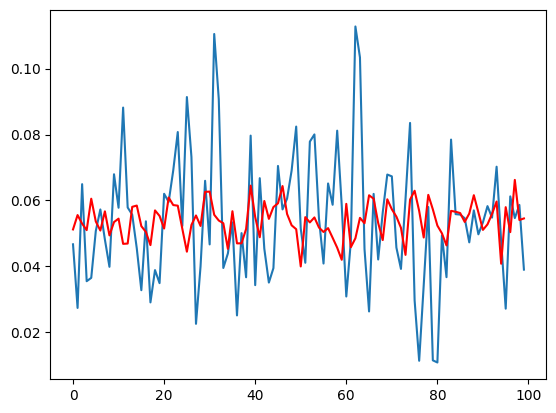

i 125 [18.53847226  4.91000757]


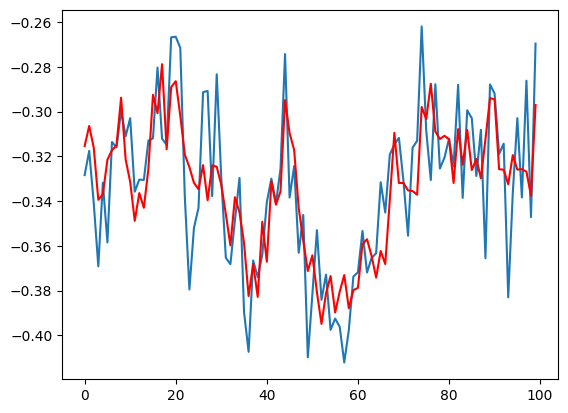

i 126 [ 6.7115553  11.51540825]


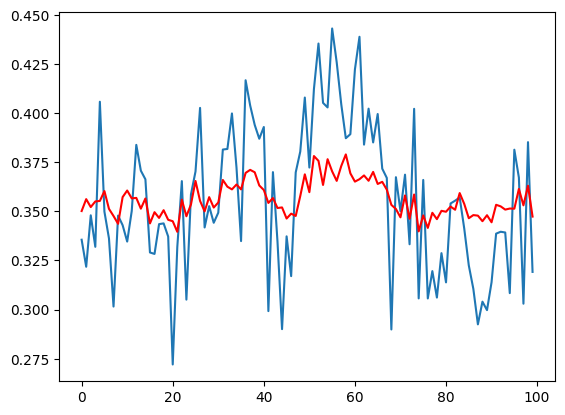

i 127 [15.0476613  12.16896185]


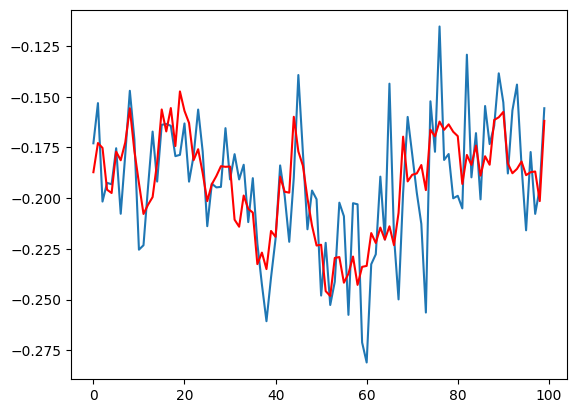

i 128 [11.92890219 21.30296371]


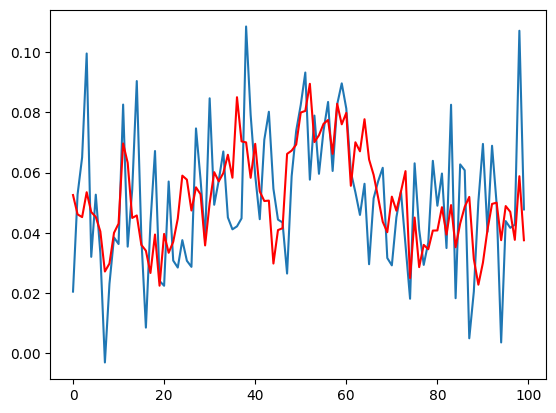

i 129 [9.75594594 9.81281034]


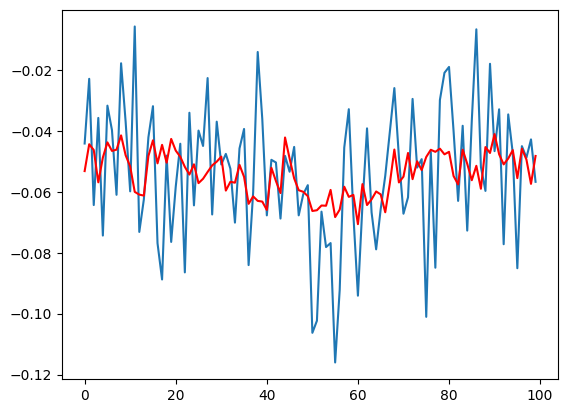

i 130 [24.04187709  6.60512935]


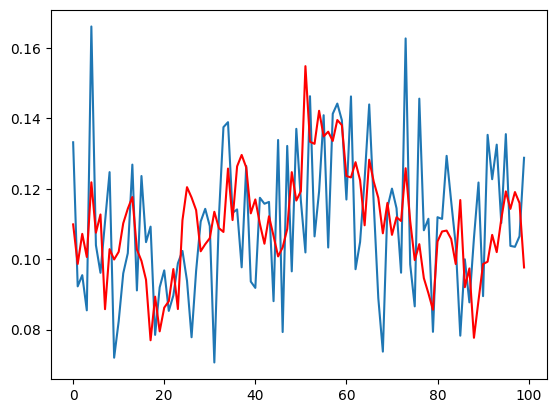

i 131 [24.72120975 24.82103815]


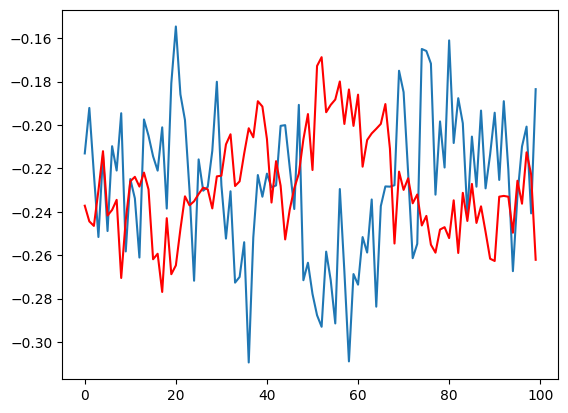

i 132 [ 0.76829706 11.25375637]


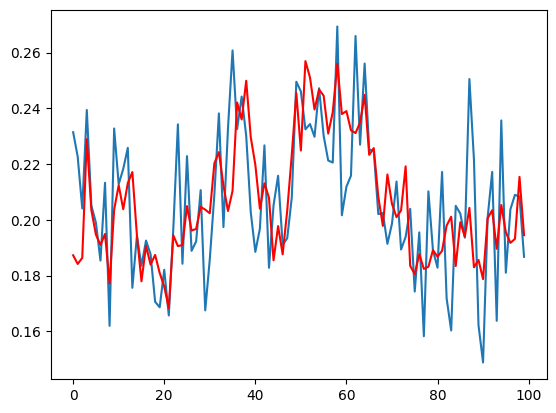

i 133 [23.16428655 13.04286558]


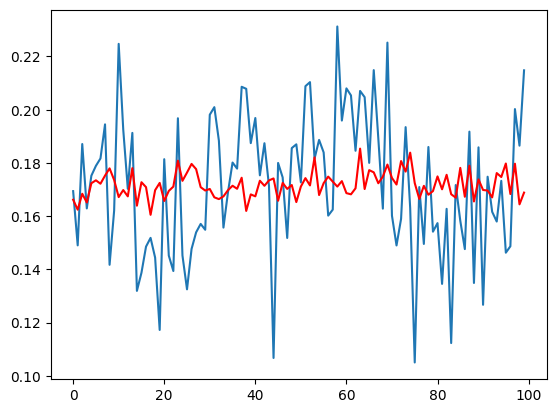

i 134 [19.39479161 19.87240882]


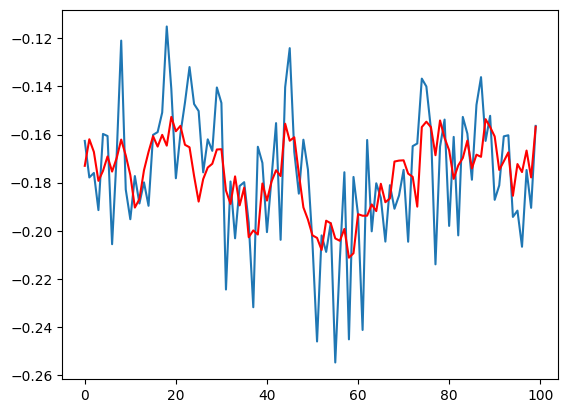

i 135 [ 8.56111596 16.92661763]


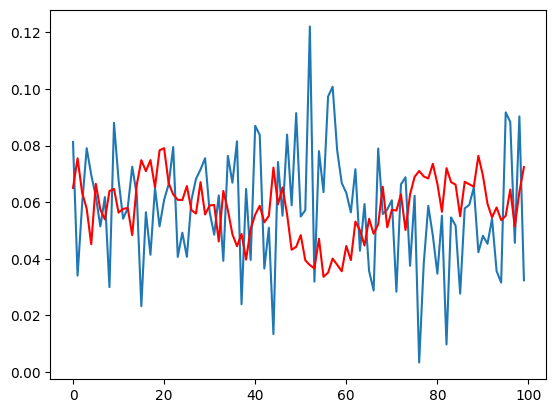

i 136 [14.92679937 22.62262935]


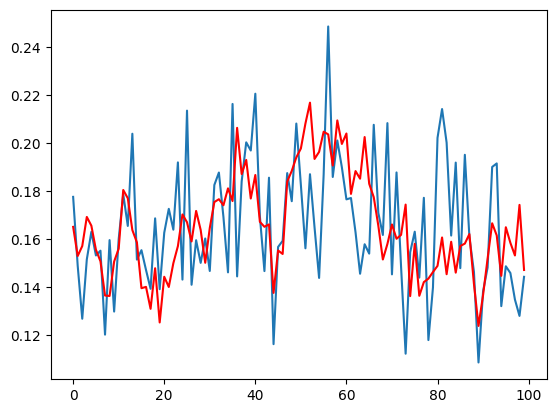

i 137 [ 3.98071525 11.3774511 ]


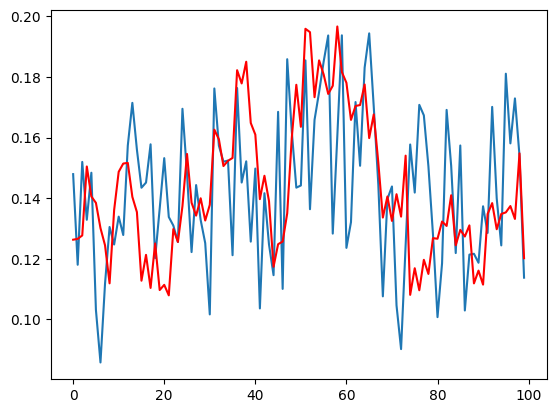

i 138 [ 1.20358851 16.55594914]


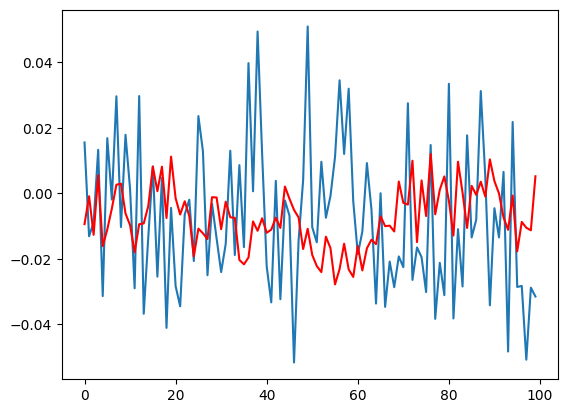

i 139 [18.23490937 16.75381713]


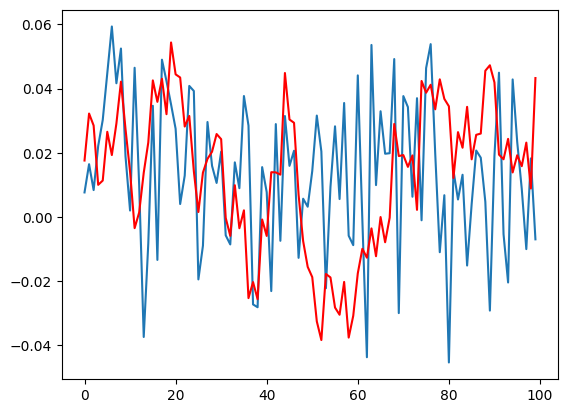

i 140 [21.99853716 21.22683592]


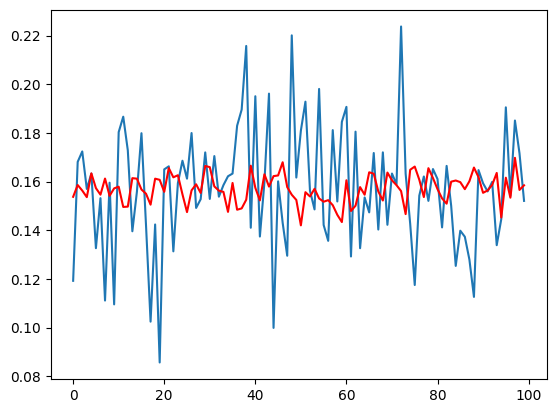

i 141 [ 0.83502101 13.86190732]


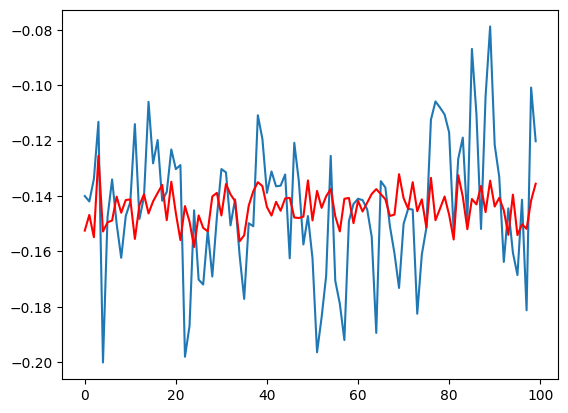

i 142 [10.61985756  2.38423817]


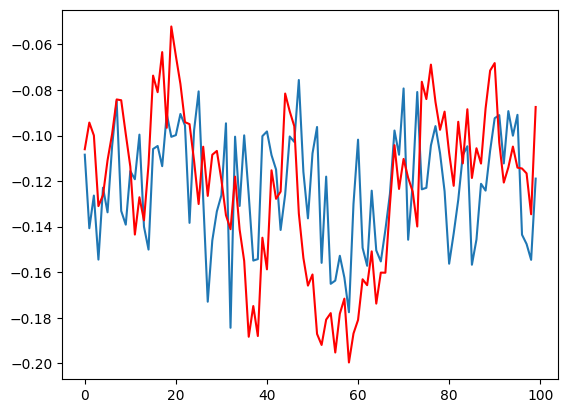

i 143 [16.90148112  8.86968855]


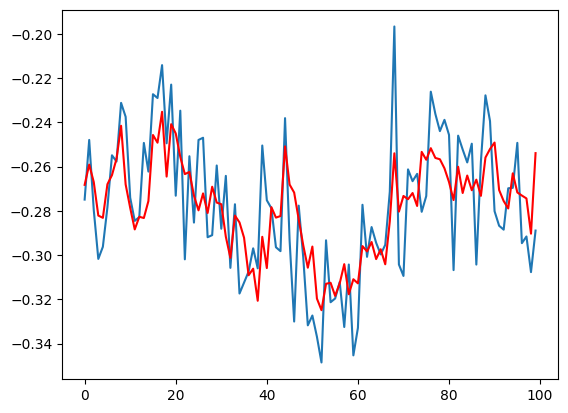

i 144 [23.90970677  9.78402935]


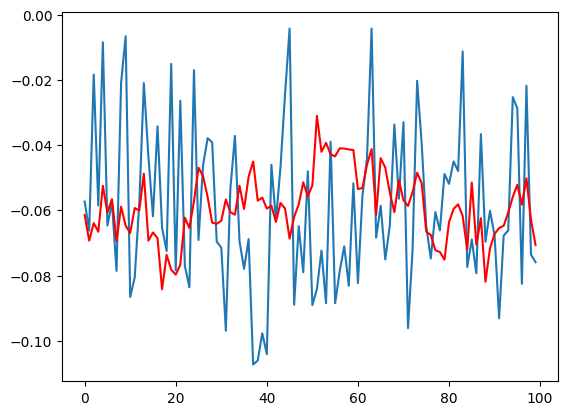

i 145 [12.67062598 22.94652433]


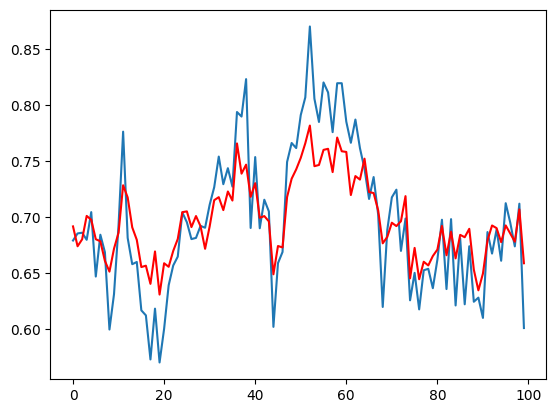

i 146 [22.22331934 10.28978146]


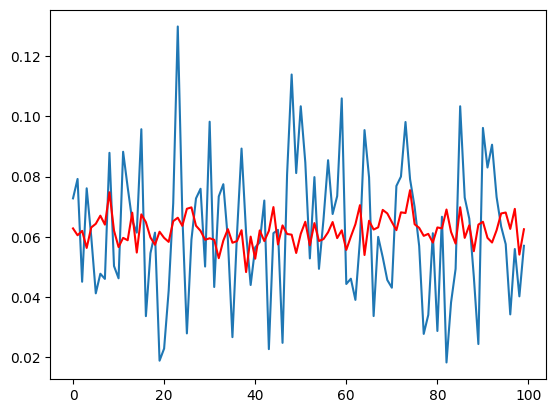

i 147 [15.7464766   5.97143921]


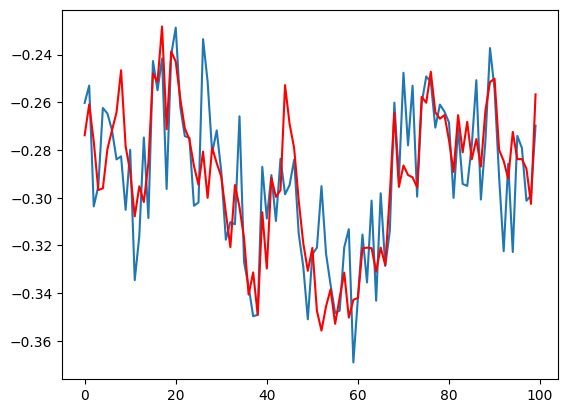

i 148 [ 0.47708965 24.61508474]


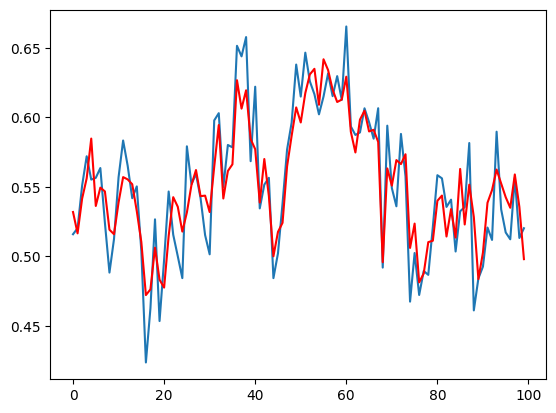

i 149 [3.50415344 9.5712788 ]


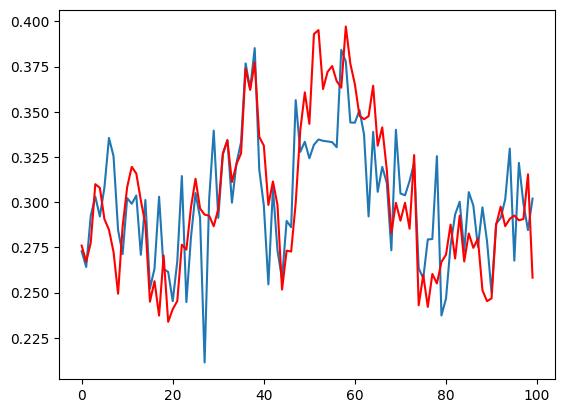

i 150 [24.79538768 22.81708687]


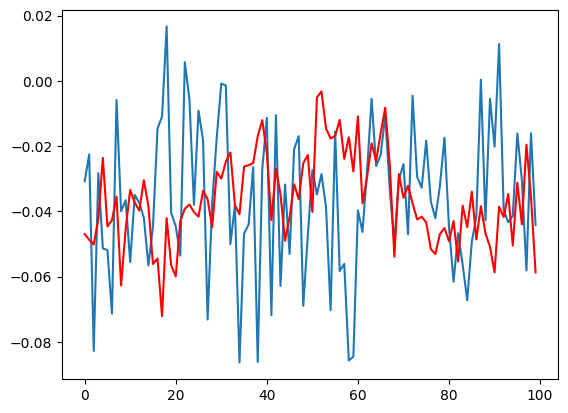

i 151 [15.00785779 18.56124163]


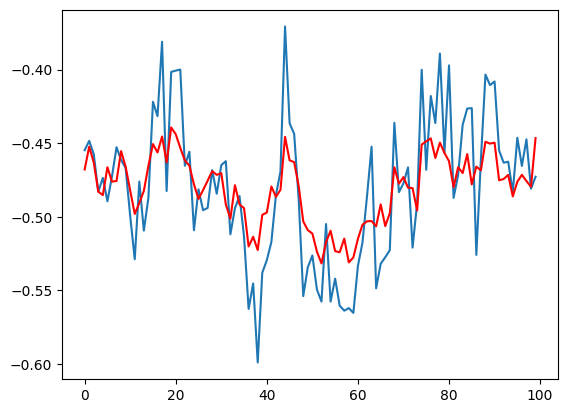

i 152 [ 6.75603572 19.52942674]


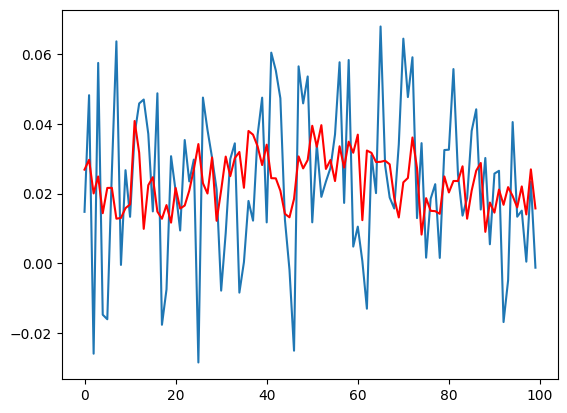

i 153 [18.63267381  5.10686591]


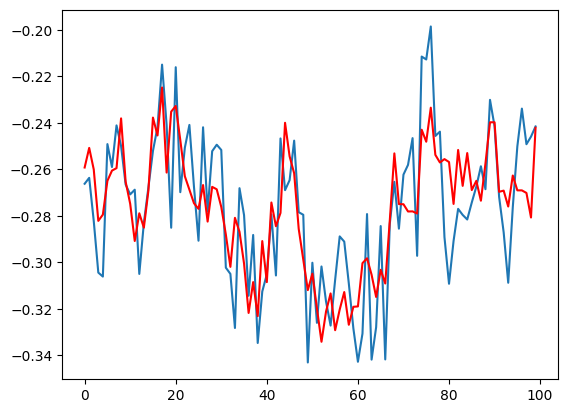

i 154 [10.1452079  14.44774742]


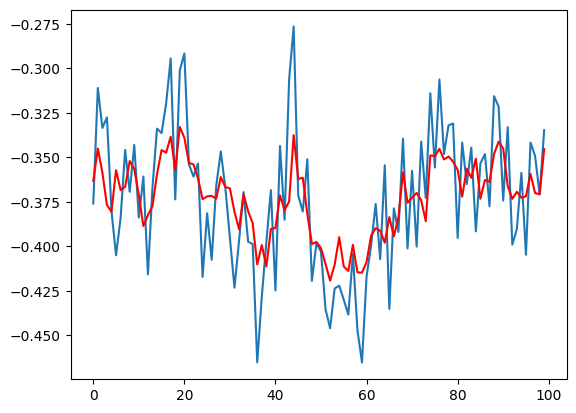

i 155 [22.8598396   3.78330245]


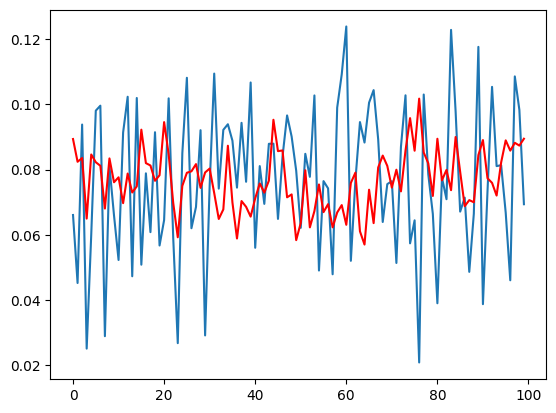

i 156 [19.40204246 17.45865496]


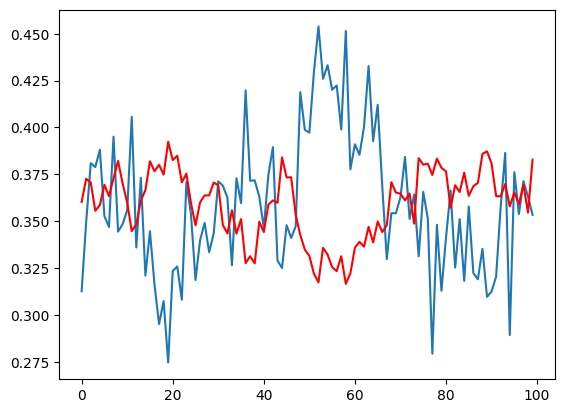

i 157 [23.75601572 13.904208  ]


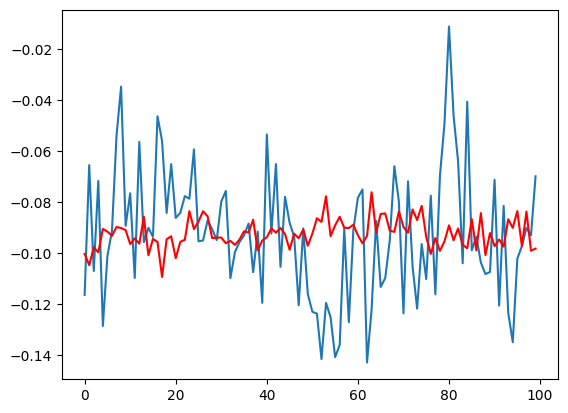

i 158 [ 0.92140104 18.22633348]


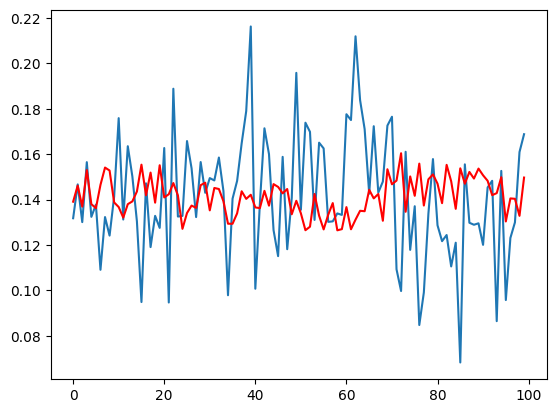

i 159 [12.54159243 13.55865372]


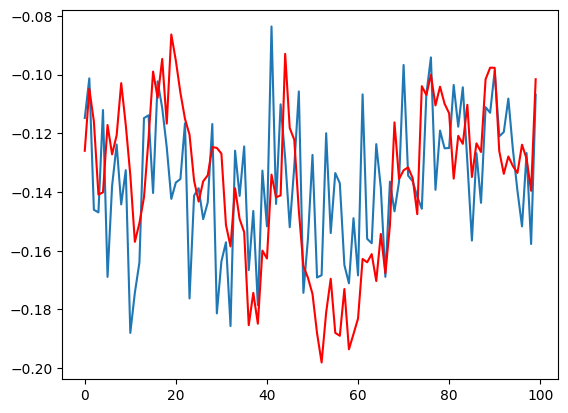

i 160 [ 7.02213319 18.75984484]


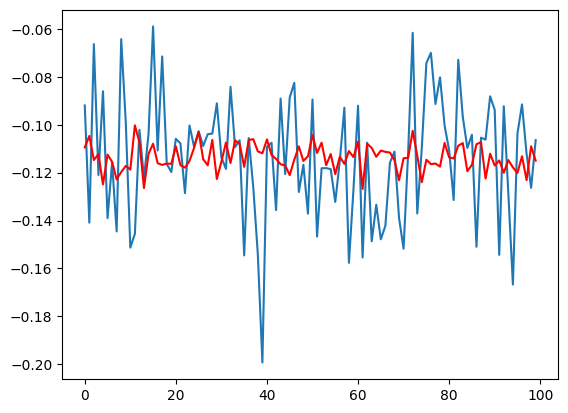

i 161 [15.1155008  13.57063369]


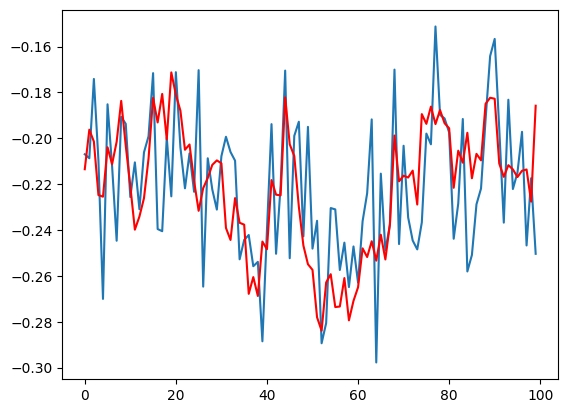

i 162 [20.4738431   8.71592986]


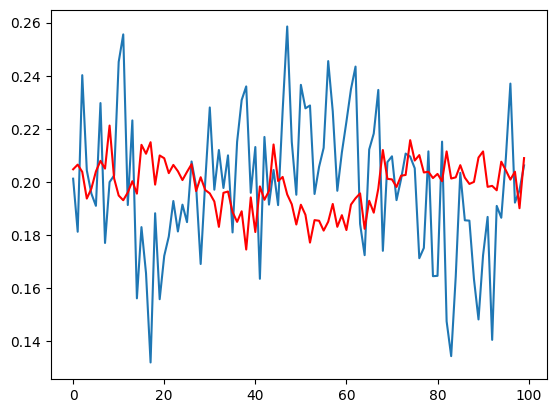

i 163 [13.01966798  8.35346754]


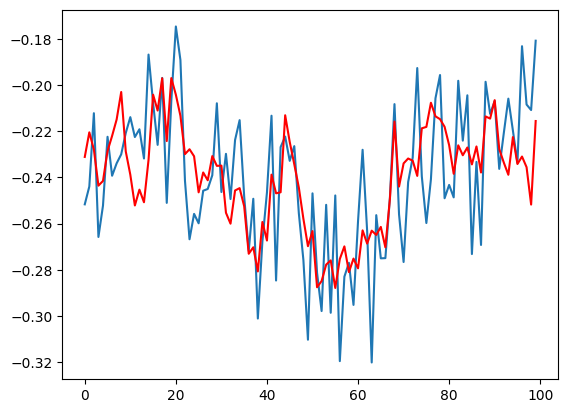

i 164 [12.21640246  3.35282414]


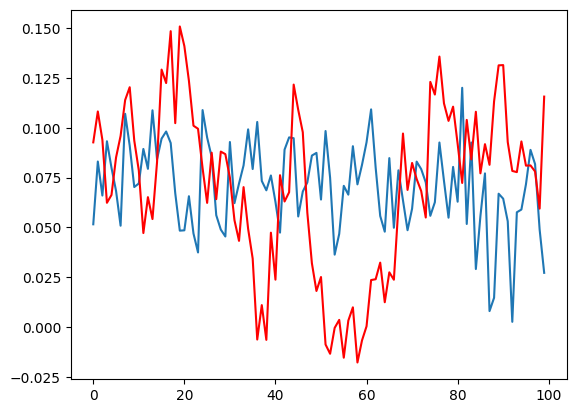

i 165 [19.9791954   6.92155456]


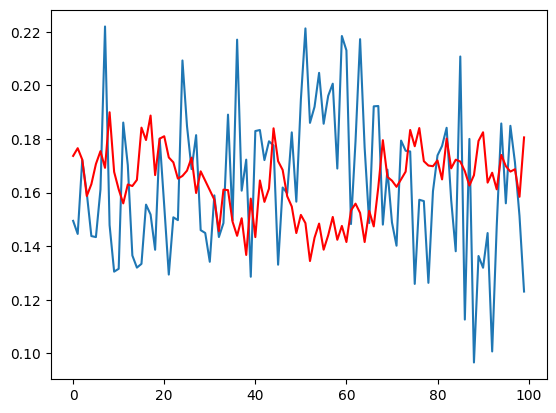

i 166 [ 9.78437685 11.80996977]


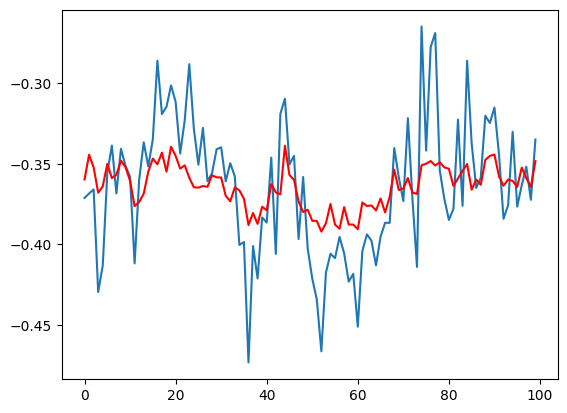

i 167 [0.08721662 7.40572409]


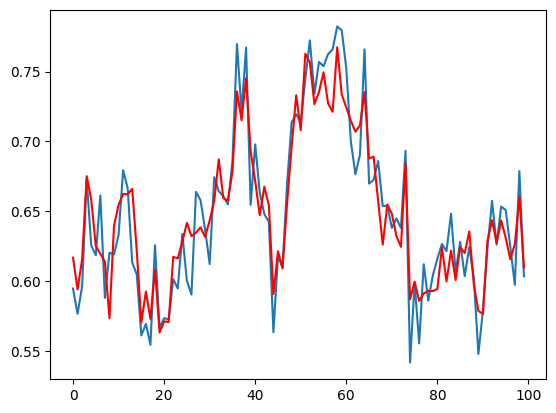

i 168 [ 2.02422422 12.16512954]


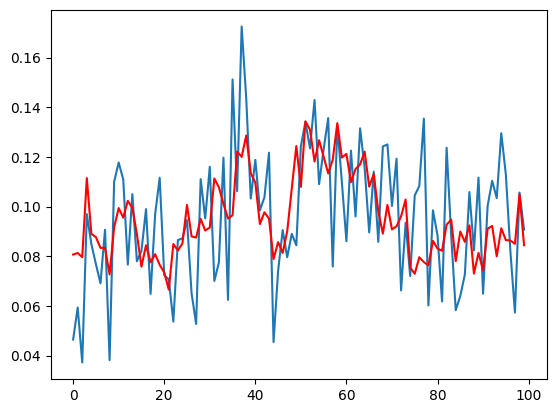

i 169 [16.71565152 16.51107089]


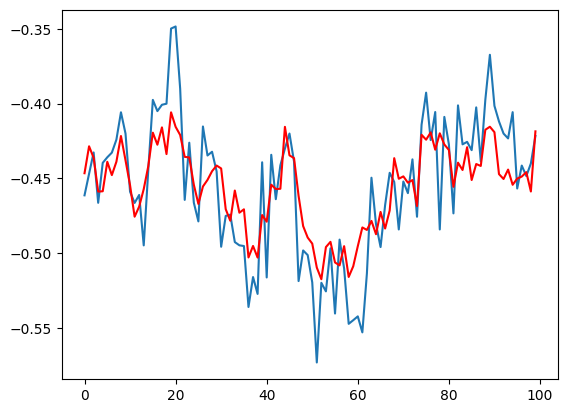

i 170 [21.02664332 10.51003184]


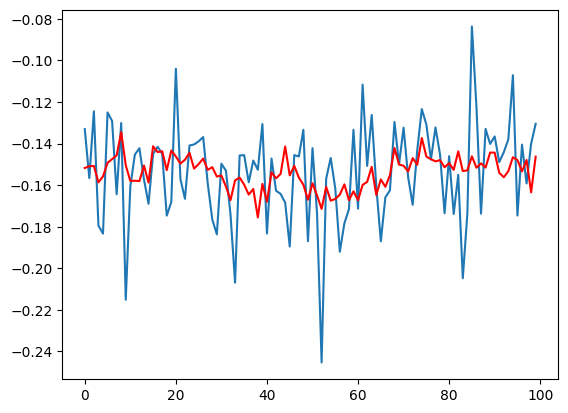

i 171 [5.28282777 2.11745588]


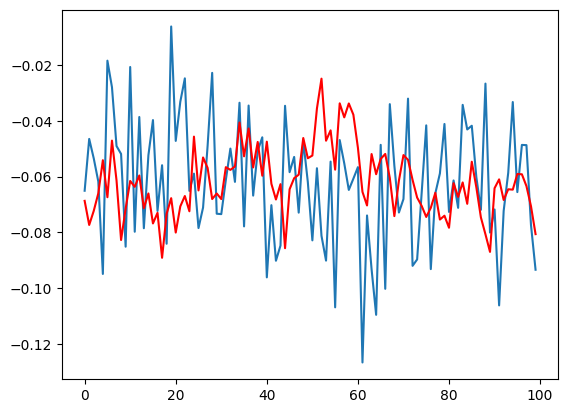

i 172 [2.70378111 6.72814914]


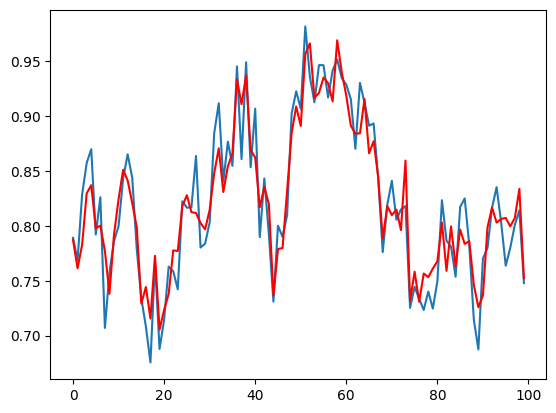

i 173 [10.6187539  12.70593846]


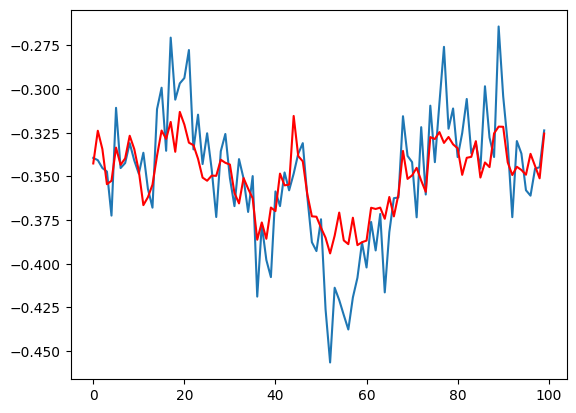

i 174 [23.10403763  2.31757213]


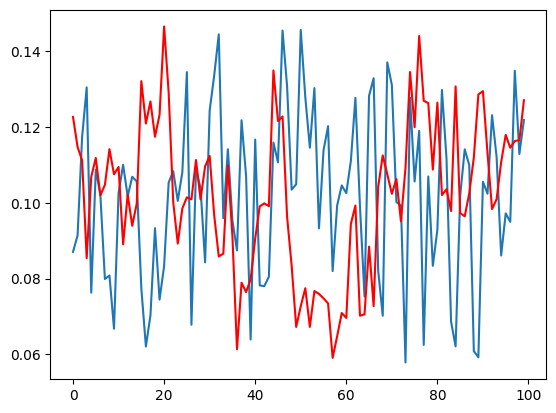

i 175 [24.04134963  6.2247016 ]


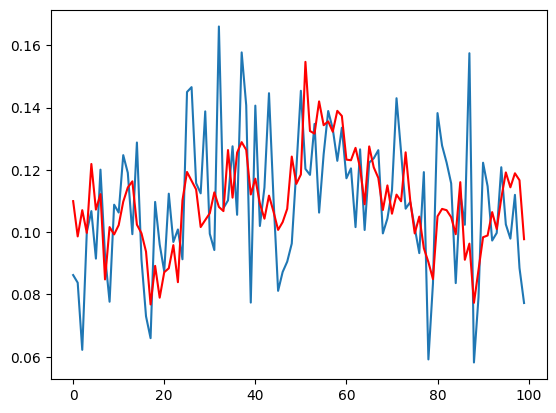

i 176 [19.92203979  7.117438  ]


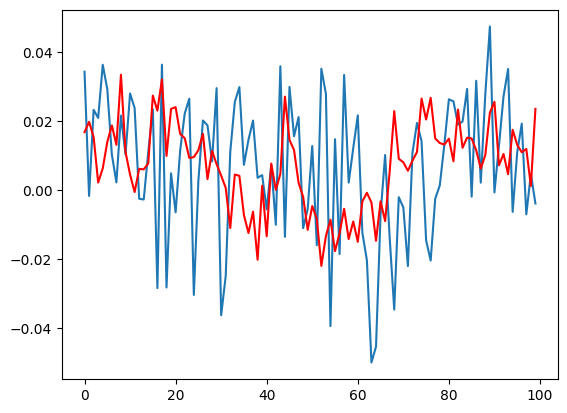

i 177 [22.25956318  3.77520834]


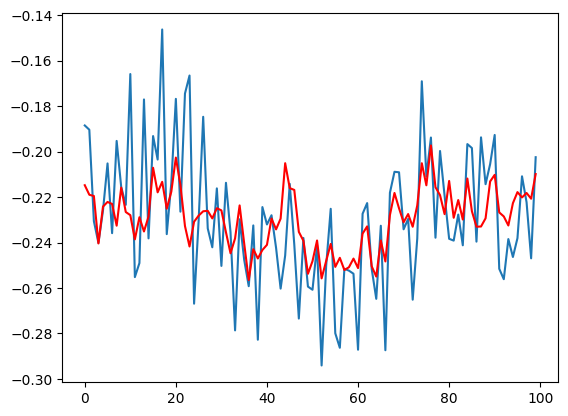

i 178 [ 3.49507371 17.14270946]


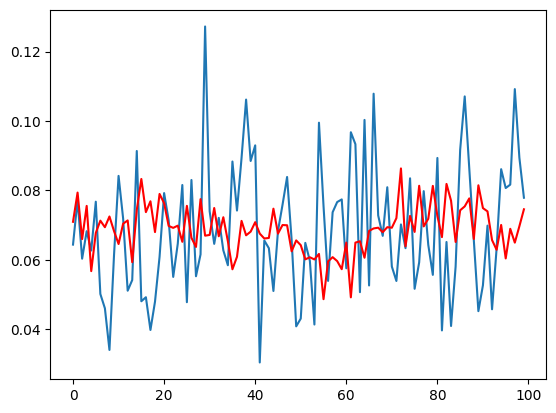

i 179 [ 7.77444777 19.30600046]


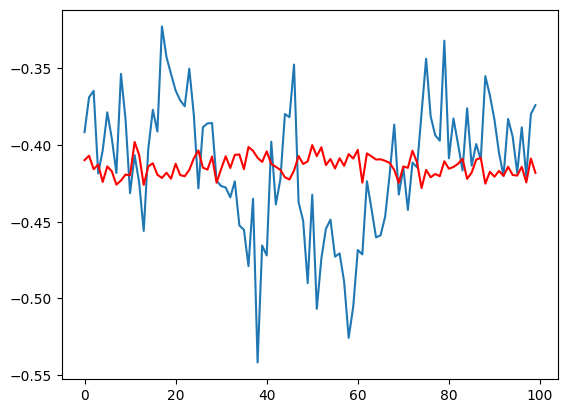

i 180 [ 2.4833227  18.96010074]


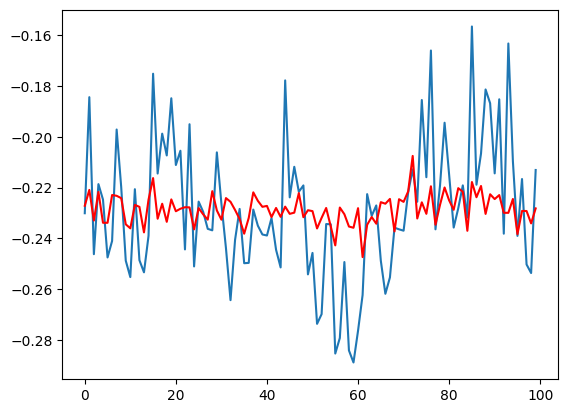

i 181 [12.71302813  5.42984725]


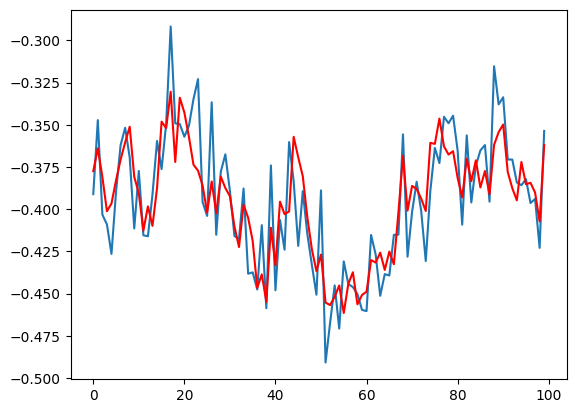

i 182 [22.4680704  21.41959819]


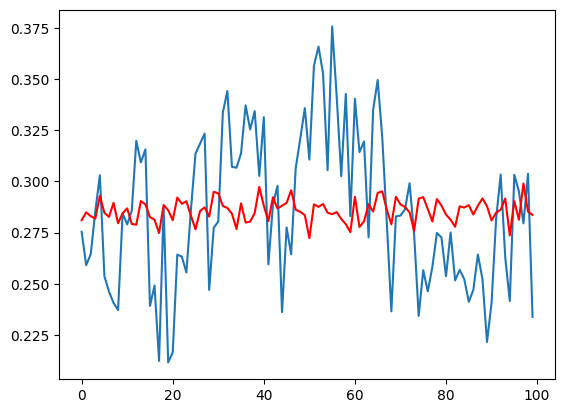

i 183 [0.36820488 8.50490791]


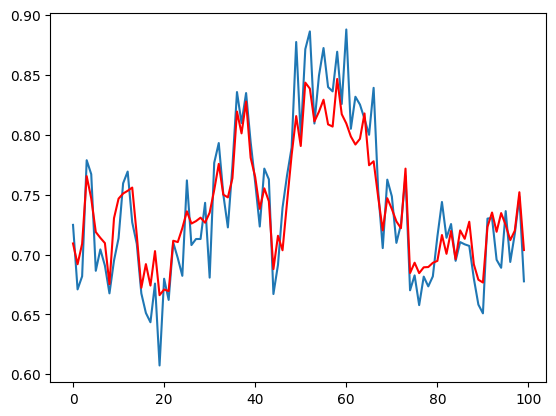

i 184 [6.74946524 4.42443717]


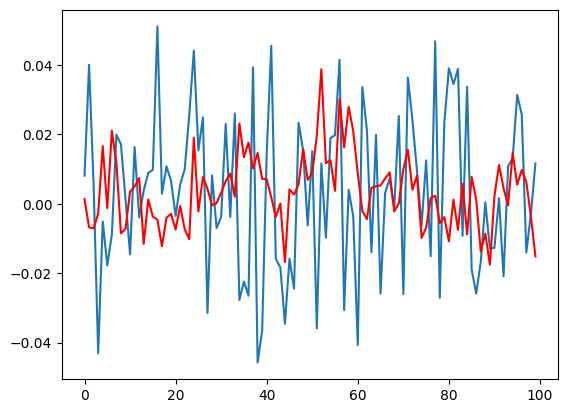

i 185 [12.31847316 15.79627745]


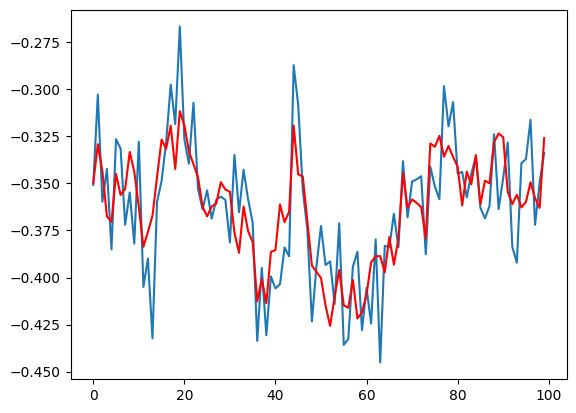

i 186 [ 8.34156216 16.50569857]


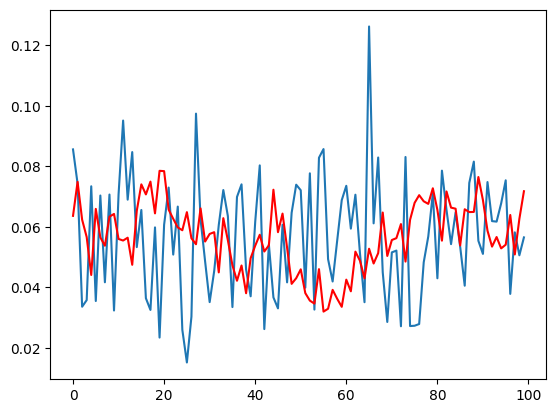

i 187 [ 4.63837352 11.32369391]


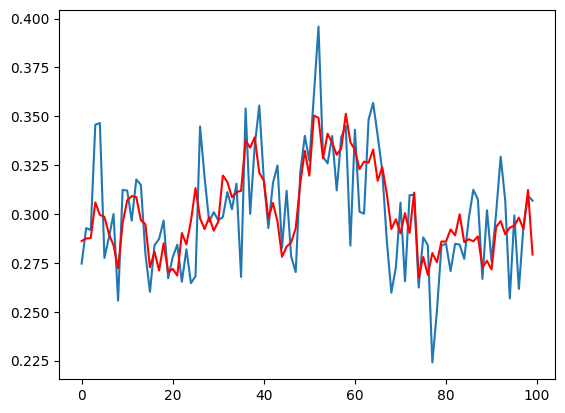

i 188 [ 5.67690865 11.19033637]


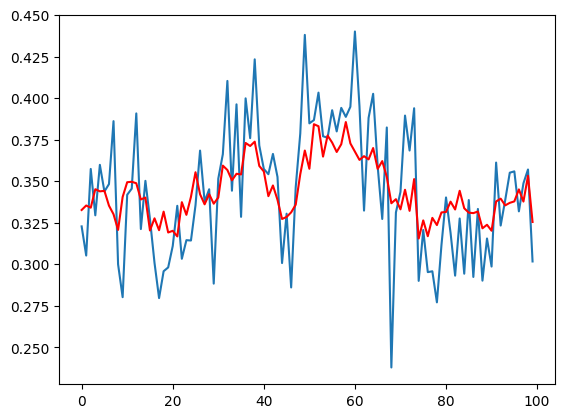

i 189 [16.5568798  16.36950595]


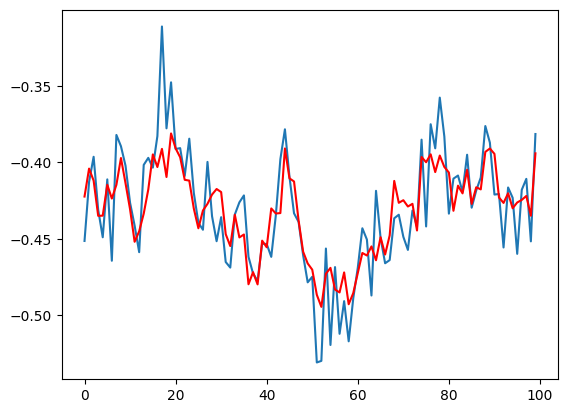

i 190 [ 1.53988281 11.18488371]


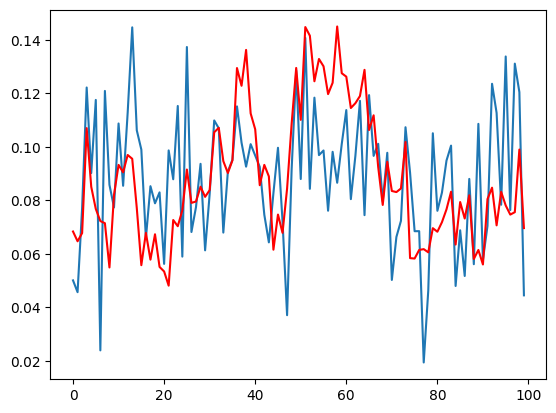

i 191 [17.72518882 19.55534569]


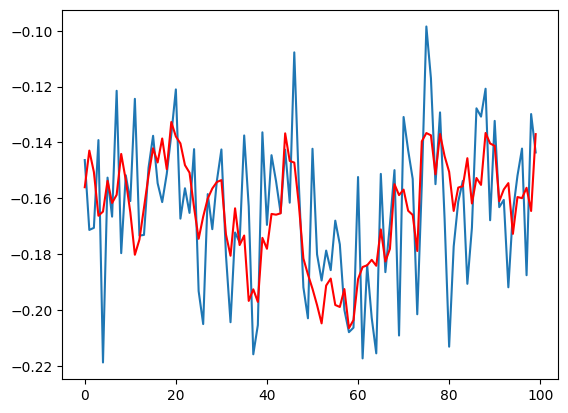

i 192 [18.20771036  1.5469949 ]


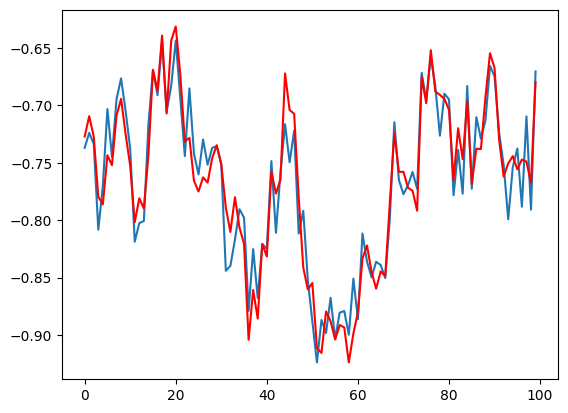

i 193 [8.61815951 8.93645168]


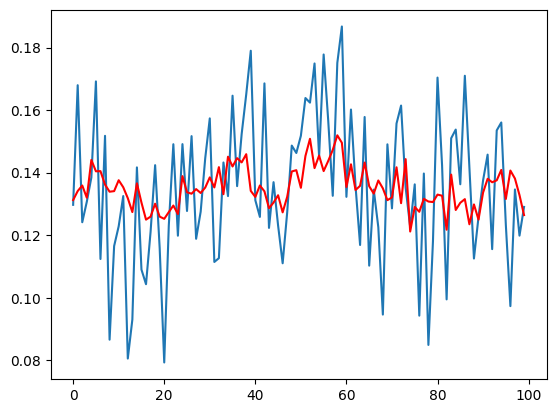

i 194 [10.35159478  9.23381564]


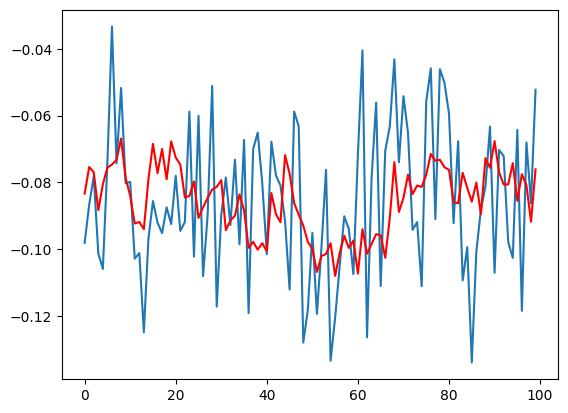

i 195 [ 7.49797039 24.55700069]


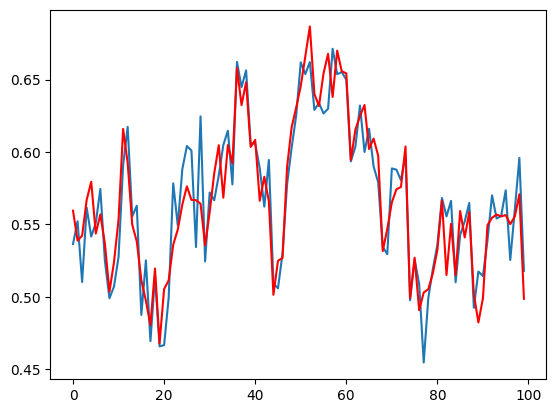

i 196 [16.71299992  2.32284121]


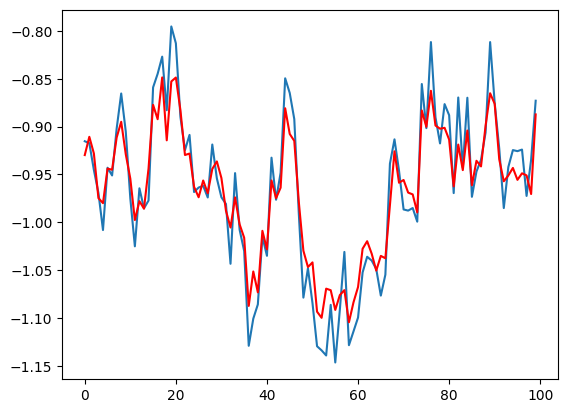

i 197 [12.90558378 14.07339077]


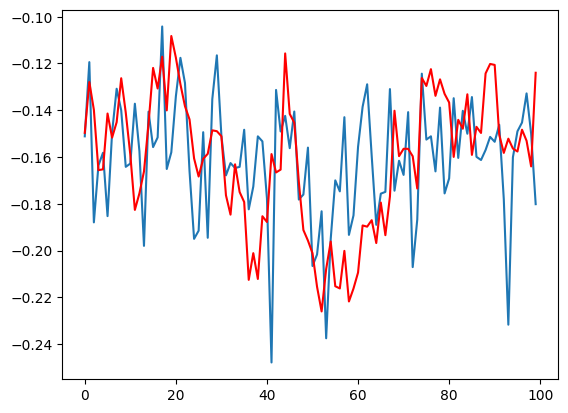

i 198 [15.67983235 16.74456243]


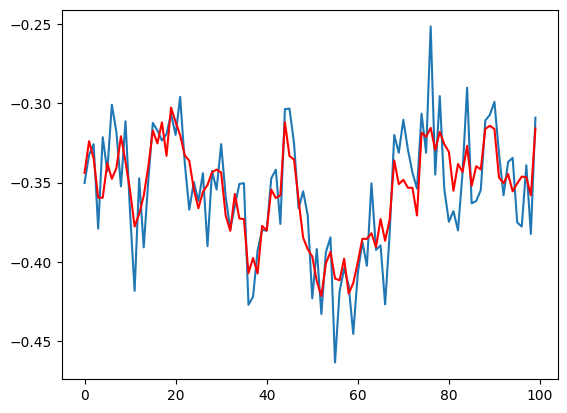

i 199 [5.64960886 0.56144989]


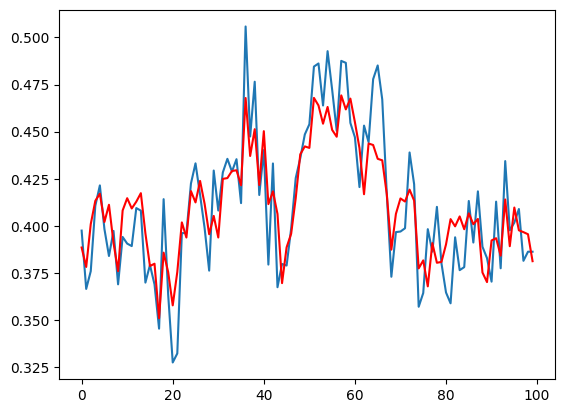

In [46]:
for i in range(size):
    print('i',i, sample_points[i])
    plt.plot(true[:,i])
    plt.plot(recon[:,i],'r')
    plt.show()

i:  0 true:  0.3437806512415915 recon:  0.3630128721964917


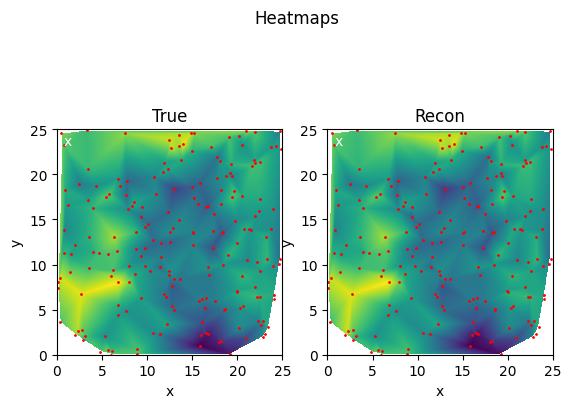

i:  1 true:  0.35171423548400677 recon:  0.35389393449540557


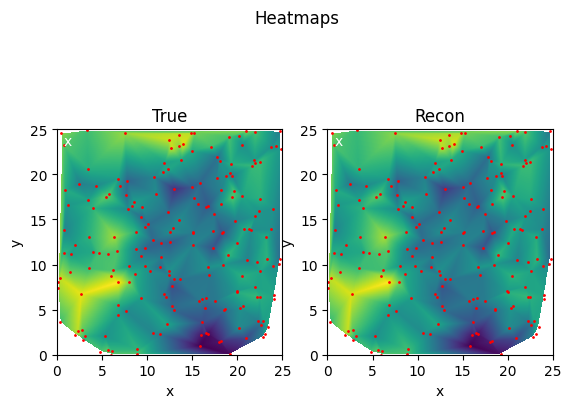

i:  2 true:  0.39666523706261914 recon:  0.36778569654932447


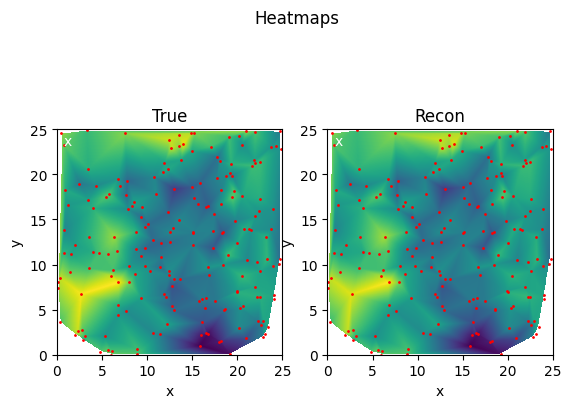

i:  3 true:  0.3399954179875286 recon:  0.38181948676477934


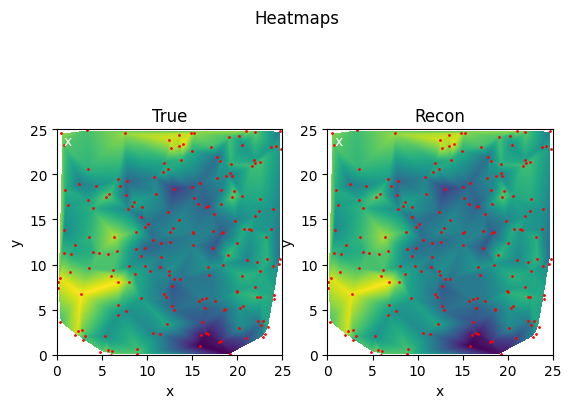

i:  4 true:  0.4026805083733995 recon:  0.39942419393578865


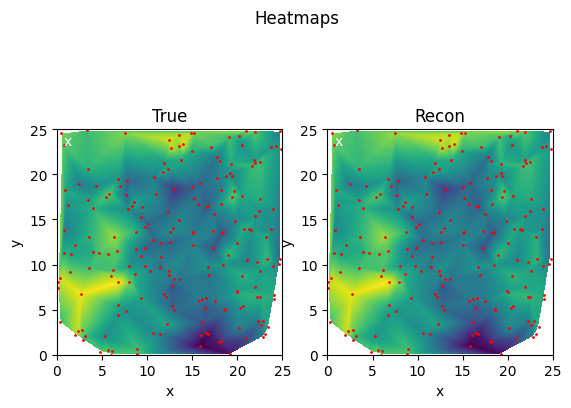

i:  5 true:  0.35001009927486726 recon:  0.3628447897711103


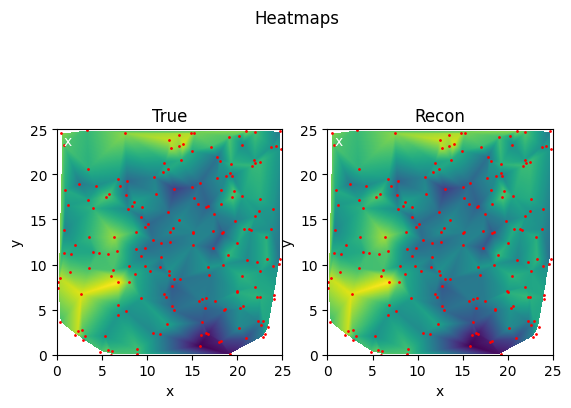

i:  6 true:  0.36945324635324794 recon:  0.3775045880974905


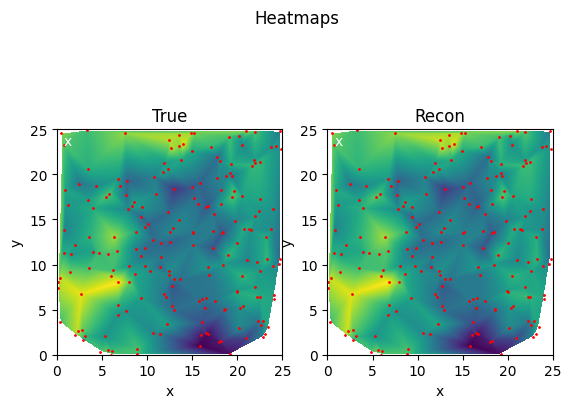

i:  7 true:  0.35074022304135494 recon:  0.37637333315906896


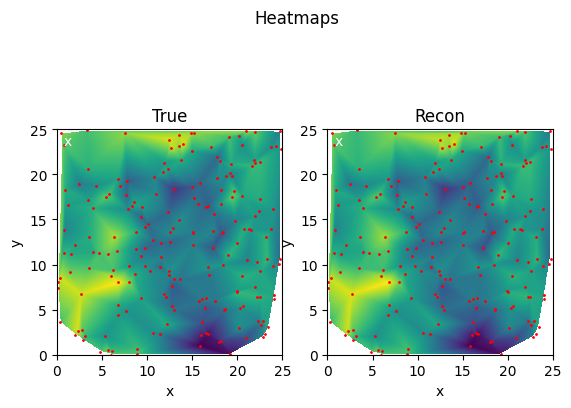

i:  8 true:  0.38652278042812016 recon:  0.3567267508133811


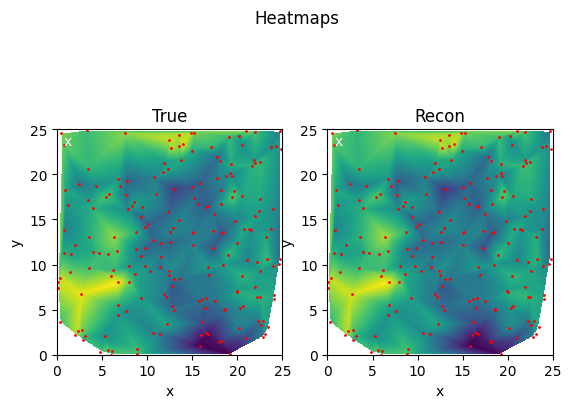

i:  9 true:  0.3069899331698494 recon:  0.34925380006136514


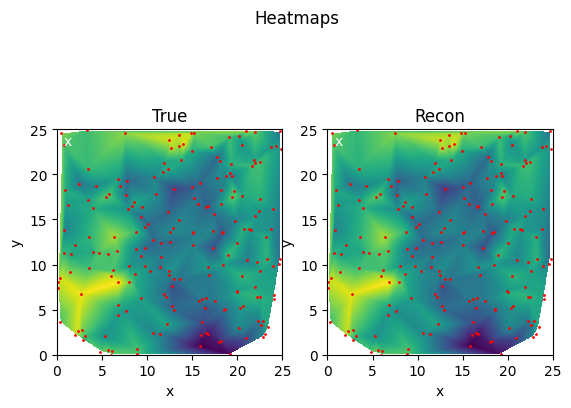

i:  10 true:  0.35374523322149676 recon:  0.3648022475828247


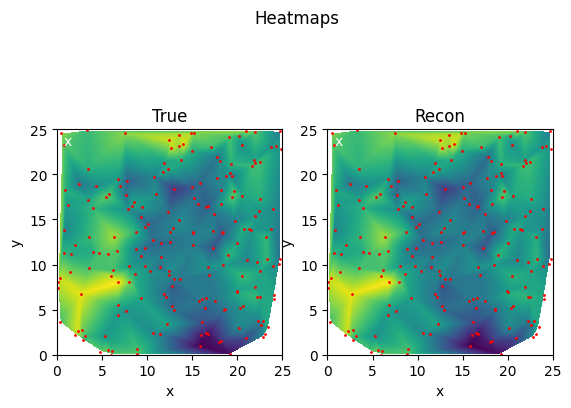

i:  11 true:  0.3867176459227501 recon:  0.3807402272249262


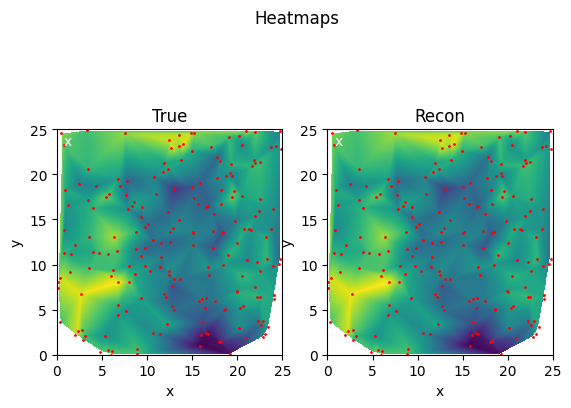

i:  12 true:  0.3698546502772079 recon:  0.3778454306694414


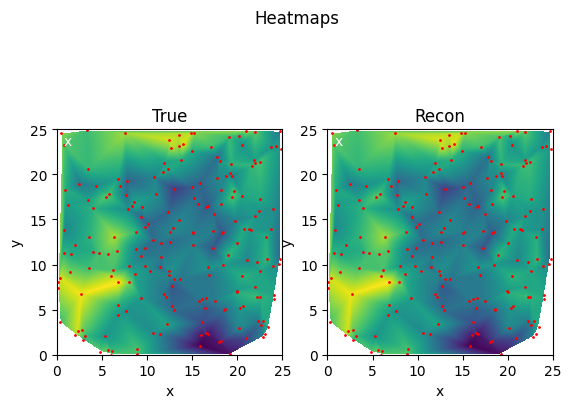

i:  13 true:  0.41941786229194383 recon:  0.3748185794841796


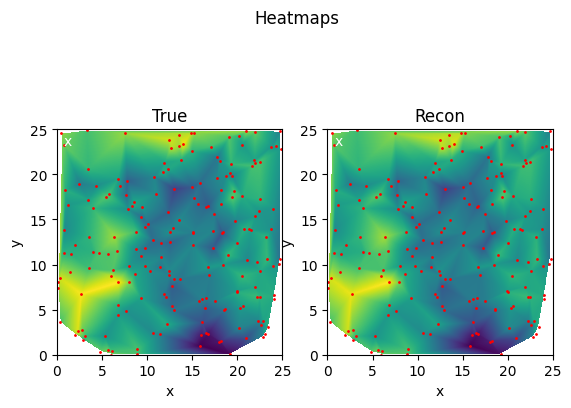

i:  14 true:  0.34352895782629667 recon:  0.3638736136803343


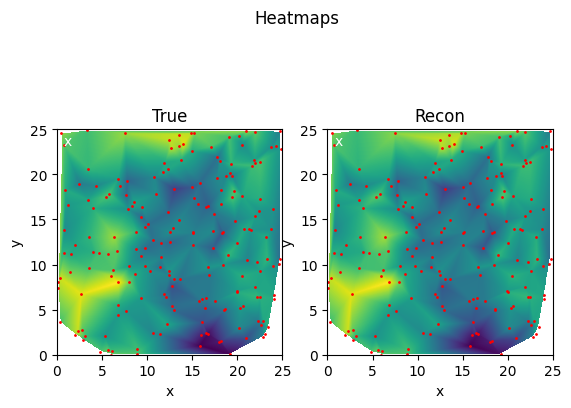

i:  15 true:  0.30970139465084895 recon:  0.35170161964754343


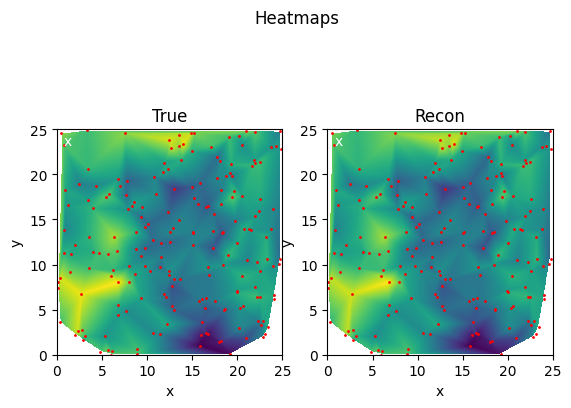

i:  16 true:  0.34645030997708376 recon:  0.31885180059487506


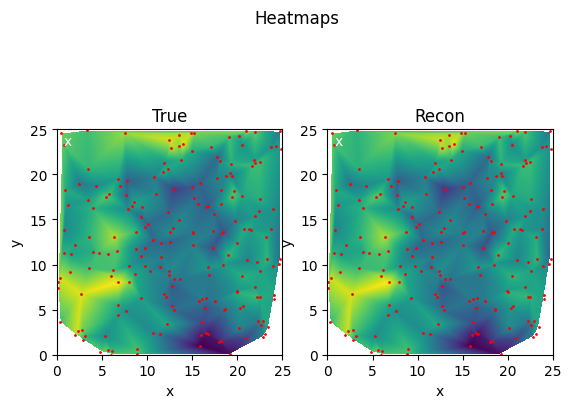

i:  17 true:  0.3310840599225524 recon:  0.32520280381308075


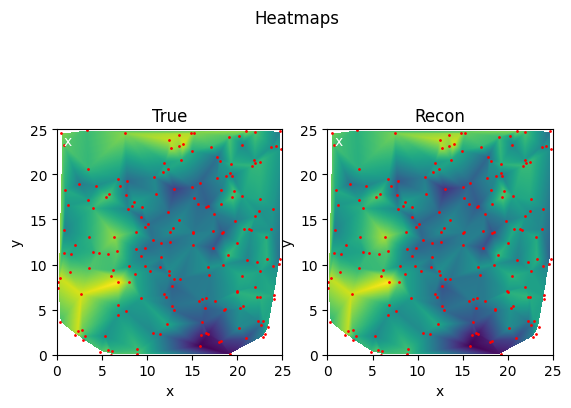

i:  18 true:  0.3570397540263734 recon:  0.3434502972141275


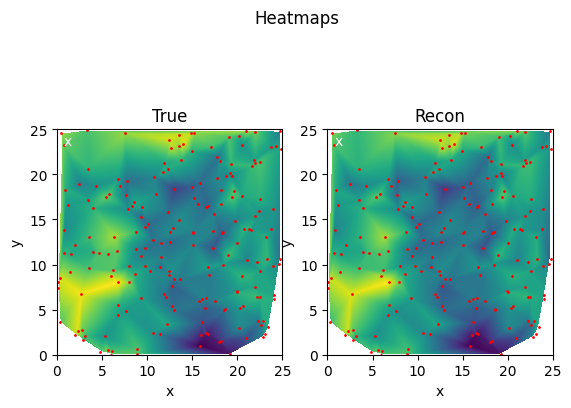

i:  19 true:  0.28841974539760185 recon:  0.3300764626389872


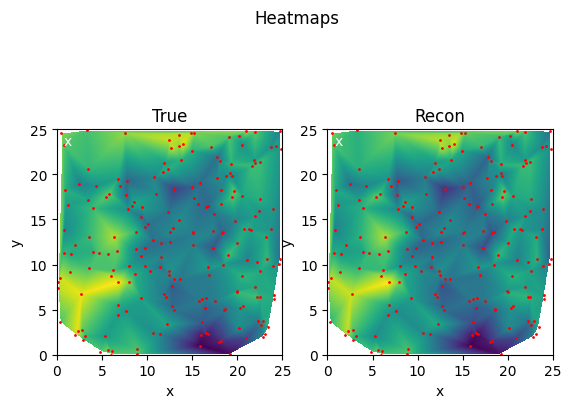

i:  20 true:  0.31208320651006055 recon:  0.3235350110650164


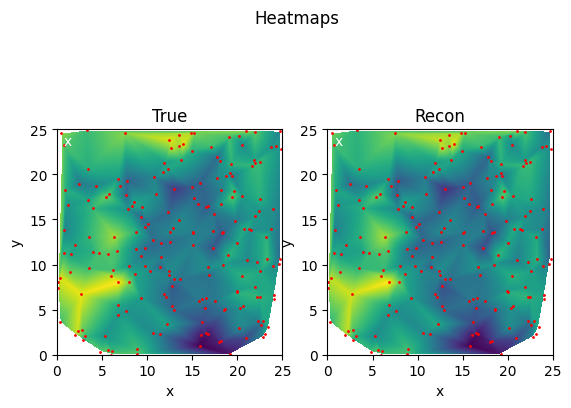

i:  21 true:  0.32600099056175075 recon:  0.35146436101404355


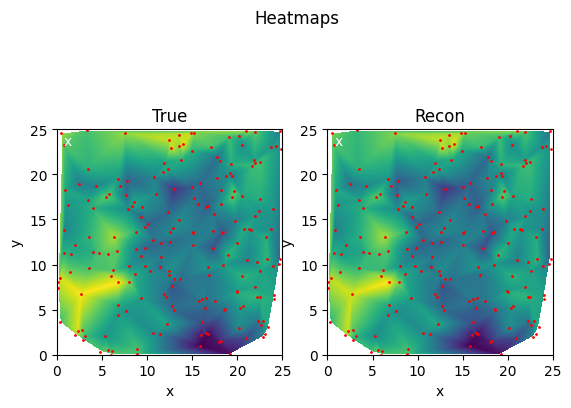

i:  22 true:  0.38843430497125175 recon:  0.37056160952120953


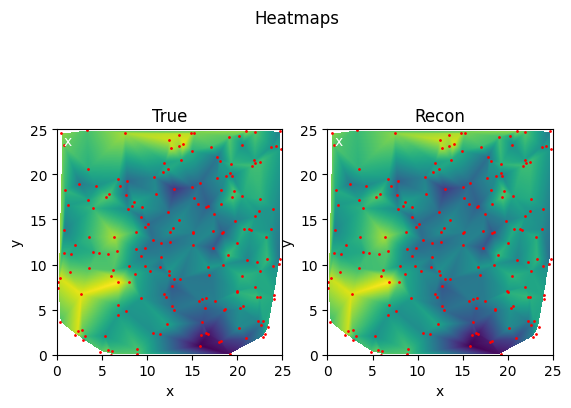

i:  23 true:  0.38751453078750303 recon:  0.3653484100349815


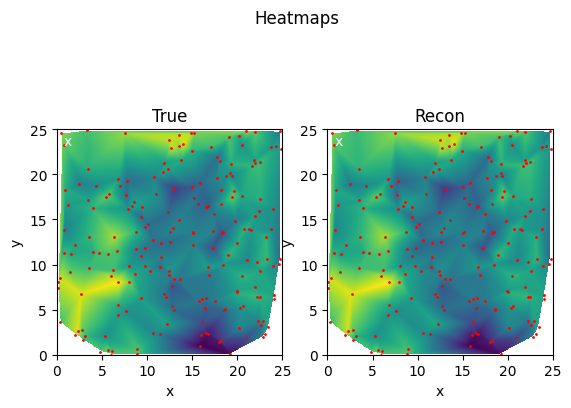

i:  24 true:  0.38921033078644535 recon:  0.34867310574116067


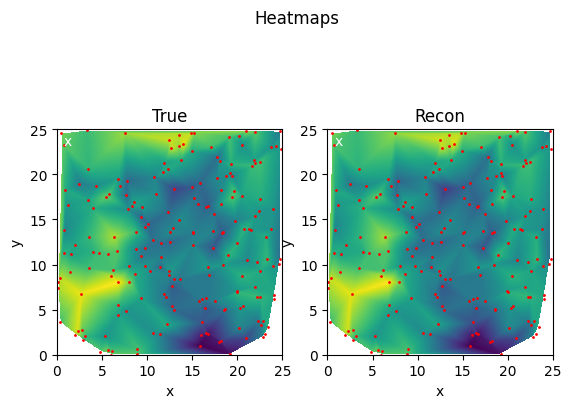

i:  25 true:  0.3538581639835939 recon:  0.3599131992921438


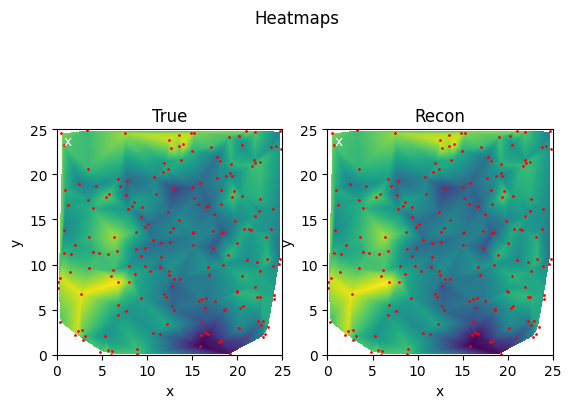

i:  26 true:  0.38600184782561664 recon:  0.3750319370360959


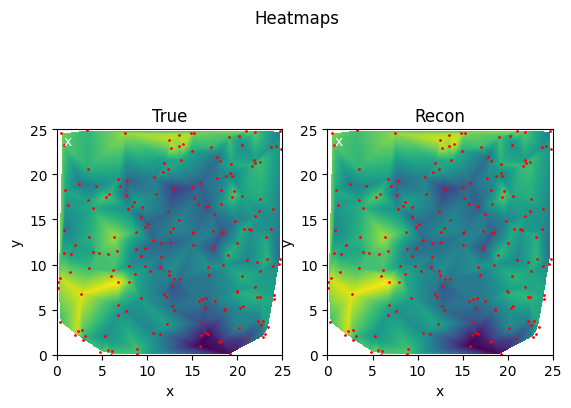

i:  27 true:  0.4225358006541063 recon:  0.3827018803685374


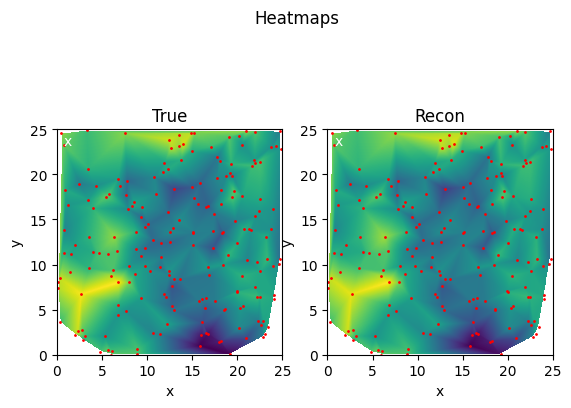

i:  28 true:  0.3462418722142403 recon:  0.3717743090802702


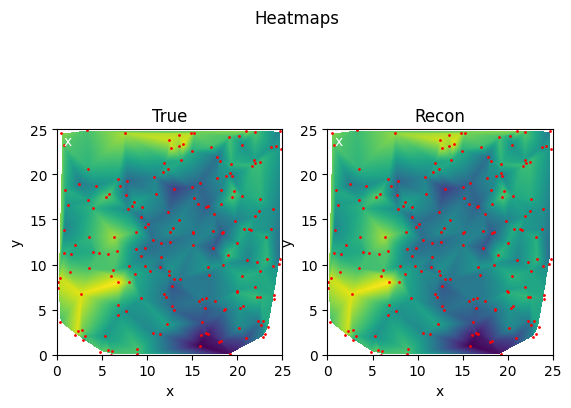

i:  29 true:  0.3732698658126374 recon:  0.3713745576358161


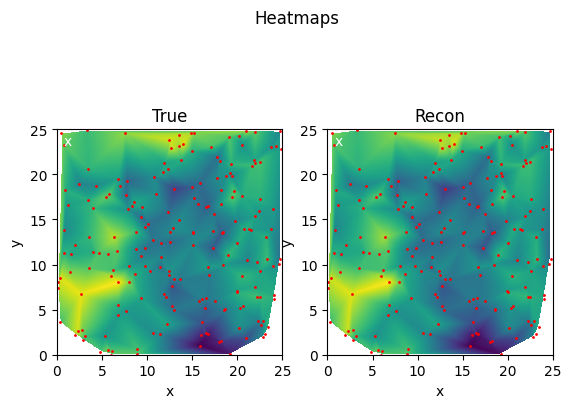

i:  30 true:  0.3831844095759414 recon:  0.3596904347273079


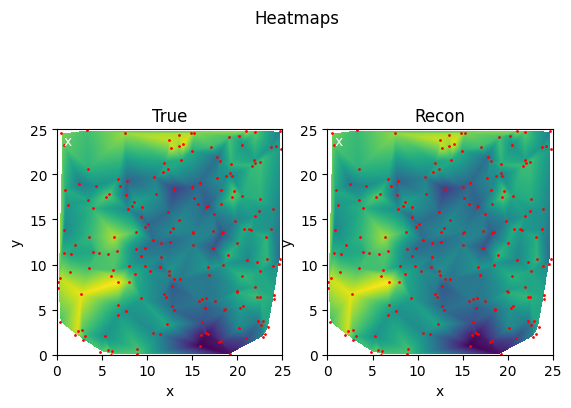

i:  31 true:  0.4074813555395859 recon:  0.3851088919800876


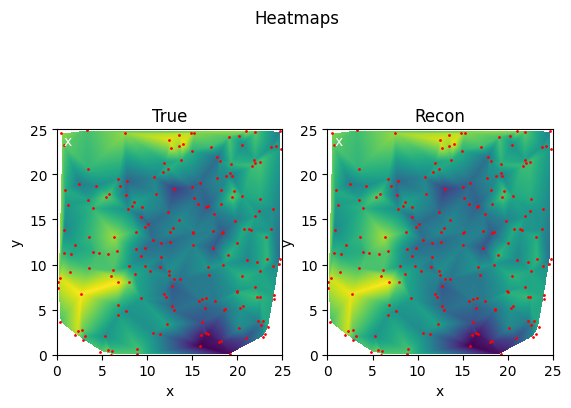

i:  32 true:  0.39714794573165146 recon:  0.4073590653799462


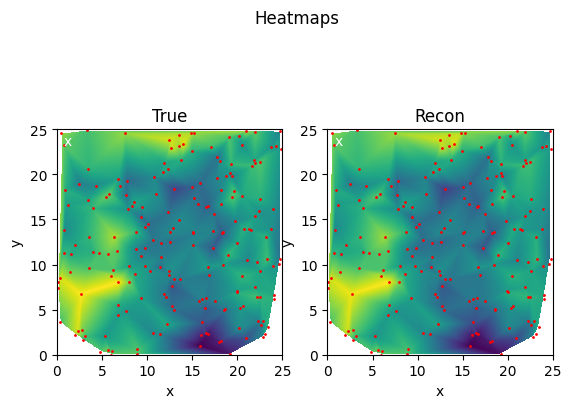

i:  33 true:  0.36004989133224263 recon:  0.3686016052456822


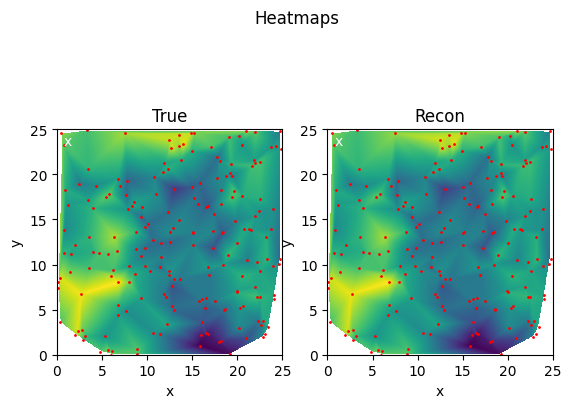

i:  34 true:  0.3715490516450443 recon:  0.3812303380246489


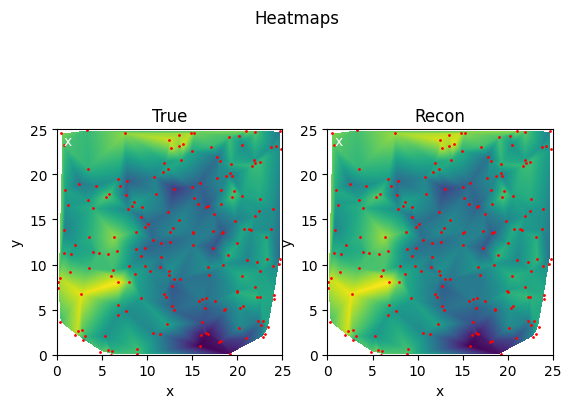

i:  35 true:  0.35901209231298986 recon:  0.38400316646455235


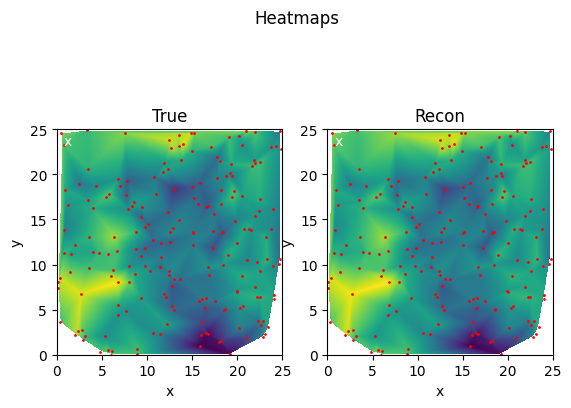

i:  36 true:  0.4186451891229595 recon:  0.42677372374329897


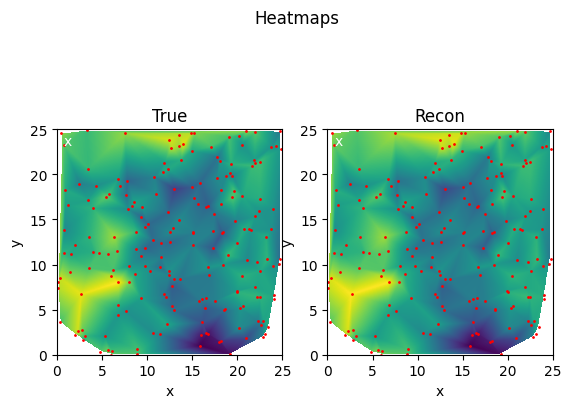

i:  37 true:  0.3841354041422712 recon:  0.4162678098516423


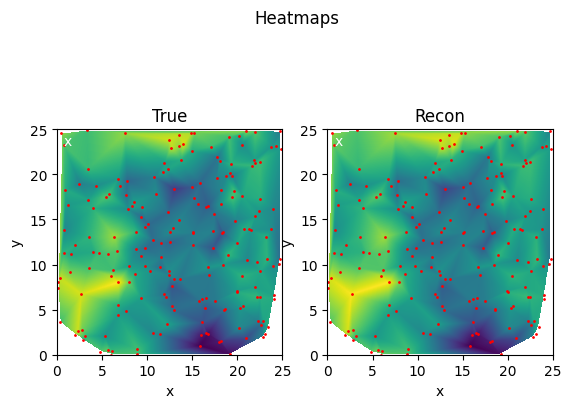

i:  38 true:  0.41896239944695335 recon:  0.42394267736065666


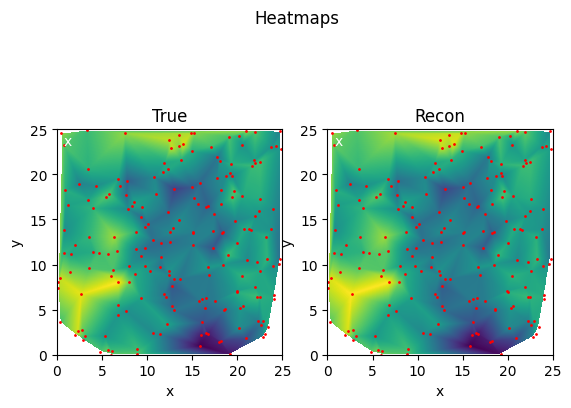

i:  39 true:  0.42594468858689866 recon:  0.3987128966015471


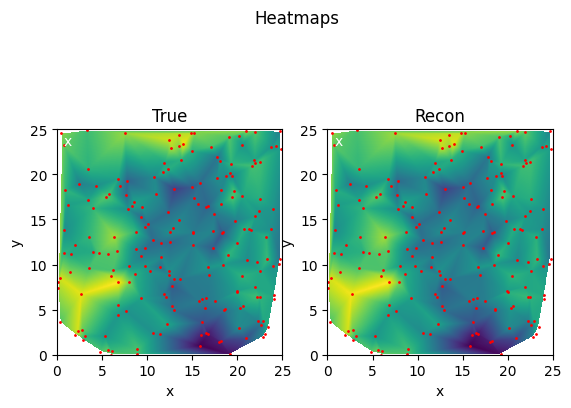

i:  40 true:  0.415466355243871 recon:  0.3931270479482576


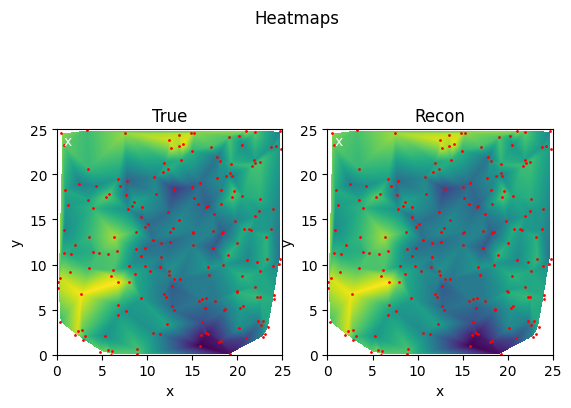

i:  41 true:  0.37741369461193847 recon:  0.3661358885141897


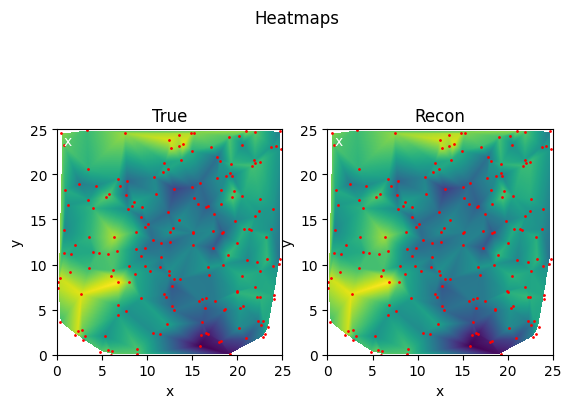

i:  42 true:  0.3762527265301607 recon:  0.38982346169896803


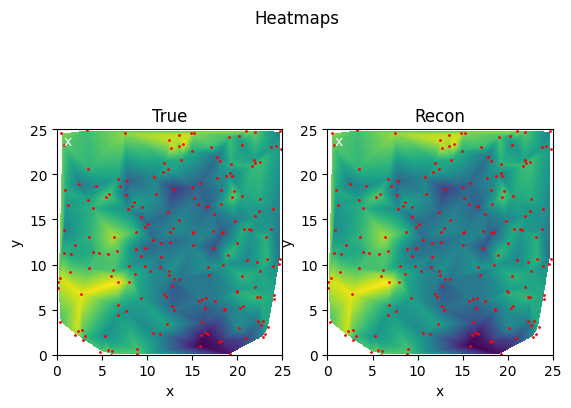

i:  43 true:  0.4035225021154614 recon:  0.37012290578455426


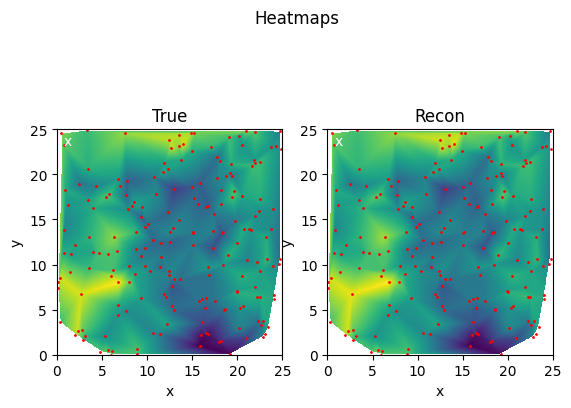

i:  44 true:  0.32008244940205716 recon:  0.34052214478623777


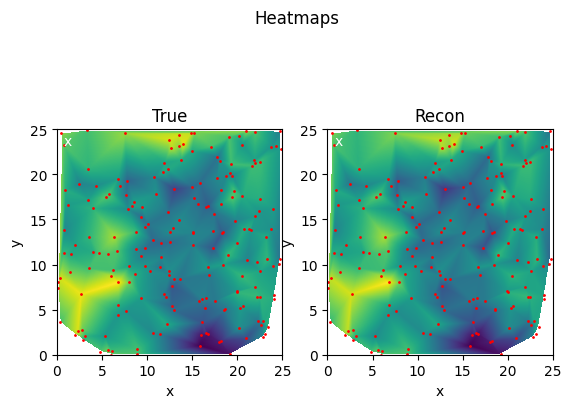

i:  45 true:  0.34261632916554435 recon:  0.35322683748273187


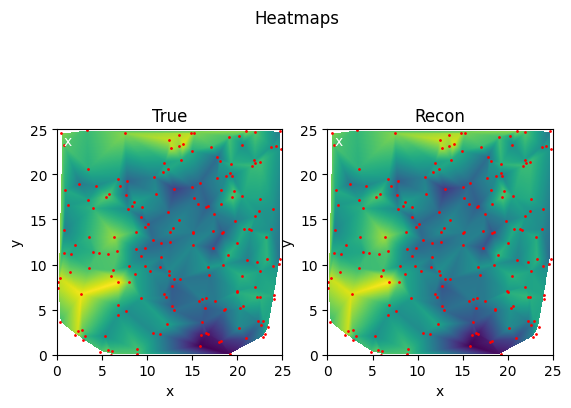

i:  46 true:  0.3279081235420131 recon:  0.3570457073789147


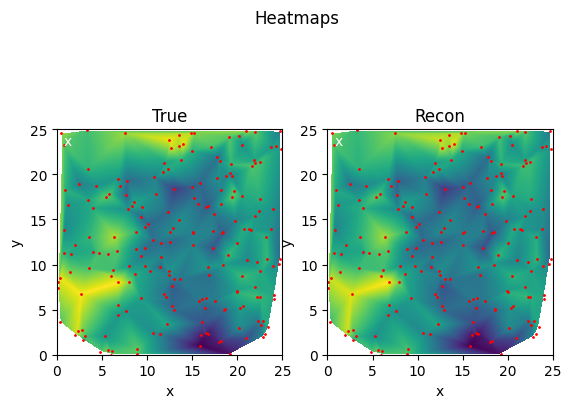

i:  47 true:  0.3532632213262182 recon:  0.38830030972461566


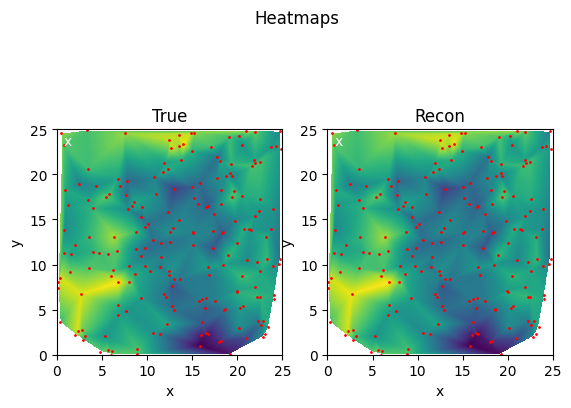

i:  48 true:  0.4445372738687892 recon:  0.3989911021674105


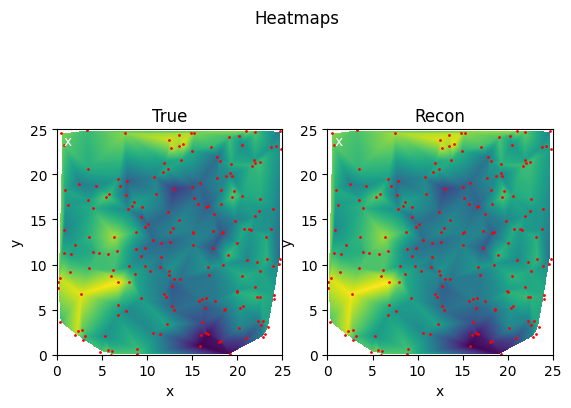

i:  49 true:  0.40253105584774607 recon:  0.413684671027149


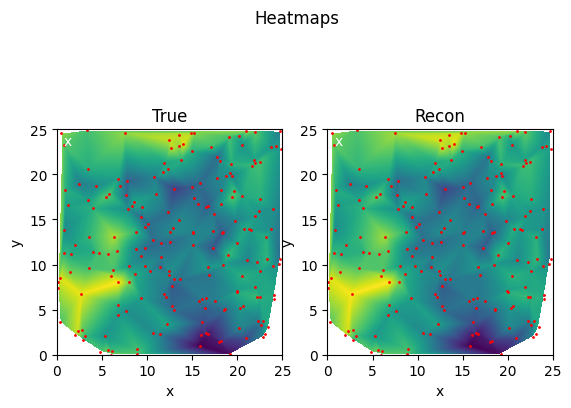

i:  50 true:  0.4125302451431201 recon:  0.4074417954220768


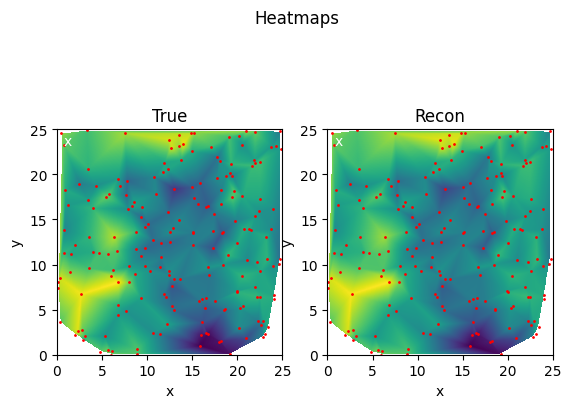

i:  51 true:  0.43040592021177804 recon:  0.4176167292627563


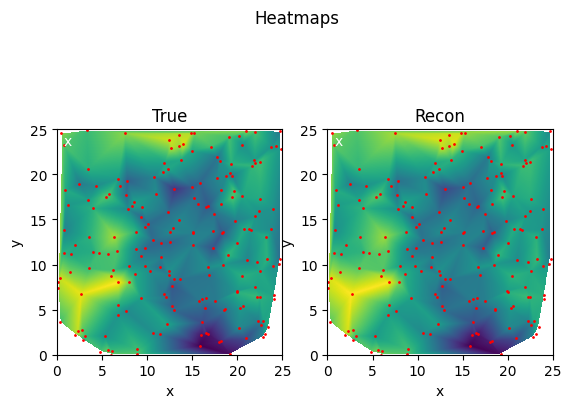

i:  52 true:  0.44362559125551954 recon:  0.428889136284707


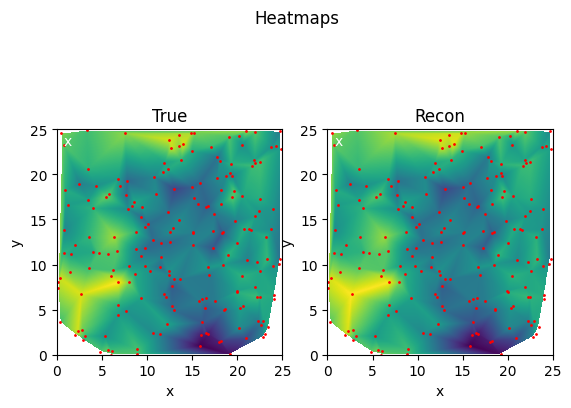

i:  53 true:  0.4691222212826777 recon:  0.4352857484132109


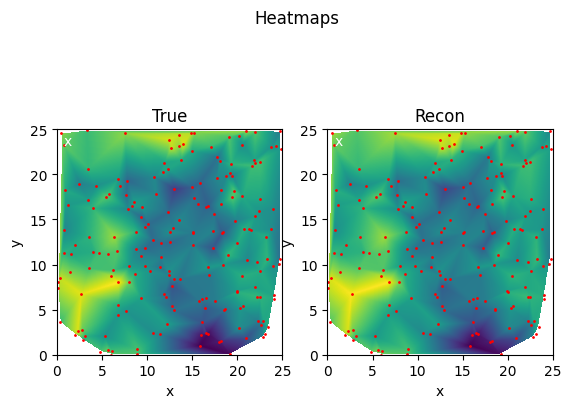

i:  54 true:  0.4186134252639795 recon:  0.41242212032702835


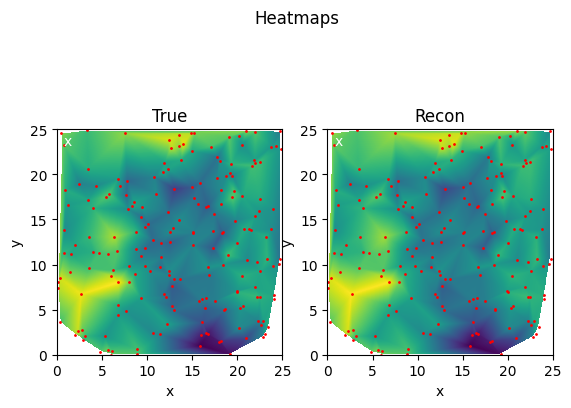

i:  55 true:  0.4989276329668837 recon:  0.4349905646068175


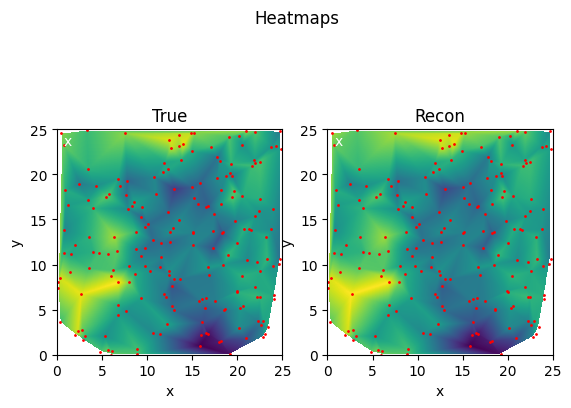

i:  56 true:  0.4190029264797048 recon:  0.4345833286938672


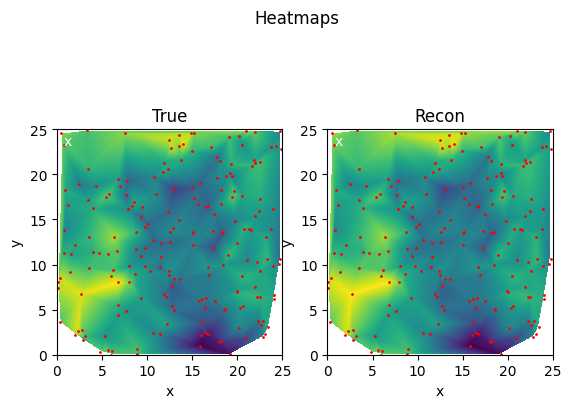

i:  57 true:  0.427255097657983 recon:  0.423694676492024


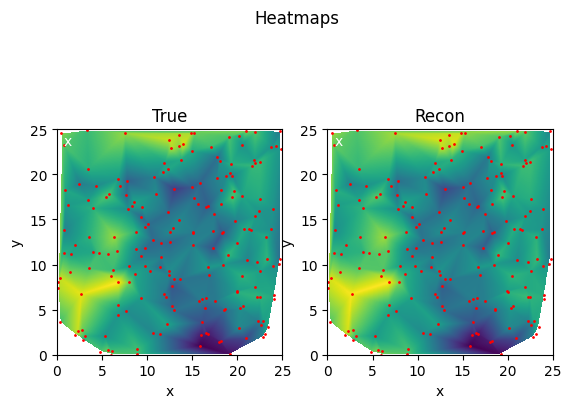

i:  58 true:  0.40938876677281927 recon:  0.414123080978557


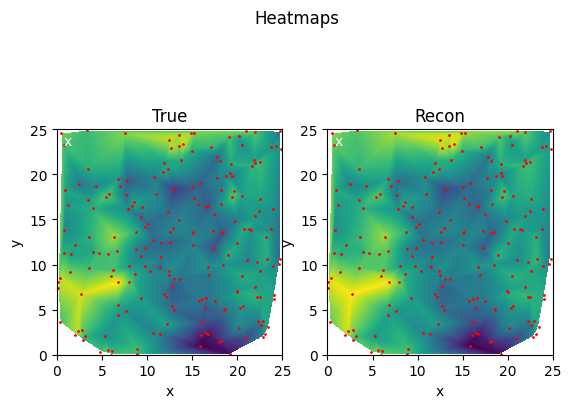

i:  59 true:  0.45117914656098 recon:  0.4158135886175294


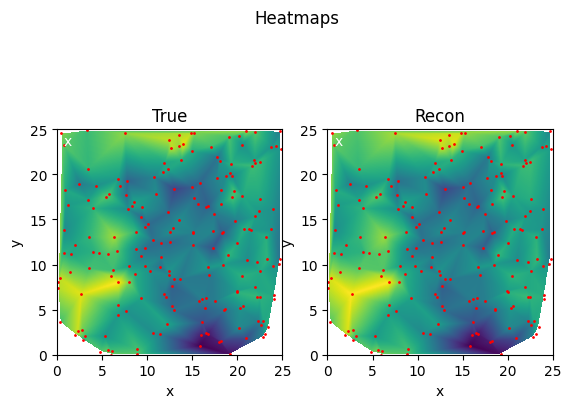

In [47]:
# Create Meshgrid
loc=0
checkpoint = sample_points[loc]

x1 = np.linspace(0, 25, 1000)
X, Y = np.meshgrid(x1, x1)
lims = [x1.min(), x1.max(), x1.min(), x1.max()]

for i in range(0, 60):
    print('i: ', i, 'true: ', true[i,loc], 'recon: ', recon[i, loc])
    
    ndpol_true = interpolate.LinearNDInterpolator(sample_points, true[i])
    ndpol_recon = interpolate.LinearNDInterpolator(sample_points, recon[i])
    
    V_true = ndpol_true(list(zip(X.ravel(), Y.ravel()))).reshape(X.shape)
    V_recon = ndpol_recon(list(zip(X.ravel(), Y.ravel()))).reshape(X.shape)
    
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.suptitle('Heatmaps')
    ax1.imshow(V_true, extent=lims, origin='lower')
    ax1.axes.set_title('True')
    ax1.axes.set_xlabel('x')
    ax1.axes.set_ylabel('y')
    ax1.axes.set_aspect('equal')
    ax1.annotate('x', xy=checkpoint, xycoords='data', color='w')
    ax1.scatter(sample_points[:,0], sample_points[:,1], s=1, c='red', marker='o')
    
    ax2.imshow(V_recon, extent=lims, origin='lower')
    ax2.axes.set_title('Recon')
    ax2.axes.set_xlabel('x')
    ax2.axes.set_ylabel('y')
    ax2.axes.set_aspect('equal')
    ax2.annotate('x', xy=checkpoint, xycoords='data', color='w')
    ax2.scatter(sample_points[:,0], sample_points[:,1], s=1, c='red', marker='o')
    
    plt.show()